In [1]:
import warnings
import os
import requests
import tarfile
import zipfile
from tqdm import tqdm
import torch
import cv2
import torch_directml
import torchvision
import pandas as pd
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torch import nn, optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import ToTensor
from sklearn.metrics import accuracy_score
from torchvision.datasets import VisionDataset
from torchvision.io import read_image
from torchvision.utils import make_grid
from torch.optim.lr_scheduler import StepLR
from PIL import Image
from torch.optim.lr_scheduler import ReduceLROnPlateau

In [2]:
import sys
print(sys.executable)

import torch_directml
device = torch_directml.device()
print("DirectML device:", device)


C:\Users\Mike\anaconda3\envs\MedicalSGMN\python.exe
DirectML device: privateuseone:0


In [3]:
# Suppress DeprecationWarnings from tarfile
warnings.filterwarnings("ignore", category=DeprecationWarning)



# Set working directory
working_dir = 'C:/Kvasir'
os.makedirs(working_dir, exist_ok=True)
os.chdir(working_dir)

# Updated dataset URL
dataset_url = "https://datasets.simula.no/downloads/kvasir-instrument.zip"
dataset_zip = os.path.join(working_dir, "kvasir-instrument.zip")
dataset_dir = os.path.join(working_dir, "kvasir-instrument")

In [4]:
# Function to download the dataset with error checking
def download_dataset(url, save_path):
    if not os.path.exists(save_path):
        print("Downloading dataset...")
        response = requests.get(url, stream=True)
        total_size = int(response.headers.get('content-length', 0))
        if response.status_code == 200:
            with open(save_path, "wb") as f, tqdm(
                desc="Downloading " + os.path.basename(save_path),
                total=total_size,
                unit='iB',
                unit_scale=True,
                unit_divisor=1024,
            ) as bar:
                for chunk in response.iter_content(chunk_size=8192):
                    if chunk:
                        f.write(chunk)
                        bar.update(len(chunk))
        else:
            raise Exception(f"Failed to download file: status code {response.status_code}")

In [5]:
# Download the dataset
try:
    download_dataset(dataset_url, dataset_zip)
except Exception as e:
    print(str(e))
    print("Please check the dataset URL or your internet connection.")
    exit(1)

# Extract the dataset
if not os.path.exists(dataset_dir):
    try:
        with zipfile.ZipFile(dataset_zip, "r") as zip_ref:
            print("Extracting dataset zip file...")
            zip_ref.extractall(working_dir)
    except zipfile.BadZipFile:
        print("Error: The downloaded file is not a valid zip file.")
        print("Deleting corrupted file and retrying...")
        os.remove(dataset_zip)
        raise

print("Dataset ready!")

Dataset ready!


In [6]:
# Extract images and masks tar files
images_tar = os.path.join(dataset_dir, 'images.tar.gz')
masks_tar = os.path.join(dataset_dir, 'masks.tar.gz')

if os.path.exists(images_tar):
    print("Extracting images tar file...")
    with tarfile.open(images_tar, "r:gz") as tar:
        tar.extractall(path=os.path.join(dataset_dir, 'images'))

if os.path.exists(masks_tar):
    print("Extracting masks tar file...")
    with tarfile.open(masks_tar, "r:gz") as tar:
        tar.extractall(path=os.path.join(dataset_dir, 'masks'))

print("Extraction complete.")

Extracting images tar file...
Extracting masks tar file...
Extraction complete.


In [7]:
# Dataset directories
images_dir = os.path.join(dataset_dir, 'images', 'images')
masks_dir = os.path.join(dataset_dir, 'masks', 'masks')

# Option to use provided splits or custom split
use_provided_splits = True  # Set to False to use custom split

if use_provided_splits:
    # Paths to the dataset files
    train_txt_path = os.path.join(dataset_dir, 'train.txt')
    test_txt_path = os.path.join(dataset_dir, 'test.txt')

    # Read train and test splits
    with open(train_txt_path, 'r') as f:
        train_files = f.read().splitlines()
    with open(test_txt_path, 'r') as f:
        test_files = f.read().splitlines()

    # Construct file paths
    train_images_list = [os.path.join(images_dir, f"{img_id}.jpg") for img_id in train_files]
    train_masks_list = [os.path.join(masks_dir, f"{img_id}.png") for img_id in train_files]
    test_images_list = [os.path.join(images_dir, f"{img_id}.jpg") for img_id in test_files]
    test_masks_list = [os.path.join(masks_dir, f"{img_id}.png") for img_id in test_files]

else:
    # Custom train/test split
    # Adjust train_ratio to change the size of the training data
    train_ratio = 0.7  # 70% for training, adjust as needed

    # Get all image and mask filenames
    all_images = sorted(os.listdir(images_dir))
    all_masks = sorted(os.listdir(masks_dir))

    # Ensure the number of images and masks are equal
    assert len(all_images) == len(all_masks), "Mismatch in number of images and masks"

    # Create the custom split
    total_samples = len(all_images)
    train_size = int(train_ratio * total_samples)
    train_images_list = [os.path.join(images_dir, img) for img in all_images[:train_size]]
    train_masks_list = [os.path.join(masks_dir, mask) for mask in all_masks[:train_size]]
    test_images_list = [os.path.join(images_dir, img) for img in all_images[train_size:]]
    test_masks_list = [os.path.join(masks_dir, mask) for mask in all_masks[train_size:]]

In [8]:
# Verify that images and masks are correctly paired
print("Sample image and mask paths:")
for img_path, mask_path in zip(train_images_list[:3], train_masks_list[:3]):
    print(f"Image: {img_path}, Mask: {mask_path}")

# Dataset class
class KvasirInstrumentDataset(Dataset):
    def __init__(self, images_list, masks_list, augmentations=None):
        self.images_list = images_list
        self.masks_list = masks_list
        self.augmentations = augmentations

    def __len__(self):
        return len(self.images_list)

    def __getitem__(self, idx):
        image_path = self.images_list[idx]
        mask_path = self.masks_list[idx]

        image = cv2.imread(image_path)
        if image is None:
            raise ValueError(f"Image not found: {image_path}")

        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if mask is None:
            raise ValueError(f"Mask not found: {mask_path}")

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = (mask > 0).astype(np.float32)

        if self.augmentations:
            augmented = self.augmentations(image=image, mask=mask)
            image = augmented['image']
            mask = augmented['mask']
        else:
            transform = A.Compose([A.Resize(256, 256), A.Normalize(), ToTensorV2()])
            transformed = transform(image=image, mask=mask)
            image = transformed['image']
            mask = transformed['mask']

        # Ensure mask has shape [1, H, W]
        if mask.ndim == 2:
            mask = mask.unsqueeze(0)
        elif mask.ndim == 3 and mask.shape[0] != 1:
            mask = mask.unsqueeze(0)

        return image, mask

Sample image and mask paths:
Image: C:/Kvasir\kvasir-instrument\images\images\ckcvw5yhd000m3b5yutirmiad.jpg, Mask: C:/Kvasir\kvasir-instrument\masks\masks\ckcvw5yhd000m3b5yutirmiad.png
Image: C:/Kvasir\kvasir-instrument\images\images\ckcvwpanj001b3b5ysxixpcxy.jpg, Mask: C:/Kvasir\kvasir-instrument\masks\masks\ckcvwpanj001b3b5ysxixpcxy.png
Image: C:/Kvasir\kvasir-instrument\images\images\ckcuhbkeo000z3b5yq7v1sm0o.jpg, Mask: C:/Kvasir\kvasir-instrument\masks\masks\ckcuhbkeo000z3b5yq7v1sm0o.png


In [9]:

# Define UNet model (same as before)
class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, init_features=32):
        super(UNet, self).__init__()

        features = init_features
        self.encoder1 = self._block(in_channels, features)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder2 = self._block(features, features * 2)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder3 = self._block(features * 2, features * 4)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder4 = self._block(features * 4, features * 8)
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.bottleneck = self._block(features * 8, features * 16)

        self.upconv4 = nn.ConvTranspose2d(features * 16, features * 8, kernel_size=2, stride=2)
        self.decoder4 = self._block((features * 8) * 2, features * 8)
        self.upconv3 = nn.ConvTranspose2d(features * 8, features * 4, kernel_size=2, stride=2)
        self.decoder3 = self._block((features * 4) * 2, features * 4)
        self.upconv2 = nn.ConvTranspose2d(features * 4, features * 2, kernel_size=2, stride=2)
        self.decoder2 = self._block((features * 2) * 2, features * 2)
        self.upconv1 = nn.ConvTranspose2d(features * 2, features, kernel_size=2, stride=2)
        self.decoder1 = self._block(features * 2, features)

        self.conv = nn.Conv2d(features, out_channels, kernel_size=1)

    def _block(self, in_channels, features):
        return nn.Sequential(
            nn.Conv2d(in_channels, features, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(features),
            nn.ReLU(inplace=True),
            nn.Conv2d(features, features, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(features),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool1(enc1))
        enc3 = self.encoder3(self.pool2(enc2))
        enc4 = self.encoder4(self.pool3(enc3))

        bottleneck = self.bottleneck(self.pool4(enc4))

        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)
        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)
        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)
        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)
        return torch.sigmoid(self.conv(dec1))

In [10]:


# UNet++ Decoder with Nested Skip Connections
class UNetPlusPlusDecoder(nn.Module):
    def __init__(self, encoder_channels, decoder_channels, activation=nn.ReLU()):
        super(UNetPlusPlusDecoder, self).__init__()
        self.activation = activation

        # The encoder_channels are expected in the order: [layer4, layer3, layer2, layer1]
        self.conv0_0 = self.conv_block(encoder_channels[0], decoder_channels[0])
        self.conv1_0 = self.conv_block(encoder_channels[1], decoder_channels[1])
        self.conv1_1 = self.conv_block(decoder_channels[0] + decoder_channels[1], decoder_channels[1])
        self.conv2_0 = self.conv_block(encoder_channels[2], decoder_channels[2])
        self.conv2_1 = self.conv_block(decoder_channels[1] + decoder_channels[2], decoder_channels[2])
        self.conv2_2 = self.conv_block(decoder_channels[0] + decoder_channels[1] + decoder_channels[2], decoder_channels[2])

    def conv_block(self, in_channels, out_channels):
        """Creates a block of Conv2d -> BatchNorm2d -> Activation."""
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            self.activation
        )

    def upsample_to_size(self, x, target_size):
        return F.interpolate(x, size=target_size, mode='bilinear', align_corners=True)

    def forward(self, x4, x3, x2, x1):
        # x4: deepest encoder feature (e.g., ResNet layer4: 512 channels)
        # x3: ResNet layer3 (256 channels)
        # x2: ResNet layer2 (128 channels)
        # x1: ResNet layer1 (64 channels)
        x0_0 = self.conv0_0(x4)  # Process deepest feature
        x1_0 = self.conv1_0(self.upsample_to_size(x3, x2.shape[2:]))  # Upsample x3 to x2's size
        x1_1 = self.conv1_1(torch.cat([x1_0, self.upsample_to_size(x0_0, x1_0.shape[2:])], dim=1))
        x2_0 = self.conv2_0(self.upsample_to_size(x2, x1_0.shape[2:]))  # Upsample x2 to x1_0's size
        x2_1 = self.conv2_1(torch.cat([x2_0, self.upsample_to_size(x1_1, x2_0.shape[2:])], dim=1))
        x2_2 = self.conv2_2(torch.cat([
            x2_1, 
            self.upsample_to_size(x1_1, x2_1.shape[2:]), 
            self.upsample_to_size(x0_0, x2_1.shape[2:])
        ], dim=1))
        return x2_2

# UNet++ Model for Binary Segmentation
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, activation=nn.ReLU()):
        super(UNetPlusPlus, self).__init__()
        # Use a pretrained ResNet34 as the encoder
        self.encoder = torchvision.models.resnet34(pretrained=True)
        # Optionally, freeze the encoder parameters:
        # for param in self.encoder.parameters():
        #     param.requires_grad = False

        # ResNet34 produces:
        # - layer1: 64 channels
        # - layer2: 128 channels
        # - layer3: 256 channels
        # - layer4: 512 channels
        # The decoder expects encoder features in the order: [layer4, layer3, layer2, layer1]
        encoder_channels = [512, 256, 128, 64]
        # Define decoder channels (only first three are used in this decoder design)
        decoder_channels = [256, 128, 64, 32]
        self.decoder = UNetPlusPlusDecoder(encoder_channels, decoder_channels, activation)
        self.segmentation_head = nn.Conv2d(decoder_channels[2], out_channels, kernel_size=3, padding=1)

    def forward(self, x):
        # Save original input size for output interpolation
        input_size = x.shape[2:]
        
        # If needed, normalize input for ResNet (using ImageNet statistics)
        # mean = torch.tensor([0.485, 0.456, 0.406]).to(x.device).view(1,3,1,1)
        # std = torch.tensor([0.229, 0.224, 0.225]).to(x.device).view(1,3,1,1)
        # x = (x - mean) / std

        # Encoder forward pass:
        x = self.encoder.conv1(x)
        x = self.encoder.bn1(x)
        x = self.encoder.relu(x)
        x = self.encoder.maxpool(x)

        x1 = self.encoder.layer1(x)  # 64 channels
        x2 = self.encoder.layer2(x1)  # 128 channels
        x3 = self.encoder.layer3(x2)  # 256 channels
        x4 = self.encoder.layer4(x3)  # 512 channels

        # Pass features to the decoder in the order: x4, x3, x2, x1
        x = self.decoder(x4, x3, x2, x1)
        x = self.segmentation_head(x)
        # Interpolate to match the original input size dynamically
        x = F.interpolate(x, size=input_size, mode='bilinear', align_corners=True)
        return torch.sigmoid(x)


In [11]:

# Convolution block with 3x3 kernel size, Group Normalization, and ReLU activation
class Conv3x3GNReLU(nn.Module):
    def __init__(self, in_channels, out_channels, upsample=False):
        super().__init__()
        self.upsample = upsample
        self.block = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, (3, 3), stride=1, padding=1, bias=False),
            nn.GroupNorm(32, out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        x = self.block(x)
        if self.upsample:
            x = F.interpolate(x, scale_factor=2, mode="bilinear", align_corners=True)
        return x

# Feature Pyramid Network block
class FPNBlock(nn.Module):
    def __init__(self, pyramid_channels, skip_channels):
        super().__init__()
        self.skip_conv = nn.Conv2d(skip_channels, pyramid_channels, kernel_size=1, bias=False)

    def forward(self, x, skip=None):
        x = F.interpolate(x, scale_factor=2, mode="nearest")
        if skip is not None:
            skip = self.skip_conv(skip)
            skip = F.interpolate(skip, size=x.shape[2:], mode='bilinear', align_corners=True)
            x = x + skip
        return x

# Segmentation block with a series of convolutions and upsampling
class SegmentationBlock(nn.Module):
    def __init__(self, in_channels, out_channels, n_upsamples=0):
        super().__init__()
        blocks = [Conv3x3GNReLU(in_channels, out_channels, upsample=bool(n_upsamples))]

        if n_upsamples > 1:
            for _ in range(1, n_upsamples):
                blocks.append(Conv3x3GNReLU(out_channels, out_channels, upsample=True))

        self.block = nn.Sequential(*blocks)

    def forward(self, x):
        return self.block(x)

# Merge block to combine features using addition or concatenation
class MergeBlock(nn.Module):
    def __init__(self, policy='add'):
        super().__init__()
        self.policy = policy

    def forward(self, x):
        if self.policy == 'add':
            return sum(x)
        elif self.policy == 'cat':
            return torch.cat(x, dim=1)
        else:
            raise ValueError("`merge_policy` must be one of: ['add', 'cat']")

# FPN Decoder combining the feature pyramid with skip connections
class FPNDecoder(nn.Module):
    def __init__(self, encoder_channels, pyramid_channels=256, segmentation_channels=128, merge_policy='add'):
        super().__init__()

        self.p5 = nn.Conv2d(encoder_channels[0], pyramid_channels, kernel_size=1)
        self.p4 = FPNBlock(pyramid_channels, encoder_channels[1])
        self.p3 = FPNBlock(pyramid_channels, encoder_channels[2])
        self.p2 = FPNBlock(pyramid_channels, encoder_channels[3])

        self.seg_blocks = nn.ModuleList([
            SegmentationBlock(pyramid_channels, segmentation_channels, n_upsamples=n_upsamples)
            for n_upsamples in [3, 2, 1, 0]
        ])

        self.merge = MergeBlock(merge_policy)

    def forward(self, *features):
        # Reverse the features to match the FPN order
        features = features[::-1]  # Now features[0] is the deepest (layer4)
        p5 = self.p5(features[0])
        p4 = self.p4(p5, features[1])
        p3 = self.p3(p4, features[2])
        p2 = self.p2(p3, features[3])

        feature_pyramid = [seg_block(p) for seg_block, p in zip(self.seg_blocks, [p5, p4, p3, p2])]
        x = self.merge(feature_pyramid)

        return x

# FPN main class
class FPN(nn.Module):
    def __init__(self, encoder_name='resnet34', in_channels=3, decoder_pyramid_channels=256, segmentation_channels=128, out_channels=1, activation_fn=nn.ReLU(), pretrained=True):
        super(FPN, self).__init__()

        if encoder_name not in ['resnet34', 'resnet50']:
            raise ValueError(f"Encoder {encoder_name} is not supported")

        if encoder_name == 'resnet34':
            self.encoder = torchvision.models.resnet34(pretrained=pretrained)
            # For ResNet34, expected encoder feature channels (from later layers):
            # layer4: 512, layer3: 256, layer2: 128, layer1: 64
            encoder_channels = [512, 256, 128, 64]
        elif encoder_name == 'resnet50':
            self.encoder = torchvision.models.resnet50(pretrained=pretrained)
            # For ResNet50:
            encoder_channels = [2048, 1024, 512, 256]

        if in_channels != 3:
            self.encoder.conv1 = nn.Conv2d(in_channels, 64, kernel_size=7, stride=2, padding=3, bias=False)

        self.decoder = FPNDecoder(encoder_channels, pyramid_channels=decoder_pyramid_channels, segmentation_channels=segmentation_channels, merge_policy='add')
        self.segmentation_head = nn.Conv2d(segmentation_channels, out_channels, kernel_size=1)

    def forward(self, x):
        input_size = x.shape[2:]
        features = []
        # Run the encoder and collect features
        # Initial layers: conv1 -> bn1 -> relu -> maxpool
        x = self.encoder.conv1(x)
        x = self.encoder.bn1(x)
        x = self.encoder.relu(x)
        x = self.encoder.maxpool(x)
        # Now collect features from layers 1 to 4
        x1 = self.encoder.layer1(x)  # 64 channels
        x2 = self.encoder.layer2(x1)  # 128 channels
        x3 = self.encoder.layer3(x2)  # 256 channels
        x4 = self.encoder.layer4(x3)  # 512 channels (or 2048 for ResNet50)

        # Assemble features in the order [layer4, layer3, layer2, layer1]
        features = [x1, x2, x3, x4]

        # Pass the features through the FPN decoder
        x = self.decoder(*features)
        # Pass the result through the segmentation head
        x = self.segmentation_head(x)
        # Dynamically upscale to the original input size
        x = F.interpolate(x, size=input_size, mode='bilinear', align_corners=True)
        return torch.sigmoid(x)


In [12]:
# Define augmentations
augmentations = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.GaussNoise(p=0.2),
    A.Resize(256, 256),
    A.Normalize(),
    ToTensorV2()
])

# No augmentations (only resize, normalize, and convert to tensor)
no_augmentations = A.Compose([
    A.Resize(256, 256),
    A.Normalize(),
    ToTensorV2()
])

# Training process functions (same as before)
def compute_metrics(preds, targets, smooth=1e-6):
    preds = preds.view(-1).cpu().numpy()
    targets = targets.view(-1).cpu().numpy()
    intersection = (preds * targets).sum()
    union = preds.sum() + targets.sum() - intersection
    dice = (2. * intersection + smooth) / (preds.sum() + targets.sum() + smooth)
    iou = (intersection + smooth) / (union + smooth)
    acc = accuracy_score(targets, preds)
    return dice, iou, acc

In [13]:
def train_model(model, 
                train_loader, 
                val_loader,  
                optimizer, 
                scheduler, 
                criterion, 
                num_epochs=20, 
                patience=5):
    history = {
        'train_loss': [], 'val_loss': [],
        'train_dice': [], 'val_dice': [],
        'train_iou': [], 'val_iou': [],
        'train_acc': [], 'val_acc': [],
        'test_loss': [], 'test_dice': [],
        'test_iou': [], 'test_acc': []
    }
    
    best_val_loss = float('inf')
    patience_counter = 0

    for epoch in range(num_epochs):
        # ----------------- Training Phase ----------------- #
        model.train()
        train_loss, train_dice, train_iou, train_acc = 0, 0, 0, 0

        for images, masks in tqdm(train_loader, desc=f"Training Epoch {epoch+1}/{num_epochs}", unit="batch", leave=False):
            images, masks = images.to(device), masks.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, masks)
            loss.backward()
            optimizer.step()

            preds = (outputs > 0.5).float()
            dice, iou, acc = compute_metrics(preds, masks)
            train_loss += loss.item()
            train_dice += dice
            train_iou += iou
            train_acc += acc

        train_loss /= len(train_loader)
        train_dice /= len(train_loader)
        train_iou  /= len(train_loader)
        train_acc  /= len(train_loader)

        # ----------------- Validation Phase ----------------- #
        val_loss, val_dice, val_iou, val_acc = 0, 0, 0, 0
        model.eval()
        with torch.no_grad():
            for images, masks in tqdm(val_loader, desc=f"Validation Epoch {epoch+1}/{num_epochs}", unit="batch", leave=False):
                images, masks = images.to(device), masks.to(device)
                outputs = model(images)
                loss = criterion(outputs, masks)
                preds = (outputs > 0.5).float()
                dice, iou, acc = compute_metrics(preds, masks)
                val_loss += loss.item()
                val_dice += dice
                val_iou += iou
                val_acc += acc

        val_loss /= len(val_loader)
        val_dice /= len(val_loader)
        val_iou  /= len(val_loader)
        val_acc  /= len(val_loader)

        # # ----------------- Test Phase ----------------- #
        # test_loss, test_dice, test_iou, test_acc = 0, 0, 0, 0
        # model.eval()
        # with torch.no_grad():
        #     for images, masks in tqdm(test_loader, desc=f"Test Epoch {epoch+1}/{num_epochs}", unit="batch", leave=False):
        #         images, masks = images.to(device), masks.to(device)
        #         outputs = model(images)
        #         loss = criterion(outputs, masks)
        #         preds = (outputs > 0.5).float()
        #         dice, iou, acc = compute_metrics(preds, masks)
        #         test_loss += loss.item()
        #         test_dice += dice
        #         test_iou += iou
        #         test_acc += acc
        # 
        # test_loss /= len(test_loader)
        # test_dice /= len(test_loader)
        # test_iou  /= len(test_loader)
        # test_acc  /= len(test_loader)

        # ----------------- Logging / History ----------------- #
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_dice'].append(train_dice)
        history['val_dice'].append(val_dice)
        history['train_iou'].append(train_iou)
        history['val_iou'].append(val_iou)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)

        # ----------------- Scheduler & Early Stopping ----------------- #
        scheduler.step(val_loss)
        
        current_lr = optimizer.param_groups[0]['lr']
        print(f"Current Learning Rate: {current_lr}")

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            patience_counter = 0
            torch.save(model.state_dict(), os.path.join(working_dir, 'best_model.pth'))
        else:
            patience_counter += 1

        print(f"EarlyStopping counter: {patience_counter} out of {patience}")
        if patience_counter >= patience:
            print(f"Early stopping at epoch {epoch+1}")
            break

        # ----------------- Print Epoch Metrics ----------------- #
        print(f"Epoch {epoch + 1}/{num_epochs} - "
              f"Training Loss: {train_loss:.4f} - "
              f"Validation Loss: {val_loss:.4f} - "
              f"Training Acc: {train_acc*100:.2f}% - "
              f"Validation Acc: {val_acc*100:.2f}% - "
              f"Training Dice: {train_dice:.4f} - "
              f"Validation Dice: {val_dice:.4f} - "
              f"Training IoU: {train_iou:.4f} - "
              f"Validation IoU: {val_iou:.4f} ")

        # Visualize predictions every 10 epochs
        if (epoch + 1) % 10 == 0:
            visualize_predictions(model, val_loader)

    return history


In [14]:
def visualize_predictions(model, dataloader, num_samples=3):
    model.eval()
    images, masks = next(iter(dataloader))
    images = images.to(device)
    outputs = model(images)
    preds = (outputs > 0.5).float().cpu().numpy()
    images = images.cpu().numpy()
    masks = masks.cpu().numpy()

    for i in range(num_samples):
        image = np.transpose(images[i], (1, 2, 0))
        image = (image - image.min()) / (image.max() - image.min())  # Normalize for display
        mask = masks[i][0]
        pred = preds[i][0]

        fig, axs = plt.subplots(1, 3, figsize=(15, 5))
        axs[0].imshow(image)
        axs[0].set_title('Original Image')
        axs[0].axis('off')

        axs[1].imshow(mask, cmap='gray')
        axs[1].set_title('Ground Truth Mask')
        axs[1].axis('off')

        axs[2].imshow(pred, cmap='gray')
        axs[2].set_title('Predicted Mask')
        axs[2].axis('off')

        plt.show()

def plot_metrics(history, title_suffix=''):
    epochs = range(1, len(history['train_loss']) + 1)

    plt.figure(figsize=(20, 5))

    # Loss plot
    plt.subplot(1, 4, 1)
    plt.plot(epochs, history['train_loss'], 'b', label='Training Loss')
    plt.plot(epochs, history['val_loss'], 'r', label='Validation Loss')
    plt.title('Loss over Epochs' + title_suffix)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    # Accuracy plot
    plt.subplot(1, 4, 2)
    plt.plot(epochs, history['train_acc'], 'b', label='Training Accuracy')
    plt.plot(epochs, history['val_acc'], 'r', label='Validation Accuracy')
    plt.title('Accuracy over Epochs' + title_suffix)
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    # Dice Coefficient plot
    plt.subplot(1, 4, 3)
    plt.plot(epochs, history['train_dice'], 'b', label='Training Dice')
    plt.plot(epochs, history['val_dice'], 'r', label='Validation Dice')
    plt.title('Dice Coefficient over Epochs' + title_suffix)
    plt.xlabel('Epoch')
    plt.ylabel('Dice Coefficient')
    plt.legend()

    # IoU plot
    plt.subplot(1, 4, 4)
    plt.plot(epochs, history['train_iou'], 'b', label='Training IoU')
    plt.plot(epochs, history['val_iou'], 'r', label='Validation IoU')
    plt.title('IoU over Epochs' + title_suffix)
    plt.xlabel('Epoch')
    plt.ylabel('IoU')
    plt.legend()

    plt.tight_layout()
    plt.show()


In [15]:
def run_experiment(model_fn, optimizer_fn, scheduler_fn, augmentations, experiment_name, 
                   num_epochs=60, batch_size=8, patience=5):
    print(f"\nRunning experiment: {experiment_name}")
    
    # Load datasets with given augmentations
    train_dataset = KvasirInstrumentDataset(train_images_list, train_masks_list, augmentations=augmentations)
    valid_dataset = KvasirInstrumentDataset(test_images_list, test_masks_list, augmentations=no_augmentations)
    test_dataset  = KvasirInstrumentDataset(test_images_list, test_masks_list, augmentations=no_augmentations)

    # Data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
    valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

    # Initialize model using the provided model function and move to device
    model = model_fn().to(device)
    
    # Create optimizer using provided function that accepts model parameters
    optimizer = optimizer_fn(model.parameters())
    
    # Initialize scheduler with the optimizer
    scheduler = scheduler_fn(optimizer)
    
    # Loss criterion (BCELoss in this example)
    criterion = nn.BCELoss()

    # Train the model with a custom training loop that supports early stopping, etc.
    history = train_model(
        model, 
        train_loader, 
        valid_loader,
        optimizer, 
        scheduler, 
        criterion,
        num_epochs=num_epochs, 
        patience=patience
    )
    
    # -------------------------------------------
    # After training, load the best model and evaluate on the test set
    best_model = model_fn().to(device)
    best_model.load_state_dict(torch.load(os.path.join(working_dir, 'best_model.pth')))
    best_model.eval()
    
    test_loss, test_dice, test_iou, test_acc = 0, 0, 0, 0
    with torch.no_grad():
        for images, masks in test_loader:
            images, masks = images.to(device), masks.to(device)
            outputs = best_model(images)
            loss = criterion(outputs, masks)
            preds = (outputs > 0.5).float()
            dice, iou, acc = compute_metrics(preds, masks)
            test_loss += loss.item()
            test_dice += dice
            test_iou += iou
            test_acc += acc

    test_loss /= len(test_loader)
    test_dice /= len(test_loader)
    test_iou  /= len(test_loader)
    test_acc  /= len(test_loader)

    # Plot training metrics
    plot_metrics(history, title_suffix=f' ({experiment_name})')
    
    # Visualize predictions on the validation set
    visualize_predictions(model, valid_loader)
    
    # Determine the best epoch based on minimum validation loss
    best_epoch = min(range(len(history['val_loss'])), key=lambda i: history['val_loss'][i]) + 1

    # Collect key metrics from the best epoch
    best_metrics = {
        'Model': experiment_name,
        'Best Epoch': best_epoch,
        'Train Loss': history['train_loss'][best_epoch - 1],
        'Validation Loss': history['val_loss'][best_epoch - 1],
        'Train Accuracy': history['train_acc'][best_epoch - 1],
        'Validation Accuracy': history['val_acc'][best_epoch - 1],
        'Train Dice': history['train_dice'][best_epoch - 1],
        'Validation Dice': history['val_dice'][best_epoch - 1],
        'Train IoU': history['train_iou'][best_epoch - 1],
        'Validation IoU': history['val_iou'][best_epoch - 1],
        'Test Loss': test_loss,
        'Test Accuracy': test_acc,
        'Test Dice': test_dice,
        'Test IoU': test_iou
    }

    return history, best_metrics


In [17]:
def get_unet():
    return UNet()

def get_unetpp():
    return UNetPlusPlus()

def get_fpn():
    return FPN()

C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Running experiment: FPN + Adam + Plateau + No Augmentation


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 1/60 - Training Loss: 1.1224 - Validation Loss: 0.1889 - Training Acc: 89.39% - Validation Acc: 90.69% - Training Dice: 0.0043 - Validation Dice: 0.0000 - Training IoU: 0.0025 - Validation IoU: 0.0000 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 2/60 - Training Loss: 0.1560 - Validation Loss: 0.1339 - Training Acc: 93.75% - Validation Acc: 95.24% - Training Dice: 0.6353 - Validation Dice: 0.7282 - Training IoU: 0.4861 - Validation IoU: 0.5789 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 3/60 - Training Loss: 0.1298 - Validation Loss: 0.1192 - Training Acc: 95.00% - Validation Acc: 95.43% - Training Dice: 0.7301 - Validation Dice: 0.7245 - Training IoU: 0.5833 - Validation IoU: 0.5728 


Current Learning Rate: 0.1
EarlyStopping counter: 1 out of 5
Epoch 4/60 - Training Loss: 0.1225 - Validation Loss: 0.1552 - Training Acc: 95.25% - Validation Acc: 93.54% - Training Dice: 0.7483 - Validation Dice: 0.7182 - Training IoU: 0.6049 - Validation IoU: 0.5688 


Current Learning Rate: 0.1
EarlyStopping counter: 2 out of 5
Epoch 5/60 - Training Loss: 0.1195 - Validation Loss: 0.1348 - Training Acc: 95.43% - Validation Acc: 94.31% - Training Dice: 0.7606 - Validation Dice: 0.7478 - Training IoU: 0.6201 - Validation IoU: 0.6037 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 6/60 - Training Loss: 0.1068 - Validation Loss: 0.0861 - Training Acc: 95.94% - Validation Acc: 96.86% - Training Dice: 0.7971 - Validation Dice: 0.8212 - Training IoU: 0.6668 - Validation IoU: 0.6999 


Current Learning Rate: 0.1
EarlyStopping counter: 1 out of 5
Epoch 7/60 - Training Loss: 0.1104 - Validation Loss: 0.0863 - Training Acc: 95.78% - Validation Acc: 97.11% - Training Dice: 0.7815 - Validation Dice: 0.8359 - Training IoU: 0.6471 - Validation IoU: 0.7194 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 8/60 - Training Loss: 0.0980 - Validation Loss: 0.0764 - Training Acc: 96.32% - Validation Acc: 97.42% - Training Dice: 0.8100 - Validation Dice: 0.8547 - Training IoU: 0.6856 - Validation IoU: 0.7476 


Current Learning Rate: 0.1
EarlyStopping counter: 1 out of 5
Epoch 9/60 - Training Loss: 0.1002 - Validation Loss: 0.0912 - Training Acc: 96.19% - Validation Acc: 96.81% - Training Dice: 0.8030 - Validation Dice: 0.8255 - Training IoU: 0.6778 - Validation IoU: 0.7082 


Current Learning Rate: 0.1
EarlyStopping counter: 2 out of 5
Epoch 10/60 - Training Loss: 0.0929 - Validation Loss: 0.0838 - Training Acc: 96.39% - Validation Acc: 96.76% - Training Dice: 0.8150 - Validation Dice: 0.8356 - Training IoU: 0.6923 - Validation IoU: 0.7203 


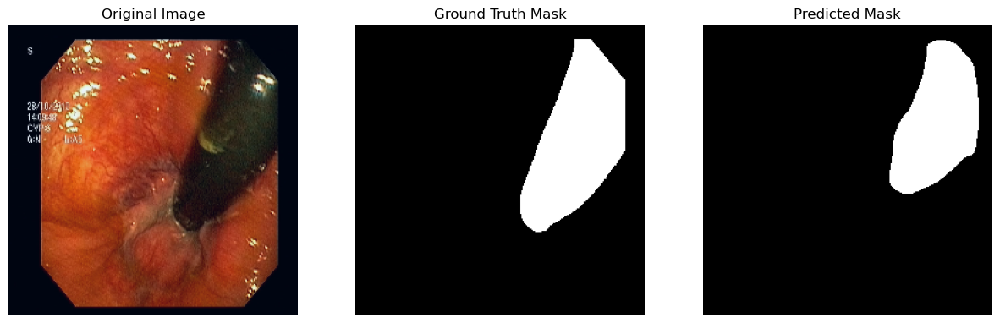

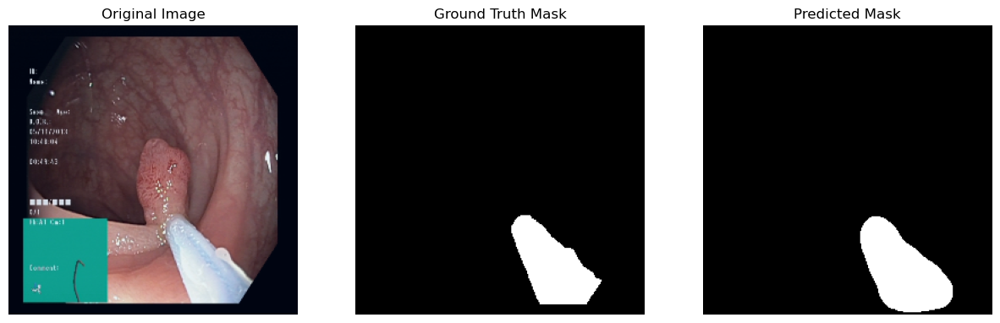

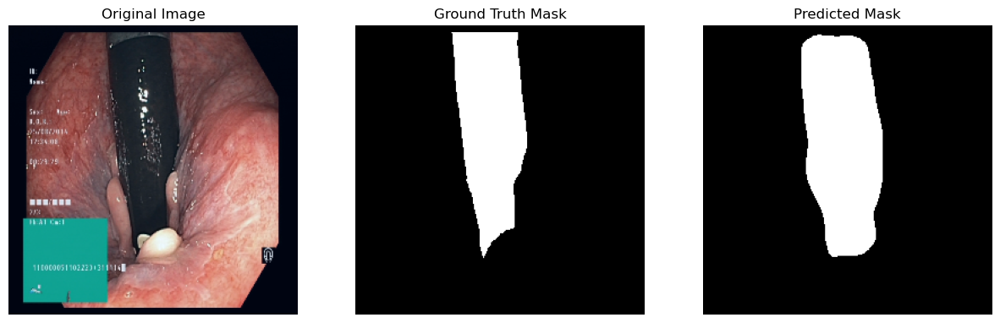

Current Learning Rate: 0.05
EarlyStopping counter: 3 out of 5
Epoch 11/60 - Training Loss: 0.0917 - Validation Loss: 0.0937 - Training Acc: 96.52% - Validation Acc: 96.69% - Training Dice: 0.8209 - Validation Dice: 0.8049 - Training IoU: 0.7021 - Validation IoU: 0.6772 


Current Learning Rate: 0.05
EarlyStopping counter: 0 out of 5
Epoch 12/60 - Training Loss: 0.0817 - Validation Loss: 0.0633 - Training Acc: 97.00% - Validation Acc: 97.94% - Training Dice: 0.8444 - Validation Dice: 0.8865 - Training IoU: 0.7355 - Validation IoU: 0.7979 


Current Learning Rate: 0.05
EarlyStopping counter: 1 out of 5
Epoch 13/60 - Training Loss: 0.0791 - Validation Loss: 0.0675 - Training Acc: 97.07% - Validation Acc: 97.89% - Training Dice: 0.8476 - Validation Dice: 0.8811 - Training IoU: 0.7416 - Validation IoU: 0.7889 


Current Learning Rate: 0.05
EarlyStopping counter: 2 out of 5
Epoch 14/60 - Training Loss: 0.0722 - Validation Loss: 0.0714 - Training Acc: 97.33% - Validation Acc: 97.58% - Training Dice: 0.8602 - Validation Dice: 0.8668 - Training IoU: 0.7604 - Validation IoU: 0.7672 


Current Learning Rate: 0.025
EarlyStopping counter: 3 out of 5
Epoch 15/60 - Training Loss: 0.0695 - Validation Loss: 0.0968 - Training Acc: 97.46% - Validation Acc: 96.75% - Training Dice: 0.8680 - Validation Dice: 0.8026 - Training IoU: 0.7706 - Validation IoU: 0.6787 


Current Learning Rate: 0.025
EarlyStopping counter: 0 out of 5
Epoch 16/60 - Training Loss: 0.0640 - Validation Loss: 0.0623 - Training Acc: 97.62% - Validation Acc: 97.94% - Training Dice: 0.8781 - Validation Dice: 0.8884 - Training IoU: 0.7860 - Validation IoU: 0.8012 


Current Learning Rate: 0.025
EarlyStopping counter: 0 out of 5
Epoch 17/60 - Training Loss: 0.0575 - Validation Loss: 0.0583 - Training Acc: 97.87% - Validation Acc: 98.11% - Training Dice: 0.8912 - Validation Dice: 0.8947 - Training IoU: 0.8065 - Validation IoU: 0.8119 


Current Learning Rate: 0.025
EarlyStopping counter: 1 out of 5
Epoch 18/60 - Training Loss: 0.0552 - Validation Loss: 0.0676 - Training Acc: 97.95% - Validation Acc: 97.81% - Training Dice: 0.8941 - Validation Dice: 0.8800 - Training IoU: 0.8115 - Validation IoU: 0.7880 


Current Learning Rate: 0.025
EarlyStopping counter: 2 out of 5
Epoch 19/60 - Training Loss: 0.0513 - Validation Loss: 0.0593 - Training Acc: 98.11% - Validation Acc: 98.13% - Training Dice: 0.9013 - Validation Dice: 0.8981 - Training IoU: 0.8229 - Validation IoU: 0.8168 


Current Learning Rate: 0.0125
EarlyStopping counter: 3 out of 5
Epoch 20/60 - Training Loss: 0.0531 - Validation Loss: 0.0625 - Training Acc: 98.02% - Validation Acc: 97.97% - Training Dice: 0.8990 - Validation Dice: 0.8867 - Training IoU: 0.8195 - Validation IoU: 0.7980 


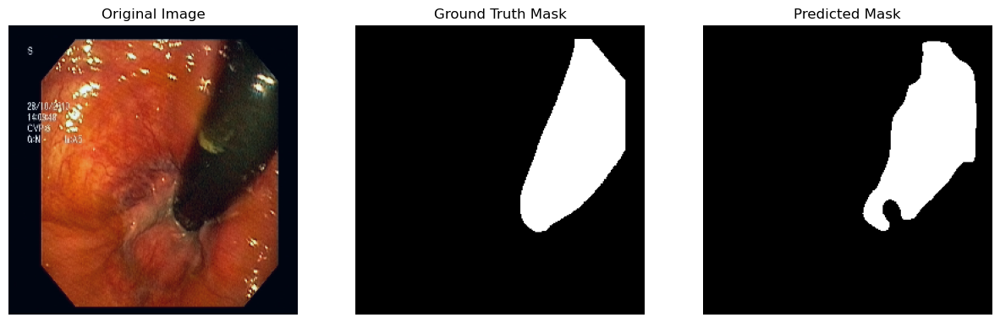

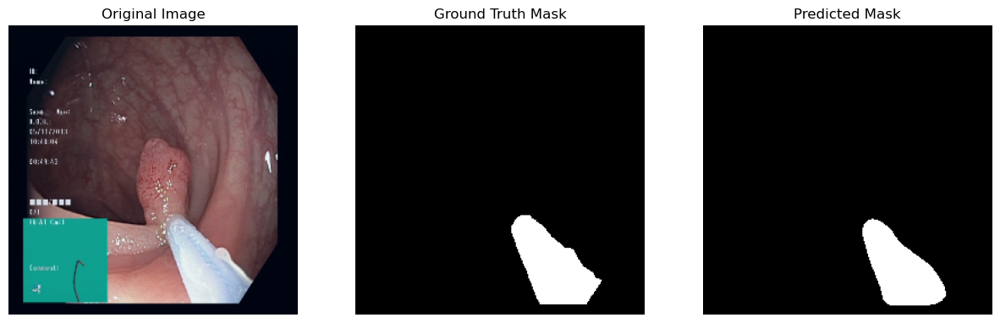

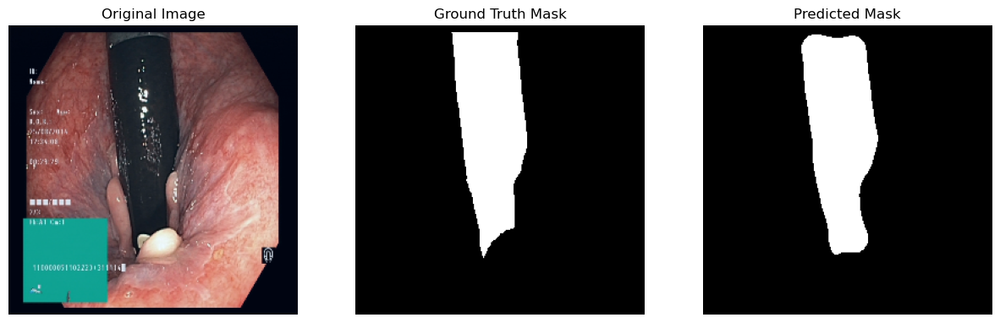

Current Learning Rate: 0.0125
EarlyStopping counter: 0 out of 5
Epoch 21/60 - Training Loss: 0.0472 - Validation Loss: 0.0579 - Training Acc: 98.22% - Validation Acc: 98.22% - Training Dice: 0.9087 - Validation Dice: 0.9013 - Training IoU: 0.8342 - Validation IoU: 0.8220 


Current Learning Rate: 0.0125
EarlyStopping counter: 1 out of 5
Epoch 22/60 - Training Loss: 0.0423 - Validation Loss: 0.0587 - Training Acc: 98.45% - Validation Acc: 98.12% - Training Dice: 0.9199 - Validation Dice: 0.8987 - Training IoU: 0.8529 - Validation IoU: 0.8177 


Current Learning Rate: 0.0125
EarlyStopping counter: 2 out of 5
Epoch 23/60 - Training Loss: 0.0393 - Validation Loss: 0.0609 - Training Acc: 98.55% - Validation Acc: 98.14% - Training Dice: 0.9253 - Validation Dice: 0.8995 - Training IoU: 0.8618 - Validation IoU: 0.8193 


Current Learning Rate: 0.00625
EarlyStopping counter: 3 out of 5
Epoch 24/60 - Training Loss: 0.0384 - Validation Loss: 0.0592 - Training Acc: 98.57% - Validation Acc: 98.29% - Training Dice: 0.9278 - Validation Dice: 0.9065 - Training IoU: 0.8664 - Validation IoU: 0.8305 


Current Learning Rate: 0.00625
EarlyStopping counter: 4 out of 5
Epoch 25/60 - Training Loss: 0.0364 - Validation Loss: 0.0591 - Training Acc: 98.63% - Validation Acc: 98.25% - Training Dice: 0.9284 - Validation Dice: 0.9054 - Training IoU: 0.8678 - Validation IoU: 0.8290 


C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\Mike\AppData\Local\Temp\ipykernel_14796\279954375.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/p

Current Learning Rate: 0.00625
EarlyStopping counter: 5 out of 5
Early stopping at epoch 26


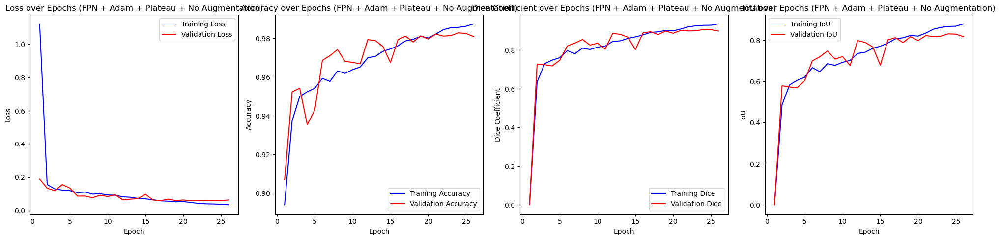

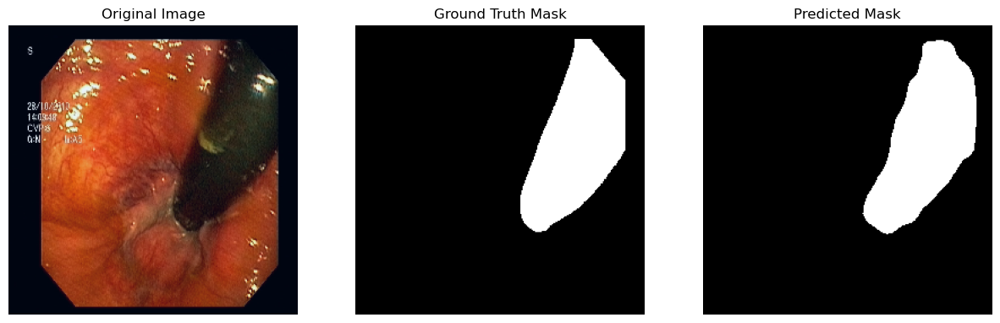

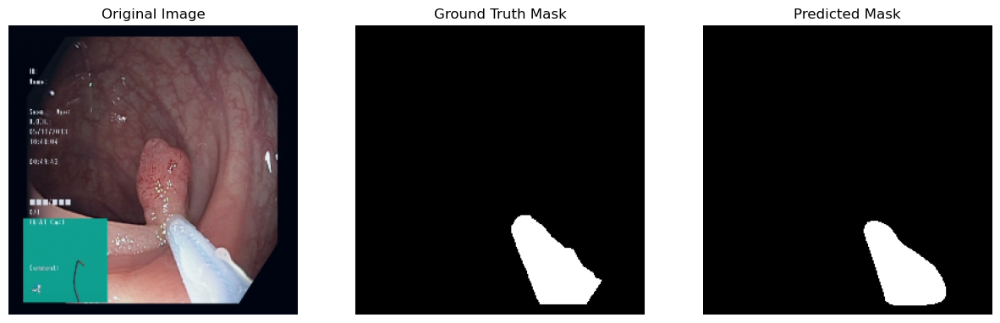

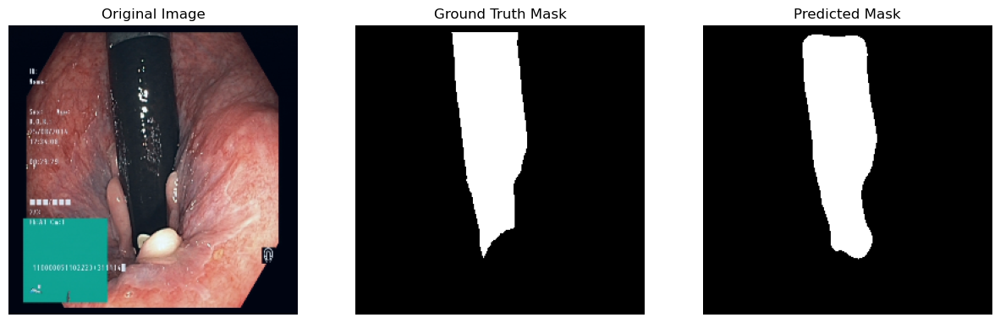

C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Running experiment: UNet++ + Adam + Plateau + No Augmentation


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 1/60 - Training Loss: 0.4979 - Validation Loss: 0.3708 - Training Acc: 89.50% - Validation Acc: 90.69% - Training Dice: 0.0035 - Validation Dice: 0.0000 - Training IoU: 0.0019 - Validation IoU: 0.0000 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 2/60 - Training Loss: 0.1806 - Validation Loss: 0.3474 - Training Acc: 92.43% - Validation Acc: 93.88% - Training Dice: 0.4941 - Validation Dice: 0.6231 - Training IoU: 0.3640 - Validation IoU: 0.4609 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 3/60 - Training Loss: 0.1569 - Validation Loss: 0.1631 - Training Acc: 93.70% - Validation Acc: 93.38% - Training Dice: 0.6713 - Validation Dice: 0.6899 - Training IoU: 0.5156 - Validation IoU: 0.5343 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 4/60 - Training Loss: 0.1396 - Validation Loss: 0.1610 - Training Acc: 94.59% - Validation Acc: 92.83% - Training Dice: 0.7269 - Validation Dice: 0.7058 - Training IoU: 0.5756 - Validation IoU: 0.5529 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 5/60 - Training Loss: 0.1313 - Validation Loss: 0.1206 - Training Acc: 95.01% - Validation Acc: 95.41% - Training Dice: 0.7392 - Validation Dice: 0.7364 - Training IoU: 0.5972 - Validation IoU: 0.5851 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 6/60 - Training Loss: 0.1218 - Validation Loss: 0.1147 - Training Acc: 95.34% - Validation Acc: 96.09% - Training Dice: 0.7637 - Validation Dice: 0.7827 - Training IoU: 0.6245 - Validation IoU: 0.6477 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 7/60 - Training Loss: 0.1240 - Validation Loss: 0.1043 - Training Acc: 95.32% - Validation Acc: 96.12% - Training Dice: 0.7623 - Validation Dice: 0.7810 - Training IoU: 0.6236 - Validation IoU: 0.6447 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 8/60 - Training Loss: 0.1125 - Validation Loss: 0.0985 - Training Acc: 95.81% - Validation Acc: 96.38% - Training Dice: 0.7819 - Validation Dice: 0.8056 - Training IoU: 0.6469 - Validation IoU: 0.6772 


Current Learning Rate: 0.1
EarlyStopping counter: 1 out of 5
Epoch 9/60 - Training Loss: 0.1040 - Validation Loss: 0.1553 - Training Acc: 96.09% - Validation Acc: 94.63% - Training Dice: 0.7972 - Validation Dice: 0.6303 - Training IoU: 0.6703 - Validation IoU: 0.4658 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 10/60 - Training Loss: 0.0981 - Validation Loss: 0.0861 - Training Acc: 96.29% - Validation Acc: 96.97% - Training Dice: 0.8098 - Validation Dice: 0.8195 - Training IoU: 0.6857 - Validation IoU: 0.6959 


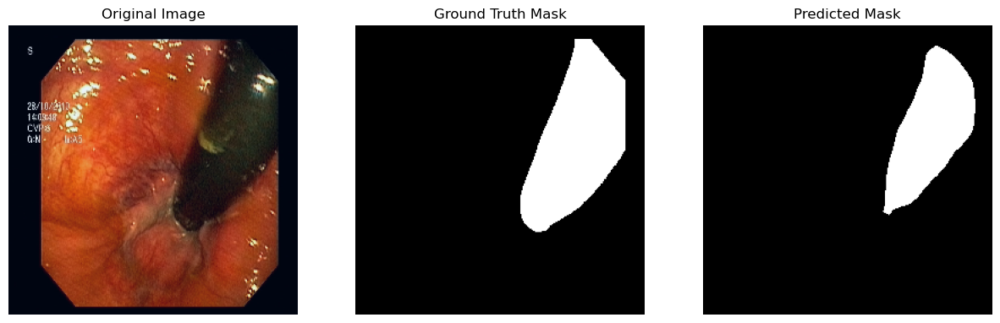

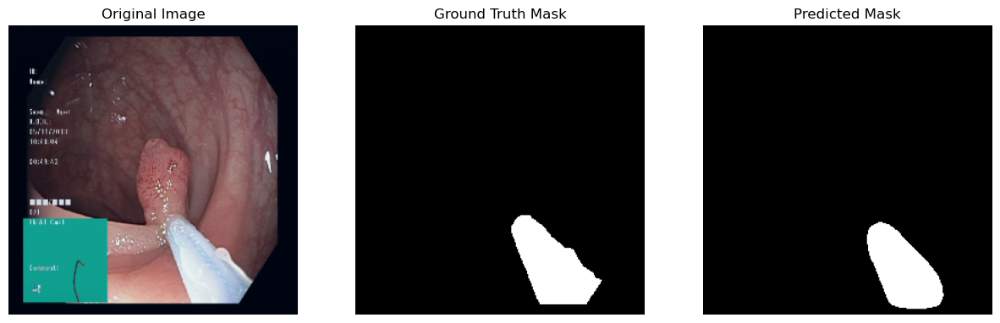

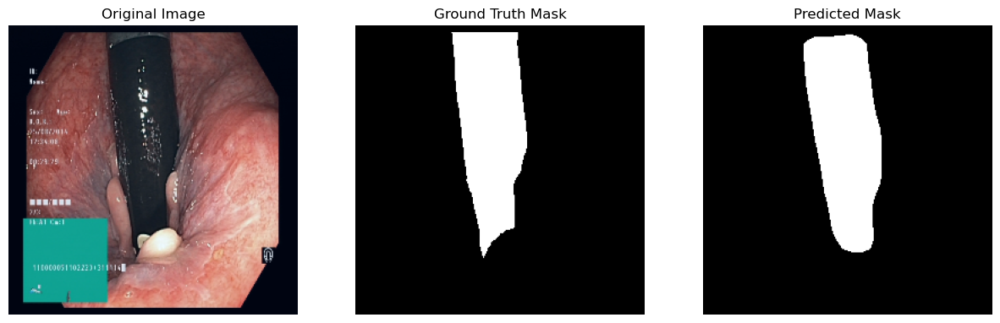

Current Learning Rate: 0.1
EarlyStopping counter: 1 out of 5
Epoch 11/60 - Training Loss: 0.0962 - Validation Loss: 0.1733 - Training Acc: 96.40% - Validation Acc: 94.96% - Training Dice: 0.8154 - Validation Dice: 0.6445 - Training IoU: 0.6938 - Validation IoU: 0.4825 


Current Learning Rate: 0.1
EarlyStopping counter: 2 out of 5
Epoch 12/60 - Training Loss: 0.1003 - Validation Loss: 0.0995 - Training Acc: 96.40% - Validation Acc: 96.65% - Training Dice: 0.8147 - Validation Dice: 0.8039 - Training IoU: 0.6928 - Validation IoU: 0.6758 


Current Learning Rate: 0.05
EarlyStopping counter: 3 out of 5
Epoch 13/60 - Training Loss: 0.0958 - Validation Loss: 0.1027 - Training Acc: 96.42% - Validation Acc: 96.09% - Training Dice: 0.8142 - Validation Dice: 0.7981 - Training IoU: 0.6932 - Validation IoU: 0.6692 


Current Learning Rate: 0.05
EarlyStopping counter: 0 out of 5
Epoch 14/60 - Training Loss: 0.0814 - Validation Loss: 0.0721 - Training Acc: 96.98% - Validation Acc: 97.43% - Training Dice: 0.8455 - Validation Dice: 0.8611 - Training IoU: 0.7360 - Validation IoU: 0.7582 


Current Learning Rate: 0.05
EarlyStopping counter: 1 out of 5
Epoch 15/60 - Training Loss: 0.0780 - Validation Loss: 0.0932 - Training Acc: 97.09% - Validation Acc: 96.49% - Training Dice: 0.8519 - Validation Dice: 0.8024 - Training IoU: 0.7457 - Validation IoU: 0.6743 


Current Learning Rate: 0.05
EarlyStopping counter: 2 out of 5
Epoch 16/60 - Training Loss: 0.0737 - Validation Loss: 0.0754 - Training Acc: 97.31% - Validation Acc: 97.43% - Training Dice: 0.8602 - Validation Dice: 0.8608 - Training IoU: 0.7585 - Validation IoU: 0.7578 


Current Learning Rate: 0.05
EarlyStopping counter: 0 out of 5
Epoch 17/60 - Training Loss: 0.0716 - Validation Loss: 0.0686 - Training Acc: 97.38% - Validation Acc: 97.79% - Training Dice: 0.8654 - Validation Dice: 0.8767 - Training IoU: 0.7669 - Validation IoU: 0.7823 


Current Learning Rate: 0.05
EarlyStopping counter: 1 out of 5
Epoch 18/60 - Training Loss: 0.0726 - Validation Loss: 0.0816 - Training Acc: 97.28% - Validation Acc: 97.14% - Training Dice: 0.8567 - Validation Dice: 0.8486 - Training IoU: 0.7535 - Validation IoU: 0.7390 


Current Learning Rate: 0.05
EarlyStopping counter: 0 out of 5
Epoch 19/60 - Training Loss: 0.0686 - Validation Loss: 0.0658 - Training Acc: 97.45% - Validation Acc: 97.72% - Training Dice: 0.8698 - Validation Dice: 0.8720 - Training IoU: 0.7727 - Validation IoU: 0.7748 


Current Learning Rate: 0.05
EarlyStopping counter: 1 out of 5
Epoch 20/60 - Training Loss: 0.0685 - Validation Loss: 0.1043 - Training Acc: 97.41% - Validation Acc: 96.42% - Training Dice: 0.8663 - Validation Dice: 0.8099 - Training IoU: 0.7675 - Validation IoU: 0.6840 


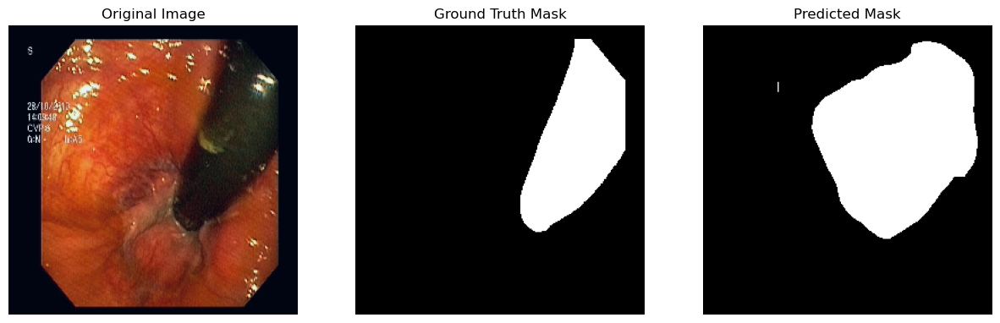

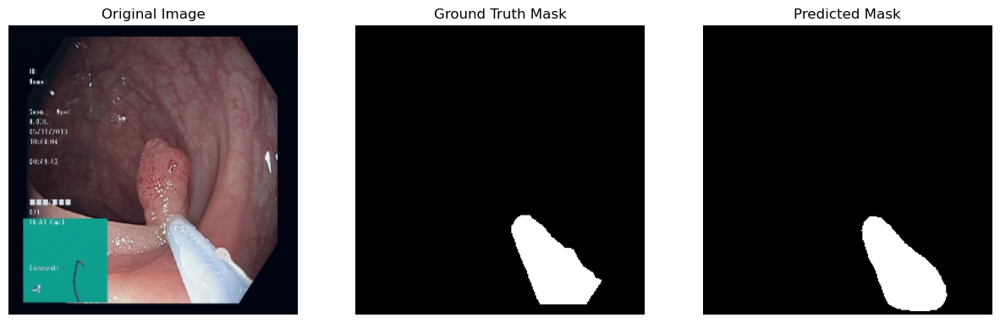

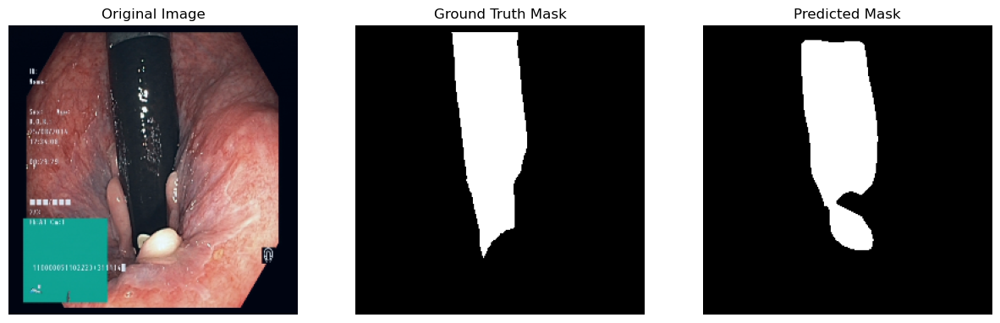

Current Learning Rate: 0.05
EarlyStopping counter: 2 out of 5
Epoch 21/60 - Training Loss: 0.0683 - Validation Loss: 0.0833 - Training Acc: 97.52% - Validation Acc: 97.28% - Training Dice: 0.8719 - Validation Dice: 0.8313 - Training IoU: 0.7759 - Validation IoU: 0.7186 


Current Learning Rate: 0.025
EarlyStopping counter: 3 out of 5
Epoch 22/60 - Training Loss: 0.0680 - Validation Loss: 0.0726 - Training Acc: 97.60% - Validation Acc: 97.50% - Training Dice: 0.8766 - Validation Dice: 0.8565 - Training IoU: 0.7831 - Validation IoU: 0.7515 


Current Learning Rate: 0.025
EarlyStopping counter: 0 out of 5
Epoch 23/60 - Training Loss: 0.0558 - Validation Loss: 0.0586 - Training Acc: 97.97% - Validation Acc: 98.18% - Training Dice: 0.8958 - Validation Dice: 0.8993 - Training IoU: 0.8131 - Validation IoU: 0.8188 


Current Learning Rate: 0.025
EarlyStopping counter: 0 out of 5
Epoch 24/60 - Training Loss: 0.0504 - Validation Loss: 0.0569 - Training Acc: 98.17% - Validation Acc: 98.26% - Training Dice: 0.9046 - Validation Dice: 0.9042 - Training IoU: 0.8284 - Validation IoU: 0.8273 


Current Learning Rate: 0.025
EarlyStopping counter: 1 out of 5
Epoch 25/60 - Training Loss: 0.0507 - Validation Loss: 0.0607 - Training Acc: 98.17% - Validation Acc: 98.08% - Training Dice: 0.9059 - Validation Dice: 0.8911 - Training IoU: 0.8296 - Validation IoU: 0.8047 


Current Learning Rate: 0.025
EarlyStopping counter: 2 out of 5
Epoch 26/60 - Training Loss: 0.0585 - Validation Loss: 0.0649 - Training Acc: 97.80% - Validation Acc: 97.84% - Training Dice: 0.8865 - Validation Dice: 0.8848 - Training IoU: 0.8009 - Validation IoU: 0.7954 


Current Learning Rate: 0.0125
EarlyStopping counter: 3 out of 5
Epoch 27/60 - Training Loss: 0.0533 - Validation Loss: 0.0636 - Training Acc: 98.04% - Validation Acc: 98.15% - Training Dice: 0.8983 - Validation Dice: 0.8967 - Training IoU: 0.8183 - Validation IoU: 0.8144 


Current Learning Rate: 0.0125
EarlyStopping counter: 4 out of 5
Epoch 28/60 - Training Loss: 0.0447 - Validation Loss: 0.0608 - Training Acc: 98.36% - Validation Acc: 98.25% - Training Dice: 0.9153 - Validation Dice: 0.9035 - Training IoU: 0.8456 - Validation IoU: 0.8263 


C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\Mike\AppData\Local\Temp\ipykernel_14796\279954375.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/p

Current Learning Rate: 0.0125
EarlyStopping counter: 5 out of 5
Early stopping at epoch 29


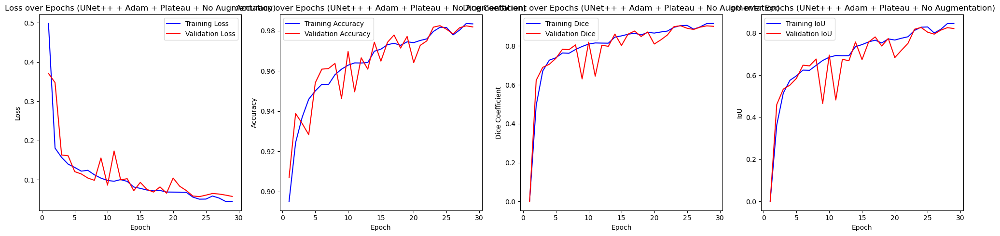

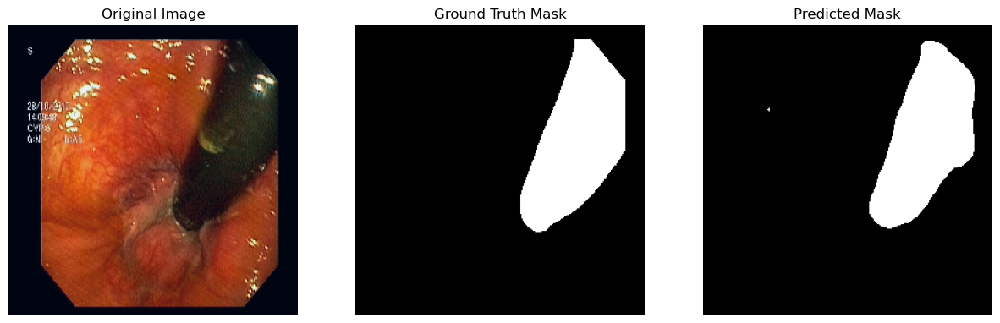

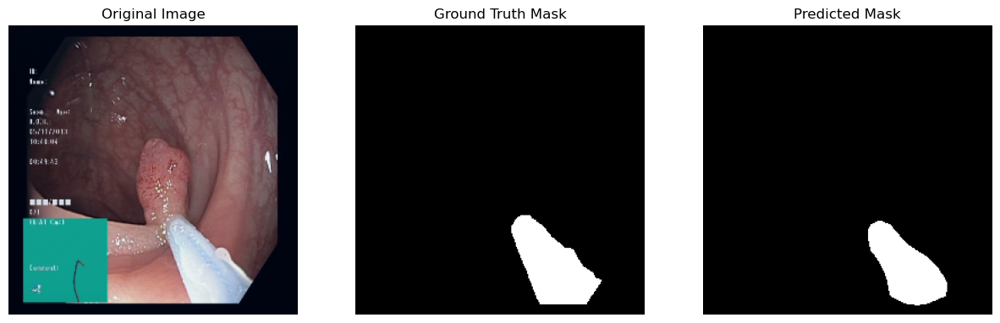

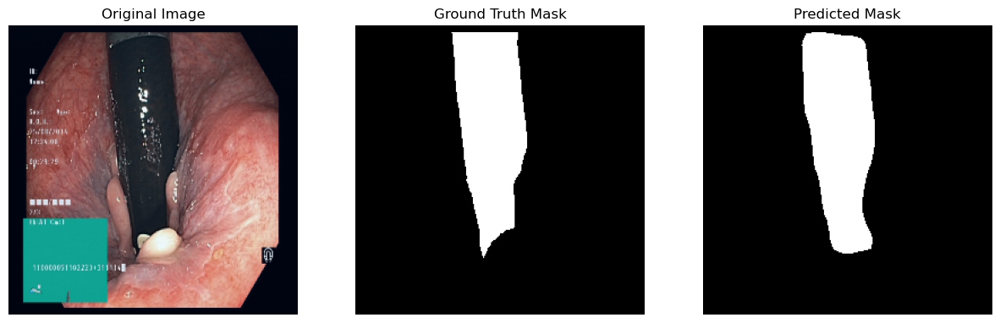


Running experiment: UNet + Adam + Plateau + No Augmentation


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 1/60 - Training Loss: 0.2299 - Validation Loss: 0.4526 - Training Acc: 90.20% - Validation Acc: 74.37% - Training Dice: 0.0930 - Validation Dice: 0.4157 - Training IoU: 0.0696 - Validation IoU: 0.2654 


Current Learning Rate: 0.1
EarlyStopping counter: 1 out of 5
Epoch 2/60 - Training Loss: 0.1369 - Validation Loss: 1.1560 - Training Acc: 94.63% - Validation Acc: 67.37% - Training Dice: 0.7138 - Validation Dice: 0.3289 - Training IoU: 0.5655 - Validation IoU: 0.1991 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 3/60 - Training Loss: 0.1321 - Validation Loss: 0.1386 - Training Acc: 94.93% - Validation Acc: 94.55% - Training Dice: 0.7317 - Validation Dice: 0.7567 - Training IoU: 0.5911 - Validation IoU: 0.6160 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 4/60 - Training Loss: 0.1122 - Validation Loss: 0.1078 - Training Acc: 95.71% - Validation Acc: 96.01% - Training Dice: 0.7770 - Validation Dice: 0.7758 - Training IoU: 0.6440 - Validation IoU: 0.6371 


Current Learning Rate: 0.1
EarlyStopping counter: 1 out of 5
Epoch 5/60 - Training Loss: 0.1174 - Validation Loss: 0.3450 - Training Acc: 95.41% - Validation Acc: 85.51% - Training Dice: 0.7586 - Validation Dice: 0.5279 - Training IoU: 0.6211 - Validation IoU: 0.3621 


Current Learning Rate: 0.1
EarlyStopping counter: 2 out of 5
Epoch 6/60 - Training Loss: 0.1112 - Validation Loss: 0.1153 - Training Acc: 95.77% - Validation Acc: 95.40% - Training Dice: 0.7815 - Validation Dice: 0.7183 - Training IoU: 0.6482 - Validation IoU: 0.5696 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 7/60 - Training Loss: 0.1034 - Validation Loss: 0.0895 - Training Acc: 95.92% - Validation Acc: 96.57% - Training Dice: 0.7848 - Validation Dice: 0.7893 - Training IoU: 0.6523 - Validation IoU: 0.6546 


Current Learning Rate: 0.1
EarlyStopping counter: 1 out of 5
Epoch 8/60 - Training Loss: 0.1029 - Validation Loss: 0.1123 - Training Acc: 95.97% - Validation Acc: 95.69% - Training Dice: 0.7908 - Validation Dice: 0.7549 - Training IoU: 0.6599 - Validation IoU: 0.6115 


Current Learning Rate: 0.1
EarlyStopping counter: 2 out of 5
Epoch 9/60 - Training Loss: 0.1058 - Validation Loss: 0.8775 - Training Acc: 96.06% - Validation Acc: 76.06% - Training Dice: 0.7934 - Validation Dice: 0.4263 - Training IoU: 0.6653 - Validation IoU: 0.2737 


Current Learning Rate: 0.1
EarlyStopping counter: 0 out of 5
Epoch 10/60 - Training Loss: 0.1045 - Validation Loss: 0.0823 - Training Acc: 96.11% - Validation Acc: 97.09% - Training Dice: 0.7957 - Validation Dice: 0.8514 - Training IoU: 0.6683 - Validation IoU: 0.7447 


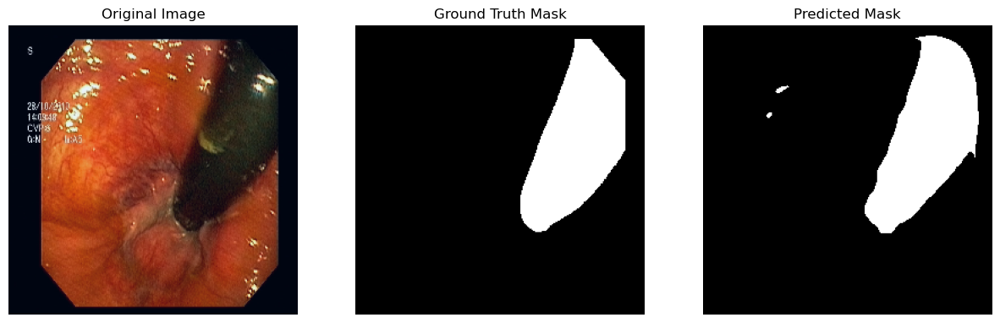

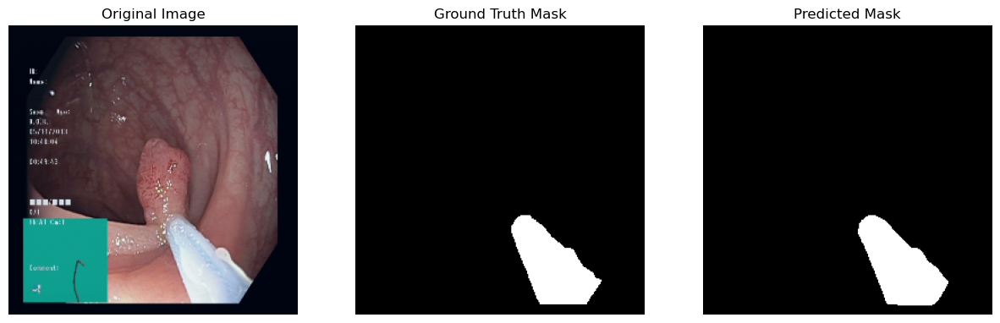

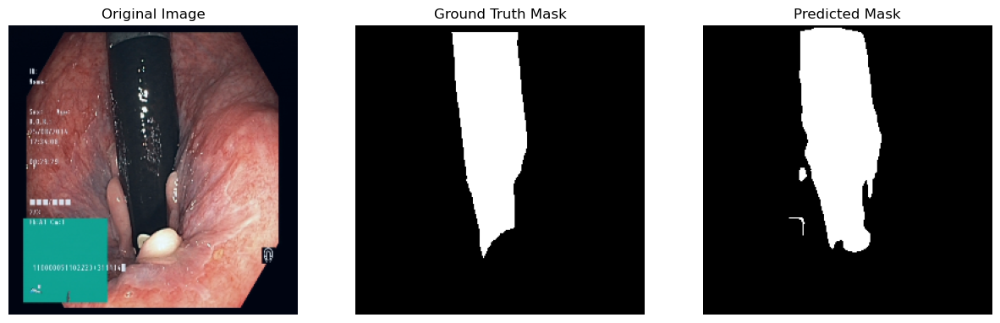

Current Learning Rate: 0.1
EarlyStopping counter: 1 out of 5
Epoch 11/60 - Training Loss: 0.0978 - Validation Loss: 0.1128 - Training Acc: 96.44% - Validation Acc: 96.93% - Training Dice: 0.8161 - Validation Dice: 0.8097 - Training IoU: 0.6957 - Validation IoU: 0.6856 


Current Learning Rate: 0.1
EarlyStopping counter: 2 out of 5
Epoch 12/60 - Training Loss: 0.0955 - Validation Loss: 0.1205 - Training Acc: 96.50% - Validation Acc: 95.15% - Training Dice: 0.8197 - Validation Dice: 0.7753 - Training IoU: 0.7025 - Validation IoU: 0.6359 


Current Learning Rate: 0.05
EarlyStopping counter: 3 out of 5
Epoch 13/60 - Training Loss: 0.1036 - Validation Loss: 0.1547 - Training Acc: 96.15% - Validation Acc: 94.87% - Training Dice: 0.7996 - Validation Dice: 0.6837 - Training IoU: 0.6749 - Validation IoU: 0.5276 


Current Learning Rate: 0.05
EarlyStopping counter: 4 out of 5
Epoch 14/60 - Training Loss: 0.0925 - Validation Loss: 0.0835 - Training Acc: 96.55% - Validation Acc: 96.76% - Training Dice: 0.8196 - Validation Dice: 0.8198 - Training IoU: 0.7016 - Validation IoU: 0.6988 


Current Learning Rate: 0.05
EarlyStopping counter: 0 out of 5
Epoch 15/60 - Training Loss: 0.0843 - Validation Loss: 0.0634 - Training Acc: 96.85% - Validation Acc: 97.75% - Training Dice: 0.8390 - Validation Dice: 0.8705 - Training IoU: 0.7282 - Validation IoU: 0.7732 


Current Learning Rate: 0.05
EarlyStopping counter: 1 out of 5
Epoch 16/60 - Training Loss: 0.0828 - Validation Loss: 0.0715 - Training Acc: 96.88% - Validation Acc: 97.26% - Training Dice: 0.8394 - Validation Dice: 0.8569 - Training IoU: 0.7278 - Validation IoU: 0.7530 


Current Learning Rate: 0.05
EarlyStopping counter: 2 out of 5
Epoch 17/60 - Training Loss: 0.0810 - Validation Loss: 0.0656 - Training Acc: 96.94% - Validation Acc: 97.65% - Training Dice: 0.8440 - Validation Dice: 0.8600 - Training IoU: 0.7347 - Validation IoU: 0.7571 


Current Learning Rate: 0.025
EarlyStopping counter: 3 out of 5
Epoch 18/60 - Training Loss: 0.0803 - Validation Loss: 0.0655 - Training Acc: 96.94% - Validation Acc: 97.55% - Training Dice: 0.8446 - Validation Dice: 0.8620 - Training IoU: 0.7362 - Validation IoU: 0.7600 


Current Learning Rate: 0.025
EarlyStopping counter: 0 out of 5
Epoch 19/60 - Training Loss: 0.0729 - Validation Loss: 0.0588 - Training Acc: 97.28% - Validation Acc: 97.90% - Training Dice: 0.8588 - Validation Dice: 0.8791 - Training IoU: 0.7563 - Validation IoU: 0.7855 


Current Learning Rate: 0.025
EarlyStopping counter: 0 out of 5
Epoch 20/60 - Training Loss: 0.0732 - Validation Loss: 0.0569 - Training Acc: 97.27% - Validation Acc: 97.98% - Training Dice: 0.8600 - Validation Dice: 0.8876 - Training IoU: 0.7576 - Validation IoU: 0.7995 


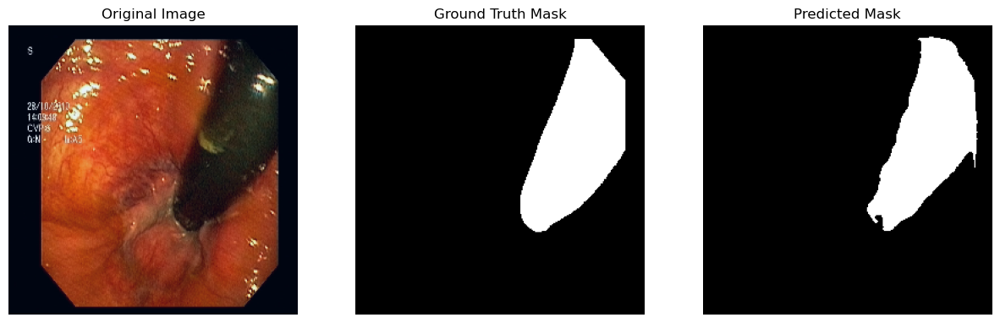

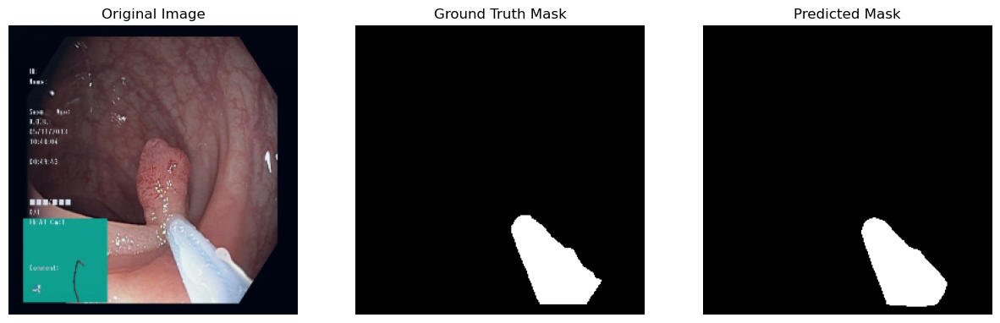

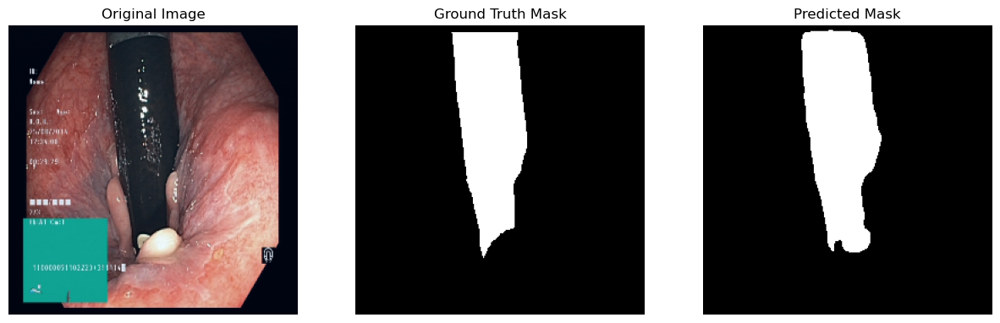

Current Learning Rate: 0.025
EarlyStopping counter: 1 out of 5
Epoch 21/60 - Training Loss: 0.0737 - Validation Loss: 0.1584 - Training Acc: 97.23% - Validation Acc: 93.70% - Training Dice: 0.8569 - Validation Dice: 0.7289 - Training IoU: 0.7563 - Validation IoU: 0.5781 


Current Learning Rate: 0.025
EarlyStopping counter: 0 out of 5
Epoch 22/60 - Training Loss: 0.0723 - Validation Loss: 0.0544 - Training Acc: 97.30% - Validation Acc: 98.11% - Training Dice: 0.8615 - Validation Dice: 0.8923 - Training IoU: 0.7618 - Validation IoU: 0.8069 


Current Learning Rate: 0.025
EarlyStopping counter: 1 out of 5
Epoch 23/60 - Training Loss: 0.0685 - Validation Loss: 0.0616 - Training Acc: 97.40% - Validation Acc: 97.85% - Training Dice: 0.8682 - Validation Dice: 0.8777 - Training IoU: 0.7706 - Validation IoU: 0.7835 


Current Learning Rate: 0.025
EarlyStopping counter: 2 out of 5
Epoch 24/60 - Training Loss: 0.0689 - Validation Loss: 0.1198 - Training Acc: 97.37% - Validation Acc: 95.43% - Training Dice: 0.8666 - Validation Dice: 0.7807 - Training IoU: 0.7683 - Validation IoU: 0.6441 


Current Learning Rate: 0.0125
EarlyStopping counter: 3 out of 5
Epoch 25/60 - Training Loss: 0.0699 - Validation Loss: 0.0557 - Training Acc: 97.35% - Validation Acc: 98.00% - Training Dice: 0.8640 - Validation Dice: 0.8892 - Training IoU: 0.7653 - Validation IoU: 0.8020 


Current Learning Rate: 0.0125
EarlyStopping counter: 0 out of 5
Epoch 26/60 - Training Loss: 0.0636 - Validation Loss: 0.0513 - Training Acc: 97.55% - Validation Acc: 98.19% - Training Dice: 0.8734 - Validation Dice: 0.8995 - Training IoU: 0.7787 - Validation IoU: 0.8187 


Current Learning Rate: 0.0125
EarlyStopping counter: 1 out of 5
Epoch 27/60 - Training Loss: 0.0649 - Validation Loss: 0.0559 - Training Acc: 97.56% - Validation Acc: 97.93% - Training Dice: 0.8767 - Validation Dice: 0.8872 - Training IoU: 0.7846 - Validation IoU: 0.7991 


Current Learning Rate: 0.0125
EarlyStopping counter: 0 out of 5
Epoch 28/60 - Training Loss: 0.0606 - Validation Loss: 0.0492 - Training Acc: 97.66% - Validation Acc: 98.31% - Training Dice: 0.8804 - Validation Dice: 0.9057 - Training IoU: 0.7900 - Validation IoU: 0.8289 


Current Learning Rate: 0.0125
EarlyStopping counter: 1 out of 5
Epoch 29/60 - Training Loss: 0.0611 - Validation Loss: 0.0506 - Training Acc: 97.66% - Validation Acc: 98.24% - Training Dice: 0.8785 - Validation Dice: 0.8994 - Training IoU: 0.7894 - Validation IoU: 0.8189 


Current Learning Rate: 0.0125
EarlyStopping counter: 2 out of 5
Epoch 30/60 - Training Loss: 0.0614 - Validation Loss: 0.0501 - Training Acc: 97.63% - Validation Acc: 98.24% - Training Dice: 0.8769 - Validation Dice: 0.9006 - Training IoU: 0.7856 - Validation IoU: 0.8209 


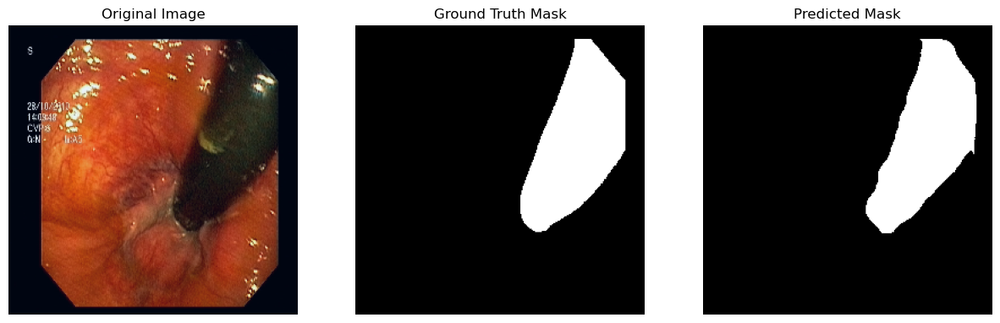

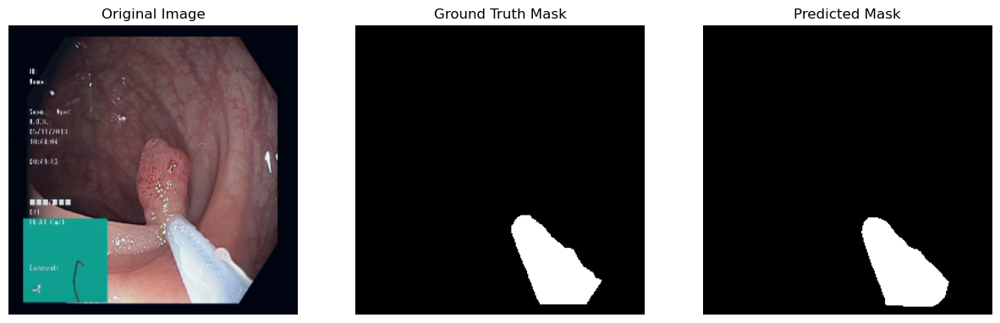

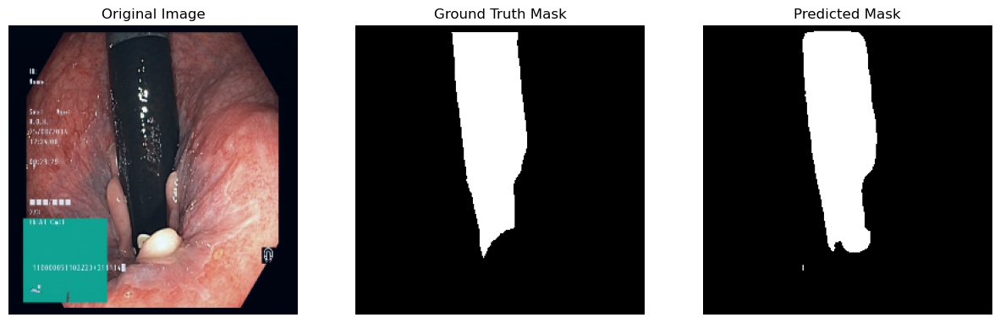

Current Learning Rate: 0.00625
EarlyStopping counter: 3 out of 5
Epoch 31/60 - Training Loss: 0.0585 - Validation Loss: 0.0559 - Training Acc: 97.80% - Validation Acc: 97.94% - Training Dice: 0.8863 - Validation Dice: 0.8881 - Training IoU: 0.7994 - Validation IoU: 0.8004 


Current Learning Rate: 0.00625
EarlyStopping counter: 0 out of 5
Epoch 32/60 - Training Loss: 0.0593 - Validation Loss: 0.0484 - Training Acc: 97.74% - Validation Acc: 98.25% - Training Dice: 0.8829 - Validation Dice: 0.9035 - Training IoU: 0.7958 - Validation IoU: 0.8252 


Current Learning Rate: 0.00625
EarlyStopping counter: 0 out of 5
Epoch 33/60 - Training Loss: 0.0562 - Validation Loss: 0.0463 - Training Acc: 97.90% - Validation Acc: 98.38% - Training Dice: 0.8916 - Validation Dice: 0.9093 - Training IoU: 0.8077 - Validation IoU: 0.8348 


Current Learning Rate: 0.00625
EarlyStopping counter: 1 out of 5
Epoch 34/60 - Training Loss: 0.0545 - Validation Loss: 0.0478 - Training Acc: 97.93% - Validation Acc: 98.27% - Training Dice: 0.8944 - Validation Dice: 0.9059 - Training IoU: 0.8115 - Validation IoU: 0.8295 


Current Learning Rate: 0.00625
EarlyStopping counter: 0 out of 5
Epoch 35/60 - Training Loss: 0.0542 - Validation Loss: 0.0460 - Training Acc: 97.92% - Validation Acc: 98.38% - Training Dice: 0.8940 - Validation Dice: 0.9093 - Training IoU: 0.8110 - Validation IoU: 0.8350 


Current Learning Rate: 0.00625
EarlyStopping counter: 1 out of 5
Epoch 36/60 - Training Loss: 0.0524 - Validation Loss: 0.0476 - Training Acc: 98.01% - Validation Acc: 98.26% - Training Dice: 0.8970 - Validation Dice: 0.9056 - Training IoU: 0.8160 - Validation IoU: 0.8290 


Current Learning Rate: 0.00625
EarlyStopping counter: 2 out of 5
Epoch 37/60 - Training Loss: 0.0525 - Validation Loss: 0.0499 - Training Acc: 97.97% - Validation Acc: 98.32% - Training Dice: 0.8946 - Validation Dice: 0.9047 - Training IoU: 0.8125 - Validation IoU: 0.8273 


Current Learning Rate: 0.003125
EarlyStopping counter: 3 out of 5
Epoch 38/60 - Training Loss: 0.0533 - Validation Loss: 0.0471 - Training Acc: 97.94% - Validation Acc: 98.35% - Training Dice: 0.8939 - Validation Dice: 0.9087 - Training IoU: 0.8120 - Validation IoU: 0.8338 


Current Learning Rate: 0.003125
EarlyStopping counter: 4 out of 5
Epoch 39/60 - Training Loss: 0.0504 - Validation Loss: 0.0466 - Training Acc: 98.07% - Validation Acc: 98.39% - Training Dice: 0.9008 - Validation Dice: 0.9113 - Training IoU: 0.8215 - Validation IoU: 0.8382 


Current Learning Rate: 0.003125
EarlyStopping counter: 0 out of 5
Epoch 40/60 - Training Loss: 0.0495 - Validation Loss: 0.0458 - Training Acc: 98.11% - Validation Acc: 98.38% - Training Dice: 0.9019 - Validation Dice: 0.9113 - Training IoU: 0.8239 - Validation IoU: 0.8382 


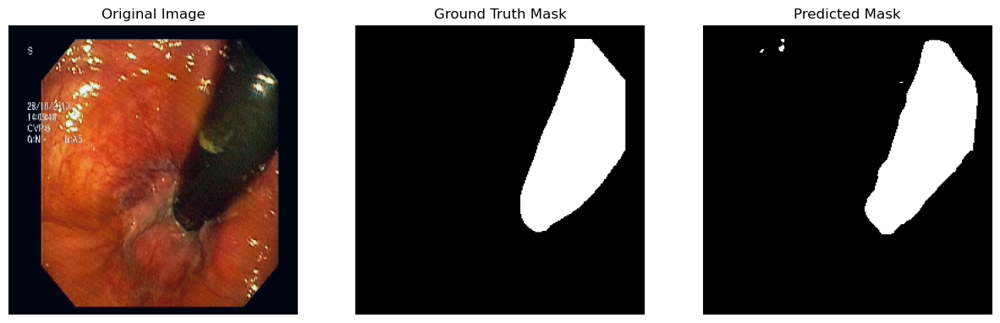

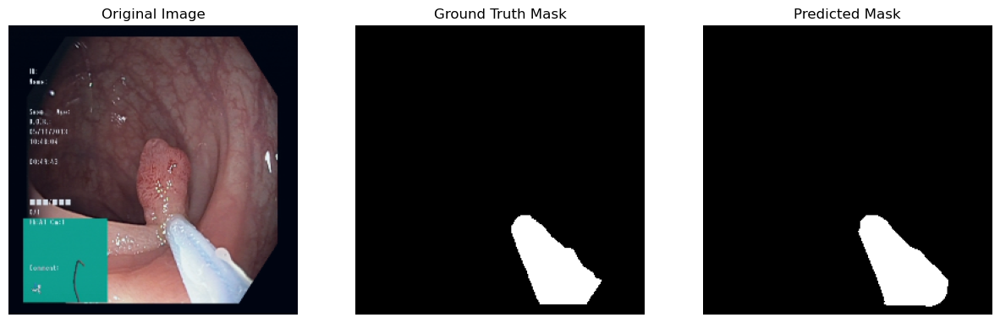

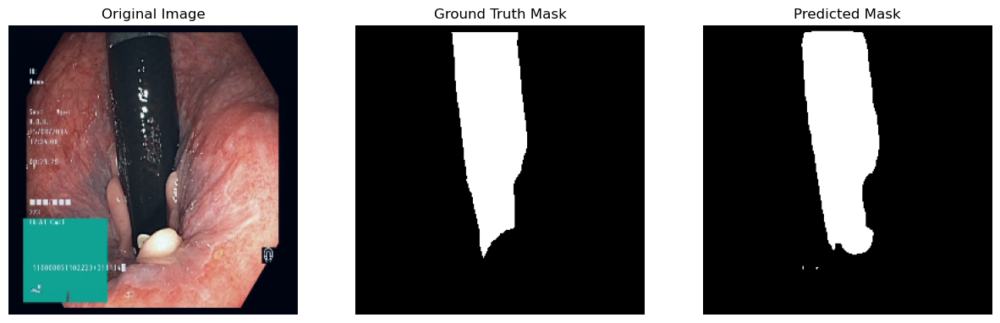

Current Learning Rate: 0.003125
EarlyStopping counter: 1 out of 5
Epoch 41/60 - Training Loss: 0.0473 - Validation Loss: 0.0467 - Training Acc: 98.19% - Validation Acc: 98.39% - Training Dice: 0.9074 - Validation Dice: 0.9101 - Training IoU: 0.8325 - Validation IoU: 0.8362 


Current Learning Rate: 0.003125
EarlyStopping counter: 2 out of 5
Epoch 42/60 - Training Loss: 0.0490 - Validation Loss: 0.0459 - Training Acc: 98.13% - Validation Acc: 98.40% - Training Dice: 0.9047 - Validation Dice: 0.9109 - Training IoU: 0.8283 - Validation IoU: 0.8376 


Current Learning Rate: 0.0015625
EarlyStopping counter: 3 out of 5
Epoch 43/60 - Training Loss: 0.0473 - Validation Loss: 0.0459 - Training Acc: 98.20% - Validation Acc: 98.42% - Training Dice: 0.9069 - Validation Dice: 0.9119 - Training IoU: 0.8314 - Validation IoU: 0.8393 


Current Learning Rate: 0.0015625
EarlyStopping counter: 0 out of 5
Epoch 44/60 - Training Loss: 0.0486 - Validation Loss: 0.0458 - Training Acc: 98.14% - Validation Acc: 98.41% - Training Dice: 0.9045 - Validation Dice: 0.9126 - Training IoU: 0.8286 - Validation IoU: 0.8404 


Current Learning Rate: 0.0015625
EarlyStopping counter: 0 out of 5
Epoch 45/60 - Training Loss: 0.0469 - Validation Loss: 0.0453 - Training Acc: 98.23% - Validation Acc: 98.41% - Training Dice: 0.9088 - Validation Dice: 0.9117 - Training IoU: 0.8344 - Validation IoU: 0.8390 


Current Learning Rate: 0.0015625
EarlyStopping counter: 1 out of 5
Epoch 46/60 - Training Loss: 0.0474 - Validation Loss: 0.0457 - Training Acc: 98.17% - Validation Acc: 98.40% - Training Dice: 0.9054 - Validation Dice: 0.9120 - Training IoU: 0.8296 - Validation IoU: 0.8396 


Current Learning Rate: 0.0015625
EarlyStopping counter: 2 out of 5
Epoch 47/60 - Training Loss: 0.0464 - Validation Loss: 0.0459 - Training Acc: 98.22% - Validation Acc: 98.41% - Training Dice: 0.9072 - Validation Dice: 0.9115 - Training IoU: 0.8337 - Validation IoU: 0.8388 


Current Learning Rate: 0.00078125
EarlyStopping counter: 3 out of 5
Epoch 48/60 - Training Loss: 0.0473 - Validation Loss: 0.0459 - Training Acc: 98.20% - Validation Acc: 98.38% - Training Dice: 0.9073 - Validation Dice: 0.9110 - Training IoU: 0.8324 - Validation IoU: 0.8379 


Current Learning Rate: 0.00078125
EarlyStopping counter: 4 out of 5
Epoch 49/60 - Training Loss: 0.0456 - Validation Loss: 0.0457 - Training Acc: 98.27% - Validation Acc: 98.41% - Training Dice: 0.9104 - Validation Dice: 0.9120 - Training IoU: 0.8378 - Validation IoU: 0.8394 


C:\Users\Mike\AppData\Local\Temp\ipykernel_14796\279954375.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model.load_state_dict(torch.load(os.path.join(working_di

Current Learning Rate: 0.00078125
EarlyStopping counter: 5 out of 5
Early stopping at epoch 50


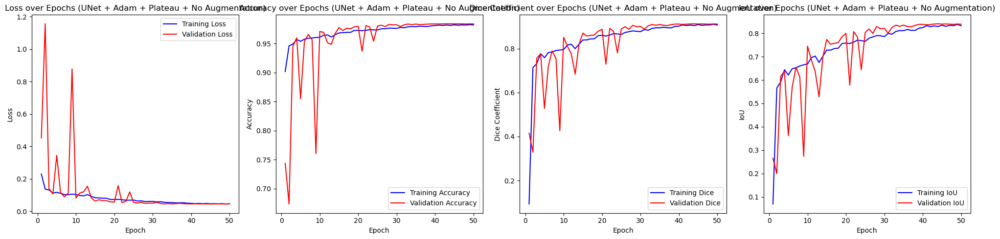

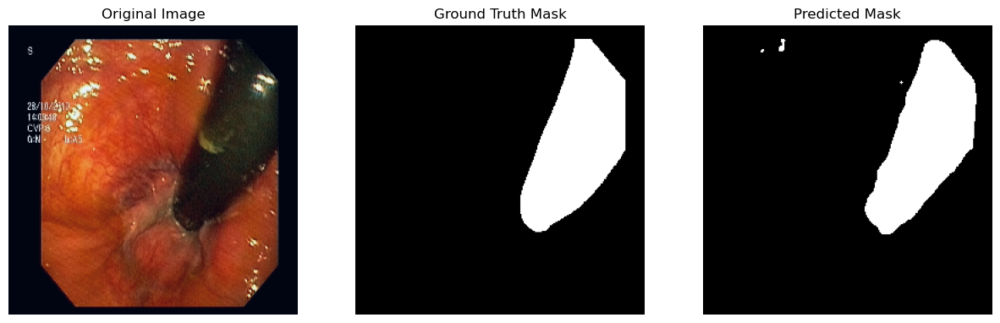

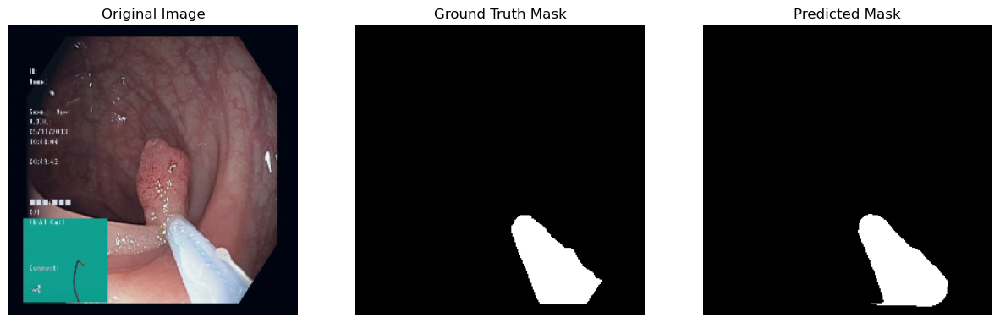

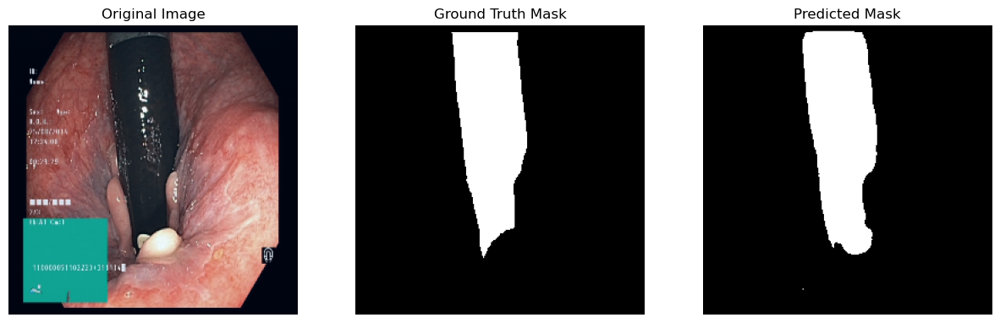


Summary of Experiments:
                                       Model  Best Epoch  Train Loss  \
0     FPN + Adam + Plateau + No Augmentation          21    0.047184   
1  UNet++ + Adam + Plateau + No Augmentation          24    0.050442   
2    UNet + Adam + Plateau + No Augmentation          45    0.046909   

   Validation Loss  Train Accuracy  Validation Accuracy  Train Dice  \
0         0.057946        0.982218             0.982206    0.908703   
1         0.056936        0.981731             0.982551    0.904646   
2         0.045350        0.982311             0.984123    0.908782   

   Validation Dice  Train IoU  Validation IoU  Test Loss  Test Accuracy  \
0         0.901302   0.834231        0.821954   0.057946       0.982206   
1         0.904158   0.828401        0.827272   0.056936       0.982551   
2         0.911668   0.834437        0.839042   0.045350       0.984123   

   Test Dice  Test IoU  
0   0.901302  0.821954  
1   0.904158  0.827272  
2   0.911668  0.839042  


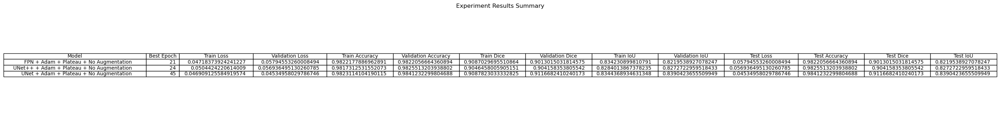

In [32]:

def get_unet():
    return UNet()

def get_unetpp():
    return UNetPlusPlus()

def get_fpn():
    return FPN()

optimizer_adam = lambda params: optim.Adam(params, lr=0.1)

scheduler_plateau = lambda optimizer: ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)

# Run experiments and store results
results = []

# Experiment 1: UNet with Adam, Plateau scheduler, and augmentations

# Experiment 3: FPN with RMSprop, Exponential scheduler, and augmentations
_, metrics3 = run_experiment(model_fn=get_fpn,
                             optimizer_fn=optimizer_adam,
                             scheduler_fn=scheduler_plateau ,
                             augmentations=no_augmentations,
                             experiment_name='FPN + Adam + Plateau + No Augmentation')
results.append(metrics3)

_, metrics1 = run_experiment(model_fn=get_unetpp,
                             optimizer_fn=optimizer_adam,
                             scheduler_fn=scheduler_plateau,
                             augmentations=no_augmentations,
                             experiment_name='UNet++ + Adam + Plateau + No Augmentation')
results.append(metrics1)

# Experiment 2: UNet++ with SGD, Step scheduler, no augmentation
_, metrics2 = run_experiment(model_fn=get_unet,
                             optimizer_fn=optimizer_adam,
                             scheduler_fn=scheduler_plateau,
                             augmentations=no_augmentations,
                             experiment_name='UNet + Adam + Plateau + No Augmentation')
results.append(metrics2)



# Create a summary table using pandas DataFrame
summary_df = pd.DataFrame(results)
print("\nSummary of Experiments:")
print(summary_df)

# Visualize the summary table using matplotlib
fig, ax = plt.subplots(figsize=(12, 4))
ax.axis('tight')
ax.axis('off')
table = ax.table(cellText=summary_df.values, colLabels=summary_df.columns, loc='center')
table.auto_set_font_size(False)
table.set_fontsize(10)
table.auto_set_column_width(col=list(range(len(summary_df.columns))))
plt.title("Experiment Results Summary")
plt.show()

C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Running experiment: FPN(0.01) +  Augmentation


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 1/60 - Training Loss: 0.3369 - Validation Loss: 0.3328 - Training Acc: 88.98% - Validation Acc: 90.09% - Training Dice: 0.0896 - Validation Dice: 0.0456 - Training IoU: 0.0545 - Validation IoU: 0.0246 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 2/60 - Training Loss: 0.1939 - Validation Loss: 0.1723 - Training Acc: 92.56% - Validation Acc: 94.06% - Training Dice: 0.5356 - Validation Dice: 0.6403 - Training IoU: 0.3788 - Validation IoU: 0.4792 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 3/60 - Training Loss: 0.1604 - Validation Loss: 0.1361 - Training Acc: 93.85% - Validation Acc: 95.25% - Training Dice: 0.6495 - Validation Dice: 0.7275 - Training IoU: 0.4887 - Validation IoU: 0.5792 


Current Learning Rate: 0.01
EarlyStopping counter: 1 out of 5
Epoch 4/60 - Training Loss: 0.1442 - Validation Loss: 0.1436 - Training Acc: 94.48% - Validation Acc: 94.73% - Training Dice: 0.6909 - Validation Dice: 0.6913 - Training IoU: 0.5377 - Validation IoU: 0.5339 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 5/60 - Training Loss: 0.1263 - Validation Loss: 0.0862 - Training Acc: 95.18% - Validation Acc: 96.87% - Training Dice: 0.7317 - Validation Dice: 0.8242 - Training IoU: 0.5855 - Validation IoU: 0.7036 


Current Learning Rate: 0.01
EarlyStopping counter: 1 out of 5
Epoch 6/60 - Training Loss: 0.1267 - Validation Loss: 0.0909 - Training Acc: 95.23% - Validation Acc: 96.67% - Training Dice: 0.7407 - Validation Dice: 0.8052 - Training IoU: 0.5949 - Validation IoU: 0.6786 


Current Learning Rate: 0.01
EarlyStopping counter: 2 out of 5
Epoch 7/60 - Training Loss: 0.1289 - Validation Loss: 0.0949 - Training Acc: 95.01% - Validation Acc: 96.23% - Training Dice: 0.7239 - Validation Dice: 0.7898 - Training IoU: 0.5739 - Validation IoU: 0.6558 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 8/60 - Training Loss: 0.1203 - Validation Loss: 0.0849 - Training Acc: 95.38% - Validation Acc: 96.87% - Training Dice: 0.7523 - Validation Dice: 0.8043 - Training IoU: 0.6081 - Validation IoU: 0.6755 


Current Learning Rate: 0.01
EarlyStopping counter: 1 out of 5
Epoch 9/60 - Training Loss: 0.1218 - Validation Loss: 0.1034 - Training Acc: 95.37% - Validation Acc: 95.87% - Training Dice: 0.7506 - Validation Dice: 0.7567 - Training IoU: 0.6101 - Validation IoU: 0.6152 


Current Learning Rate: 0.01
EarlyStopping counter: 2 out of 5
Epoch 10/60 - Training Loss: 0.1170 - Validation Loss: 0.1002 - Training Acc: 95.41% - Validation Acc: 96.41% - Training Dice: 0.7547 - Validation Dice: 0.8233 - Training IoU: 0.6120 - Validation IoU: 0.7051 


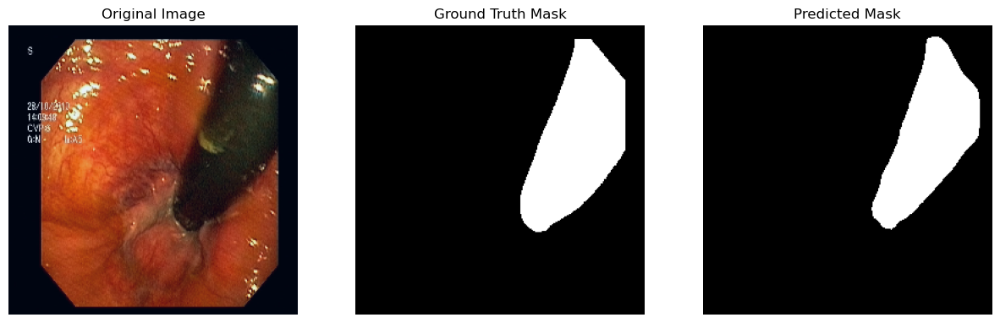

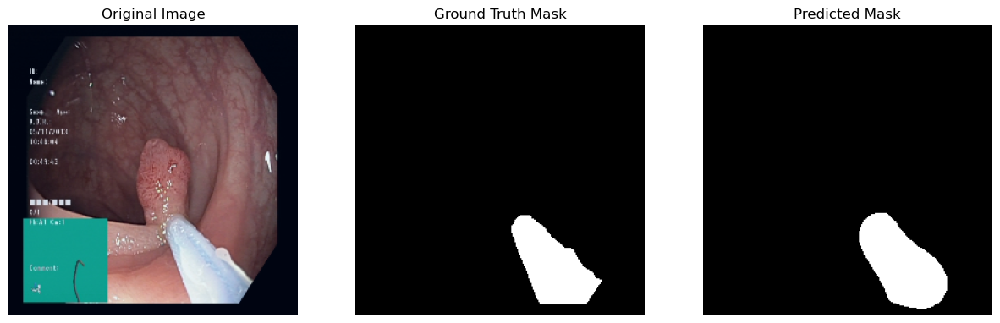

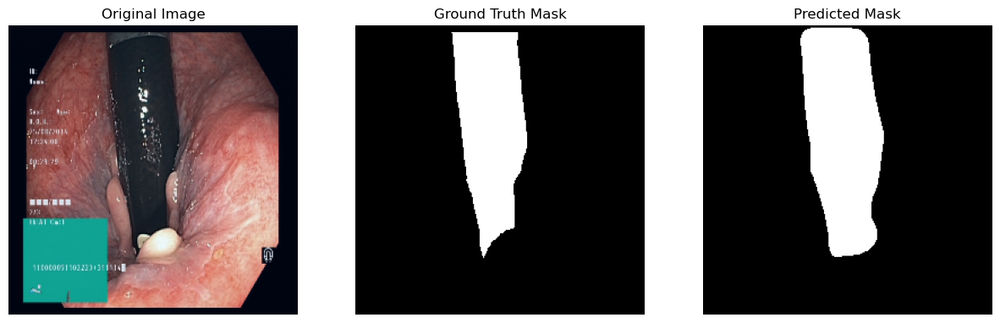

Current Learning Rate: 0.005
EarlyStopping counter: 3 out of 5
Epoch 11/60 - Training Loss: 0.1118 - Validation Loss: 0.1375 - Training Acc: 95.78% - Validation Acc: 94.29% - Training Dice: 0.7765 - Validation Dice: 0.7358 - Training IoU: 0.6415 - Validation IoU: 0.5889 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 12/60 - Training Loss: 0.0997 - Validation Loss: 0.0835 - Training Acc: 96.23% - Validation Acc: 97.03% - Training Dice: 0.8006 - Validation Dice: 0.8174 - Training IoU: 0.6739 - Validation IoU: 0.6946 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 13/60 - Training Loss: 0.1044 - Validation Loss: 0.0747 - Training Acc: 96.04% - Validation Acc: 97.31% - Training Dice: 0.7875 - Validation Dice: 0.8428 - Training IoU: 0.6564 - Validation IoU: 0.7323 


Current Learning Rate: 0.005
EarlyStopping counter: 1 out of 5
Epoch 14/60 - Training Loss: 0.1020 - Validation Loss: 0.0838 - Training Acc: 96.03% - Validation Acc: 96.79% - Training Dice: 0.7908 - Validation Dice: 0.8320 - Training IoU: 0.6589 - Validation IoU: 0.7167 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 15/60 - Training Loss: 0.1008 - Validation Loss: 0.0725 - Training Acc: 96.10% - Validation Acc: 97.26% - Training Dice: 0.7934 - Validation Dice: 0.8422 - Training IoU: 0.6636 - Validation IoU: 0.7319 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 16/60 - Training Loss: 0.0990 - Validation Loss: 0.0631 - Training Acc: 96.13% - Validation Acc: 97.81% - Training Dice: 0.7978 - Validation Dice: 0.8806 - Training IoU: 0.6717 - Validation IoU: 0.7886 


Current Learning Rate: 0.005
EarlyStopping counter: 1 out of 5
Epoch 17/60 - Training Loss: 0.0970 - Validation Loss: 0.0762 - Training Acc: 96.32% - Validation Acc: 97.20% - Training Dice: 0.8072 - Validation Dice: 0.8315 - Training IoU: 0.6856 - Validation IoU: 0.7156 


Current Learning Rate: 0.005
EarlyStopping counter: 2 out of 5
Epoch 18/60 - Training Loss: 0.0870 - Validation Loss: 0.0679 - Training Acc: 96.75% - Validation Acc: 97.43% - Training Dice: 0.8322 - Validation Dice: 0.8596 - Training IoU: 0.7172 - Validation IoU: 0.7571 


Current Learning Rate: 0.0025
EarlyStopping counter: 3 out of 5
Epoch 19/60 - Training Loss: 0.0957 - Validation Loss: 0.0735 - Training Acc: 96.38% - Validation Acc: 97.41% - Training Dice: 0.8085 - Validation Dice: 0.8491 - Training IoU: 0.6848 - Validation IoU: 0.7397 


Current Learning Rate: 0.0025
EarlyStopping counter: 0 out of 5
Epoch 20/60 - Training Loss: 0.0879 - Validation Loss: 0.0606 - Training Acc: 96.61% - Validation Acc: 97.92% - Training Dice: 0.8223 - Validation Dice: 0.8810 - Training IoU: 0.7047 - Validation IoU: 0.7898 


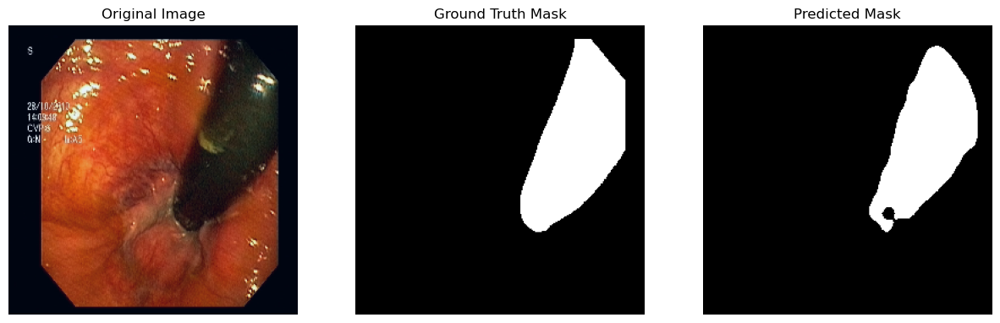

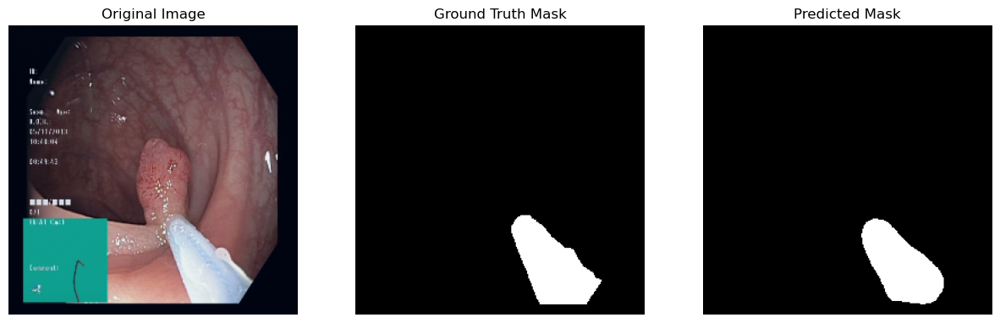

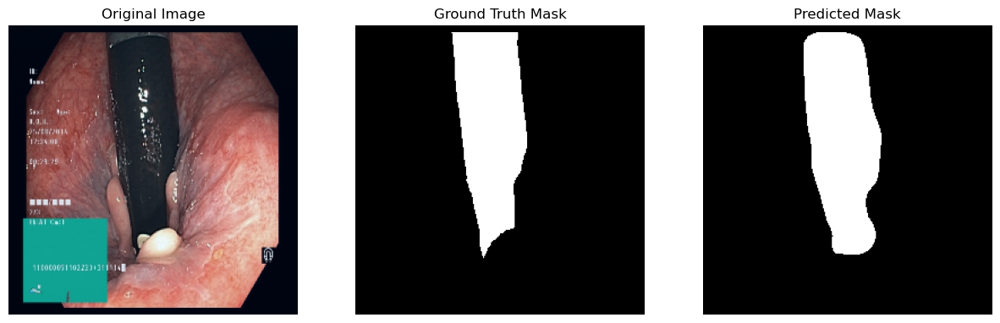

Current Learning Rate: 0.0025
EarlyStopping counter: 0 out of 5
Epoch 21/60 - Training Loss: 0.0860 - Validation Loss: 0.0587 - Training Acc: 96.72% - Validation Acc: 97.94% - Training Dice: 0.8285 - Validation Dice: 0.8885 - Training IoU: 0.7125 - Validation IoU: 0.8013 


Current Learning Rate: 0.0025
EarlyStopping counter: 1 out of 5
Epoch 22/60 - Training Loss: 0.0816 - Validation Loss: 0.0616 - Training Acc: 96.91% - Validation Acc: 97.83% - Training Dice: 0.8361 - Validation Dice: 0.8804 - Training IoU: 0.7262 - Validation IoU: 0.7898 


Current Learning Rate: 0.0025
EarlyStopping counter: 2 out of 5
Epoch 23/60 - Training Loss: 0.0819 - Validation Loss: 0.0607 - Training Acc: 96.89% - Validation Acc: 97.82% - Training Dice: 0.8398 - Validation Dice: 0.8821 - Training IoU: 0.7293 - Validation IoU: 0.7918 


Current Learning Rate: 0.0025
EarlyStopping counter: 0 out of 5
Epoch 24/60 - Training Loss: 0.0781 - Validation Loss: 0.0557 - Training Acc: 97.08% - Validation Acc: 98.04% - Training Dice: 0.8463 - Validation Dice: 0.8931 - Training IoU: 0.7386 - Validation IoU: 0.8092 


Current Learning Rate: 0.0025
EarlyStopping counter: 1 out of 5
Epoch 25/60 - Training Loss: 0.0768 - Validation Loss: 0.0588 - Training Acc: 97.12% - Validation Acc: 97.98% - Training Dice: 0.8496 - Validation Dice: 0.8881 - Training IoU: 0.7427 - Validation IoU: 0.8011 


Current Learning Rate: 0.0025
EarlyStopping counter: 0 out of 5
Epoch 26/60 - Training Loss: 0.0769 - Validation Loss: 0.0546 - Training Acc: 96.94% - Validation Acc: 98.08% - Training Dice: 0.8404 - Validation Dice: 0.8971 - Training IoU: 0.7285 - Validation IoU: 0.8152 


Current Learning Rate: 0.0025
EarlyStopping counter: 1 out of 5
Epoch 27/60 - Training Loss: 0.0731 - Validation Loss: 0.0617 - Training Acc: 97.30% - Validation Acc: 97.80% - Training Dice: 0.8574 - Validation Dice: 0.8710 - Training IoU: 0.7549 - Validation IoU: 0.7748 


Current Learning Rate: 0.0025
EarlyStopping counter: 2 out of 5
Epoch 28/60 - Training Loss: 0.0737 - Validation Loss: 0.0625 - Training Acc: 97.18% - Validation Acc: 97.71% - Training Dice: 0.8551 - Validation Dice: 0.8698 - Training IoU: 0.7513 - Validation IoU: 0.7744 


Current Learning Rate: 0.0025
EarlyStopping counter: 0 out of 5
Epoch 29/60 - Training Loss: 0.0743 - Validation Loss: 0.0535 - Training Acc: 97.10% - Validation Acc: 98.22% - Training Dice: 0.8490 - Validation Dice: 0.9011 - Training IoU: 0.7429 - Validation IoU: 0.8219 


Current Learning Rate: 0.0025
EarlyStopping counter: 1 out of 5
Epoch 30/60 - Training Loss: 0.0750 - Validation Loss: 0.0555 - Training Acc: 97.11% - Validation Acc: 98.05% - Training Dice: 0.8481 - Validation Dice: 0.8910 - Training IoU: 0.7425 - Validation IoU: 0.8059 


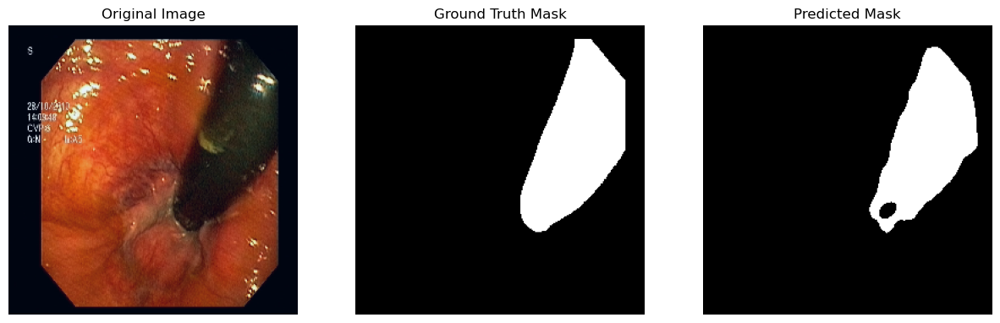

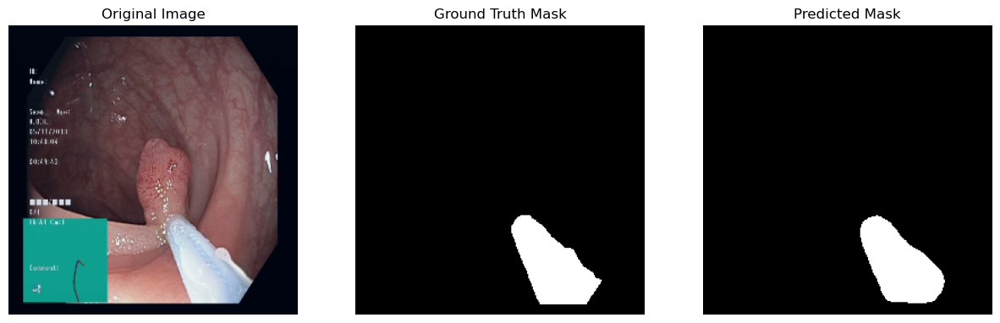

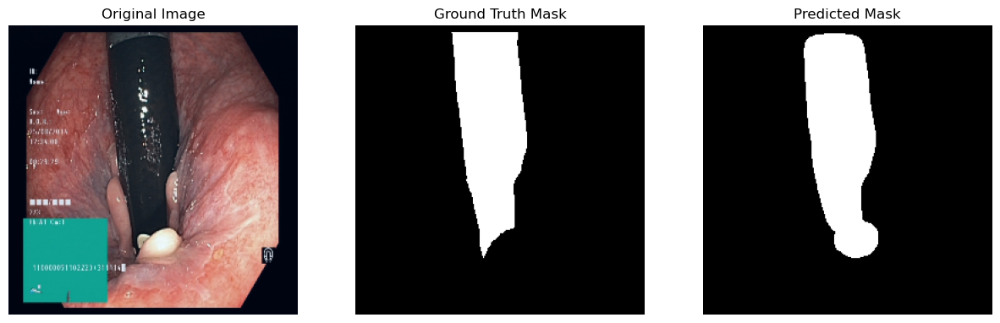

Current Learning Rate: 0.0025
EarlyStopping counter: 2 out of 5
Epoch 31/60 - Training Loss: 0.0728 - Validation Loss: 0.0603 - Training Acc: 97.29% - Validation Acc: 97.75% - Training Dice: 0.8589 - Validation Dice: 0.8816 - Training IoU: 0.7562 - Validation IoU: 0.7904 


Current Learning Rate: 0.00125
EarlyStopping counter: 3 out of 5
Epoch 32/60 - Training Loss: 0.0670 - Validation Loss: 0.0592 - Training Acc: 97.50% - Validation Acc: 97.96% - Training Dice: 0.8681 - Validation Dice: 0.8862 - Training IoU: 0.7706 - Validation IoU: 0.7980 


Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 33/60 - Training Loss: 0.0692 - Validation Loss: 0.0502 - Training Acc: 97.35% - Validation Acc: 98.31% - Training Dice: 0.8629 - Validation Dice: 0.9065 - Training IoU: 0.7643 - Validation IoU: 0.8306 


Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 34/60 - Training Loss: 0.0667 - Validation Loss: 0.0478 - Training Acc: 97.48% - Validation Acc: 98.29% - Training Dice: 0.8677 - Validation Dice: 0.9070 - Training IoU: 0.7720 - Validation IoU: 0.8317 


Current Learning Rate: 0.00125
EarlyStopping counter: 1 out of 5
Epoch 35/60 - Training Loss: 0.0628 - Validation Loss: 0.0497 - Training Acc: 97.70% - Validation Acc: 98.28% - Training Dice: 0.8810 - Validation Dice: 0.9058 - Training IoU: 0.7925 - Validation IoU: 0.8297 


Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 36/60 - Training Loss: 0.0620 - Validation Loss: 0.0473 - Training Acc: 97.69% - Validation Acc: 98.38% - Training Dice: 0.8811 - Validation Dice: 0.9114 - Training IoU: 0.7901 - Validation IoU: 0.8390 


Current Learning Rate: 0.00125
EarlyStopping counter: 1 out of 5
Epoch 37/60 - Training Loss: 0.0615 - Validation Loss: 0.0515 - Training Acc: 97.72% - Validation Acc: 98.21% - Training Dice: 0.8816 - Validation Dice: 0.9025 - Training IoU: 0.7911 - Validation IoU: 0.8244 


Current Learning Rate: 0.00125
EarlyStopping counter: 2 out of 5
Epoch 38/60 - Training Loss: 0.0595 - Validation Loss: 0.0493 - Training Acc: 97.76% - Validation Acc: 98.32% - Training Dice: 0.8828 - Validation Dice: 0.9049 - Training IoU: 0.7951 - Validation IoU: 0.8292 


Current Learning Rate: 0.000625
EarlyStopping counter: 3 out of 5
Epoch 39/60 - Training Loss: 0.0625 - Validation Loss: 0.0504 - Training Acc: 97.67% - Validation Acc: 98.38% - Training Dice: 0.8791 - Validation Dice: 0.9104 - Training IoU: 0.7878 - Validation IoU: 0.8369 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 40/60 - Training Loss: 0.0594 - Validation Loss: 0.0470 - Training Acc: 97.73% - Validation Acc: 98.41% - Training Dice: 0.8808 - Validation Dice: 0.9130 - Training IoU: 0.7911 - Validation IoU: 0.8414 


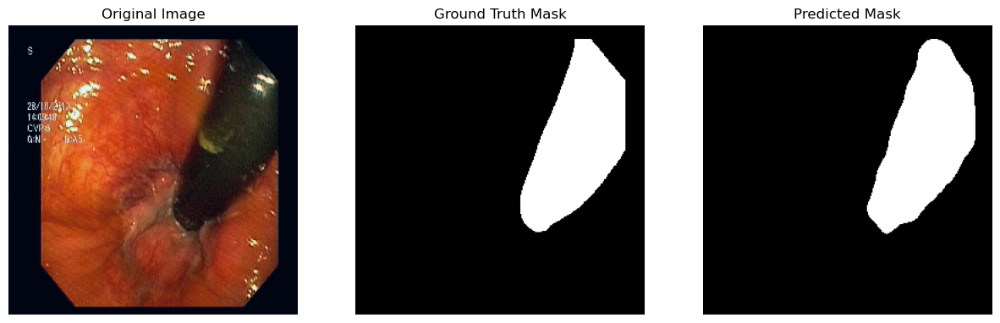

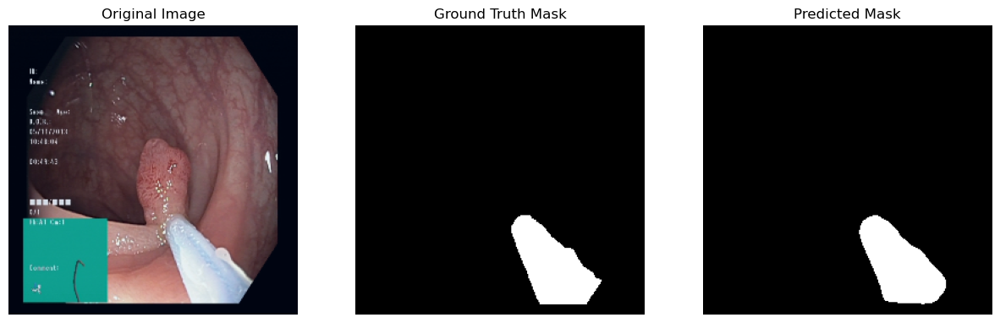

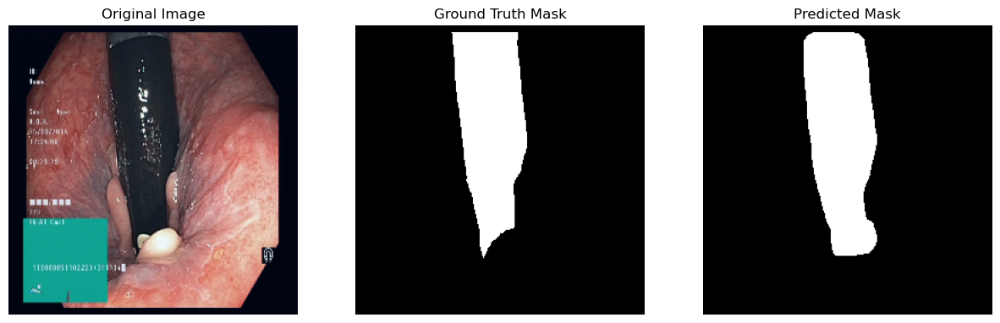

Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 41/60 - Training Loss: 0.0542 - Validation Loss: 0.0489 - Training Acc: 97.96% - Validation Acc: 98.32% - Training Dice: 0.8936 - Validation Dice: 0.9084 - Training IoU: 0.8107 - Validation IoU: 0.8343 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 42/60 - Training Loss: 0.0546 - Validation Loss: 0.0469 - Training Acc: 97.99% - Validation Acc: 98.33% - Training Dice: 0.8958 - Validation Dice: 0.9093 - Training IoU: 0.8136 - Validation IoU: 0.8355 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 43/60 - Training Loss: 0.0533 - Validation Loss: 0.0455 - Training Acc: 97.96% - Validation Acc: 98.33% - Training Dice: 0.8931 - Validation Dice: 0.9102 - Training IoU: 0.8100 - Validation IoU: 0.8368 


Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 44/60 - Training Loss: 0.0519 - Validation Loss: 0.0460 - Training Acc: 98.02% - Validation Acc: 98.47% - Training Dice: 0.8983 - Validation Dice: 0.9146 - Training IoU: 0.8181 - Validation IoU: 0.8443 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 45/60 - Training Loss: 0.0509 - Validation Loss: 0.0448 - Training Acc: 98.05% - Validation Acc: 98.41% - Training Dice: 0.8973 - Validation Dice: 0.9128 - Training IoU: 0.8165 - Validation IoU: 0.8411 


Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 46/60 - Training Loss: 0.0502 - Validation Loss: 0.0453 - Training Acc: 98.07% - Validation Acc: 98.46% - Training Dice: 0.9024 - Validation Dice: 0.9159 - Training IoU: 0.8237 - Validation IoU: 0.8465 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 47/60 - Training Loss: 0.0495 - Validation Loss: 0.0444 - Training Acc: 98.11% - Validation Acc: 98.48% - Training Dice: 0.9009 - Validation Dice: 0.9163 - Training IoU: 0.8221 - Validation IoU: 0.8472 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 48/60 - Training Loss: 0.0505 - Validation Loss: 0.0434 - Training Acc: 98.08% - Validation Acc: 98.50% - Training Dice: 0.9011 - Validation Dice: 0.9177 - Training IoU: 0.8225 - Validation IoU: 0.8493 


Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 49/60 - Training Loss: 0.0478 - Validation Loss: 0.0435 - Training Acc: 98.21% - Validation Acc: 98.51% - Training Dice: 0.9073 - Validation Dice: 0.9171 - Training IoU: 0.8319 - Validation IoU: 0.8485 


Current Learning Rate: 0.000625
EarlyStopping counter: 2 out of 5
Epoch 50/60 - Training Loss: 0.0497 - Validation Loss: 0.0498 - Training Acc: 98.17% - Validation Acc: 98.34% - Training Dice: 0.9019 - Validation Dice: 0.9070 - Training IoU: 0.8256 - Validation IoU: 0.8319 


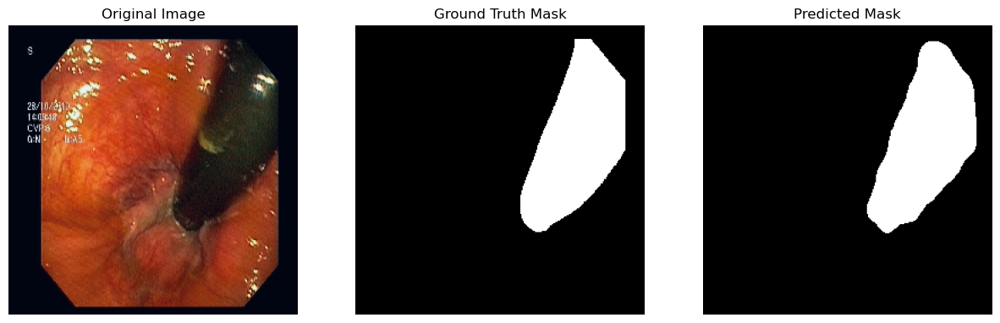

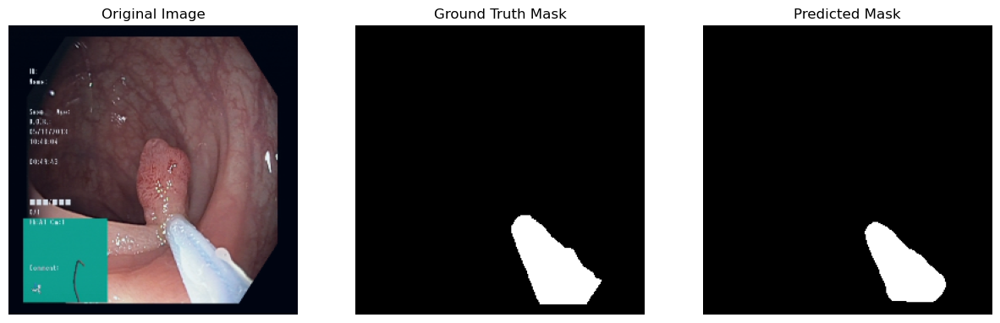

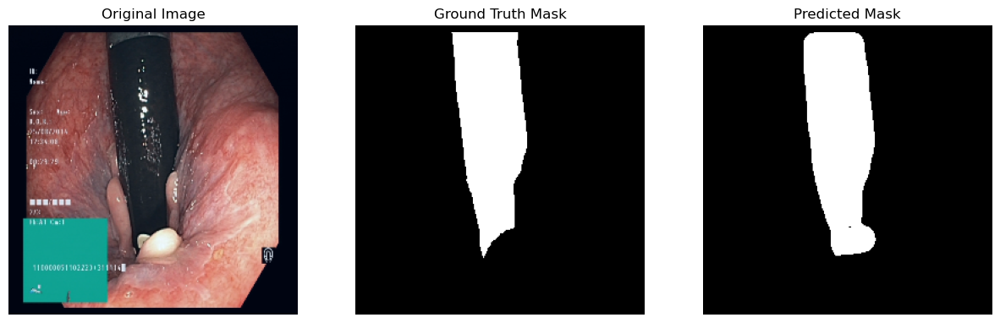

Current Learning Rate: 0.0003125
EarlyStopping counter: 3 out of 5
Epoch 51/60 - Training Loss: 0.0525 - Validation Loss: 0.0482 - Training Acc: 98.03% - Validation Acc: 98.42% - Training Dice: 0.8951 - Validation Dice: 0.9106 - Training IoU: 0.8150 - Validation IoU: 0.8377 


Current Learning Rate: 0.0003125
EarlyStopping counter: 4 out of 5
Epoch 52/60 - Training Loss: 0.0491 - Validation Loss: 0.0447 - Training Acc: 98.16% - Validation Acc: 98.54% - Training Dice: 0.9044 - Validation Dice: 0.9192 - Training IoU: 0.8273 - Validation IoU: 0.8518 


Current Learning Rate: 0.0003125
EarlyStopping counter: 0 out of 5
Epoch 53/60 - Training Loss: 0.0468 - Validation Loss: 0.0431 - Training Acc: 98.22% - Validation Acc: 98.54% - Training Dice: 0.9073 - Validation Dice: 0.9192 - Training IoU: 0.8342 - Validation IoU: 0.8520 


Current Learning Rate: 0.0003125
EarlyStopping counter: 1 out of 5
Epoch 54/60 - Training Loss: 0.0464 - Validation Loss: 0.0447 - Training Acc: 98.26% - Validation Acc: 98.43% - Training Dice: 0.9111 - Validation Dice: 0.9148 - Training IoU: 0.8388 - Validation IoU: 0.8449 


Current Learning Rate: 0.0003125
EarlyStopping counter: 0 out of 5
Epoch 55/60 - Training Loss: 0.0438 - Validation Loss: 0.0429 - Training Acc: 98.36% - Validation Acc: 98.54% - Training Dice: 0.9146 - Validation Dice: 0.9197 - Training IoU: 0.8446 - Validation IoU: 0.8531 


Current Learning Rate: 0.0003125
EarlyStopping counter: 1 out of 5
Epoch 56/60 - Training Loss: 0.0459 - Validation Loss: 0.0432 - Training Acc: 98.26% - Validation Acc: 98.53% - Training Dice: 0.9097 - Validation Dice: 0.9194 - Training IoU: 0.8368 - Validation IoU: 0.8525 


Current Learning Rate: 0.0003125
EarlyStopping counter: 0 out of 5
Epoch 57/60 - Training Loss: 0.0453 - Validation Loss: 0.0427 - Training Acc: 98.29% - Validation Acc: 98.51% - Training Dice: 0.9124 - Validation Dice: 0.9181 - Training IoU: 0.8410 - Validation IoU: 0.8504 


Current Learning Rate: 0.0003125
EarlyStopping counter: 1 out of 5
Epoch 58/60 - Training Loss: 0.0436 - Validation Loss: 0.0450 - Training Acc: 98.37% - Validation Acc: 98.47% - Training Dice: 0.9160 - Validation Dice: 0.9153 - Training IoU: 0.8470 - Validation IoU: 0.8456 


Current Learning Rate: 0.0003125
EarlyStopping counter: 0 out of 5
Epoch 59/60 - Training Loss: 0.0419 - Validation Loss: 0.0419 - Training Acc: 98.40% - Validation Acc: 98.53% - Training Dice: 0.9168 - Validation Dice: 0.9200 - Training IoU: 0.8481 - Validation IoU: 0.8536 


Current Learning Rate: 0.0003125
EarlyStopping counter: 1 out of 5
Epoch 60/60 - Training Loss: 0.0440 - Validation Loss: 0.0434 - Training Acc: 98.32% - Validation Acc: 98.46% - Training Dice: 0.9138 - Validation Dice: 0.9163 - Training IoU: 0.8436 - Validation IoU: 0.8476 


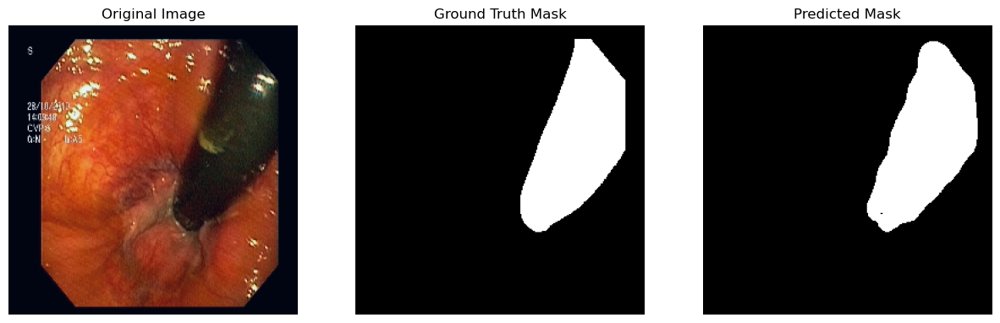

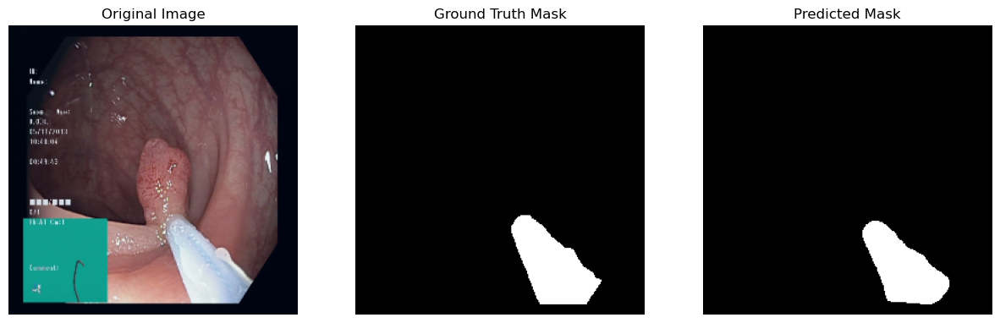

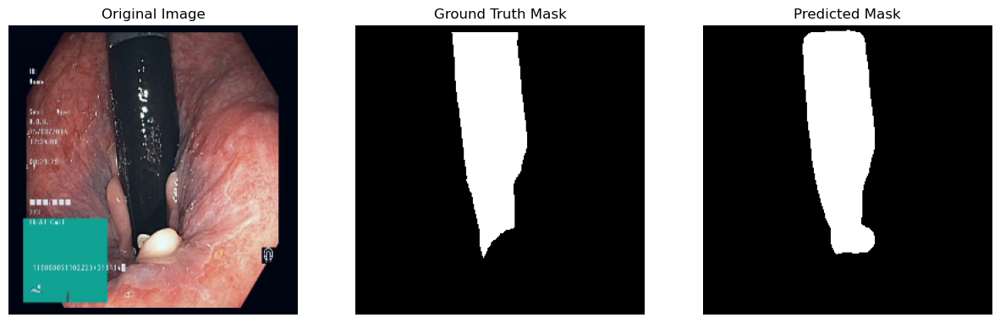

C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\Mike\AppData\Local\Temp\ipykernel_11792\279954375.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/p

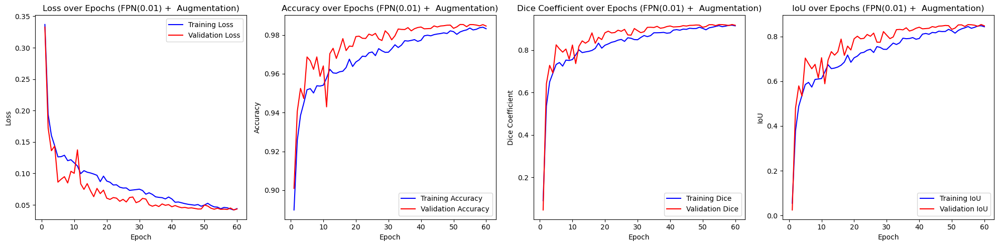

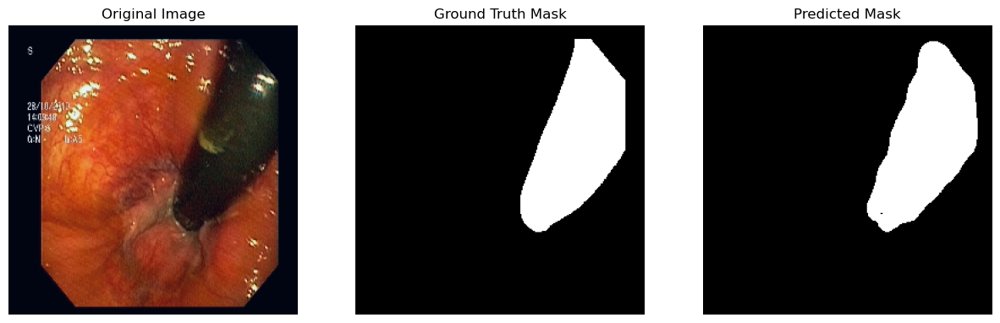

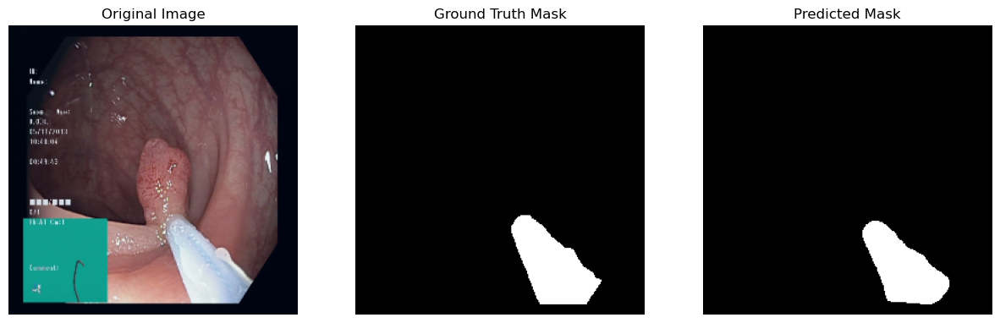

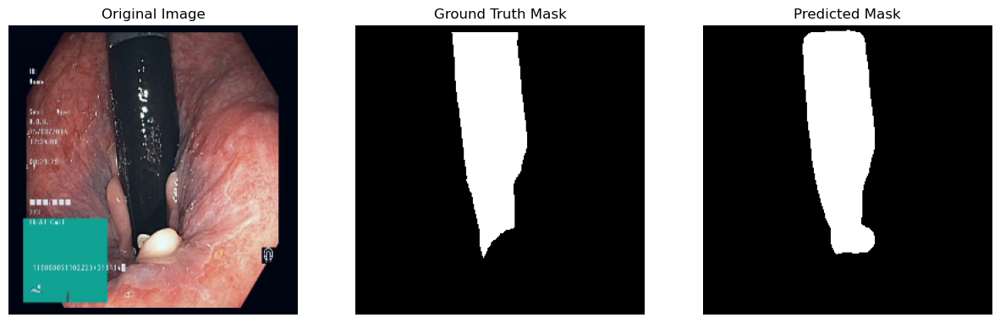

C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Running experiment: UNet++(0.01) + Augmentation


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 1/60 - Training Loss: 0.2729 - Validation Loss: 0.7021 - Training Acc: 89.31% - Validation Acc: 90.69% - Training Dice: 0.0052 - Validation Dice: 0.0015 - Training IoU: 0.0028 - Validation IoU: 0.0008 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 2/60 - Training Loss: 0.1832 - Validation Loss: 0.2056 - Training Acc: 91.90% - Validation Acc: 92.03% - Training Dice: 0.4138 - Validation Dice: 0.3754 - Training IoU: 0.2850 - Validation IoU: 0.2369 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 3/60 - Training Loss: 0.1704 - Validation Loss: 0.1505 - Training Acc: 93.05% - Validation Acc: 93.56% - Training Dice: 0.6240 - Validation Dice: 0.6982 - Training IoU: 0.4665 - Validation IoU: 0.5467 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 4/60 - Training Loss: 0.1555 - Validation Loss: 0.1317 - Training Acc: 93.64% - Validation Acc: 95.26% - Training Dice: 0.6717 - Validation Dice: 0.6822 - Training IoU: 0.5165 - Validation IoU: 0.5216 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 5/60 - Training Loss: 0.1488 - Validation Loss: 0.1222 - Training Acc: 94.07% - Validation Acc: 94.79% - Training Dice: 0.6904 - Validation Dice: 0.6949 - Training IoU: 0.5345 - Validation IoU: 0.5416 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 6/60 - Training Loss: 0.1428 - Validation Loss: 0.1102 - Training Acc: 94.32% - Validation Acc: 95.27% - Training Dice: 0.6971 - Validation Dice: 0.7517 - Training IoU: 0.5454 - Validation IoU: 0.6112 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 7/60 - Training Loss: 0.1269 - Validation Loss: 0.0865 - Training Acc: 94.95% - Validation Acc: 96.55% - Training Dice: 0.7358 - Validation Dice: 0.8157 - Training IoU: 0.5876 - Validation IoU: 0.6920 


Current Learning Rate: 0.01
EarlyStopping counter: 1 out of 5
Epoch 8/60 - Training Loss: 0.1228 - Validation Loss: 0.0877 - Training Acc: 95.21% - Validation Acc: 96.49% - Training Dice: 0.7496 - Validation Dice: 0.7959 - Training IoU: 0.6059 - Validation IoU: 0.6646 


Current Learning Rate: 0.01
EarlyStopping counter: 2 out of 5
Epoch 9/60 - Training Loss: 0.1188 - Validation Loss: 0.1144 - Training Acc: 95.21% - Validation Acc: 95.59% - Training Dice: 0.7408 - Validation Dice: 0.6973 - Training IoU: 0.5938 - Validation IoU: 0.5409 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 10/60 - Training Loss: 0.1138 - Validation Loss: 0.0806 - Training Acc: 95.54% - Validation Acc: 96.75% - Training Dice: 0.7620 - Validation Dice: 0.8272 - Training IoU: 0.6237 - Validation IoU: 0.7092 


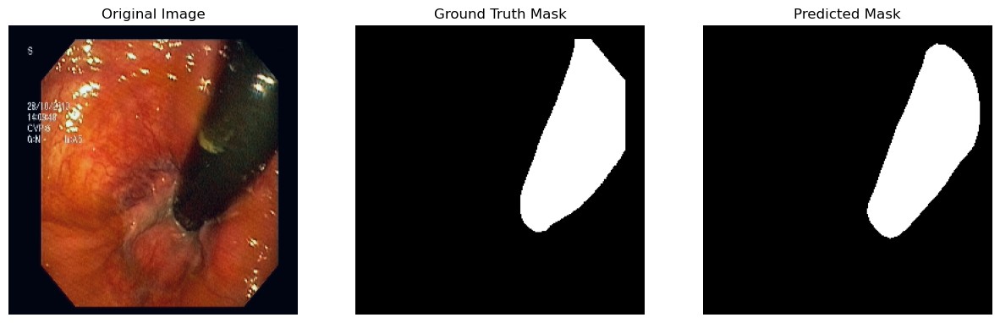

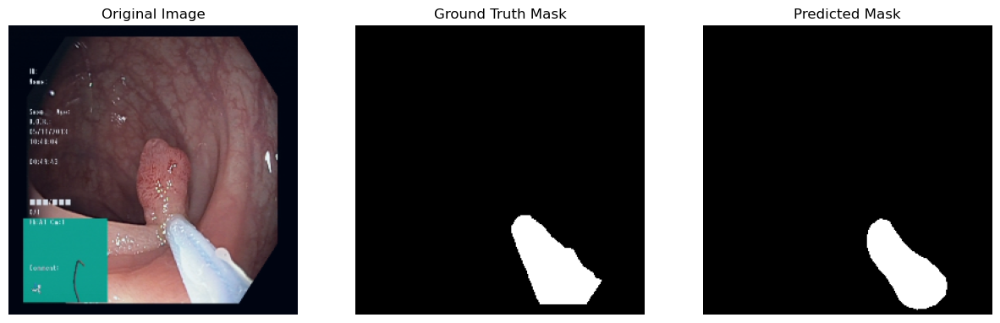

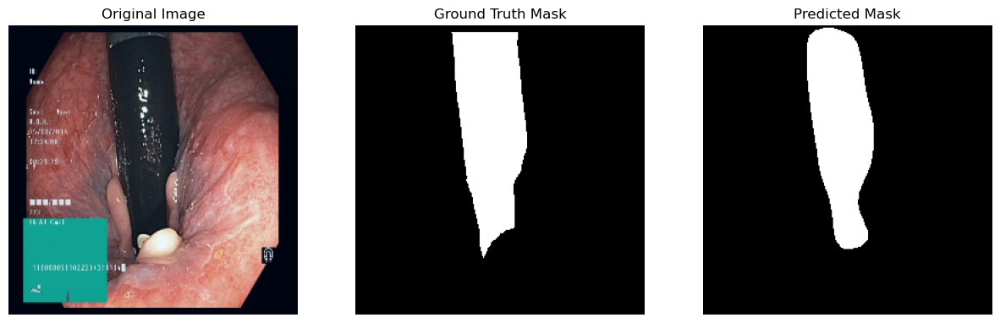

Current Learning Rate: 0.01
EarlyStopping counter: 1 out of 5
Epoch 11/60 - Training Loss: 0.1147 - Validation Loss: 0.1045 - Training Acc: 95.44% - Validation Acc: 95.63% - Training Dice: 0.7637 - Validation Dice: 0.7929 - Training IoU: 0.6236 - Validation IoU: 0.6620 


Current Learning Rate: 0.01
EarlyStopping counter: 2 out of 5
Epoch 12/60 - Training Loss: 0.1135 - Validation Loss: 0.1457 - Training Acc: 95.56% - Validation Acc: 93.59% - Training Dice: 0.7628 - Validation Dice: 0.6026 - Training IoU: 0.6229 - Validation IoU: 0.4358 


Current Learning Rate: 0.005
EarlyStopping counter: 3 out of 5
Epoch 13/60 - Training Loss: 0.1160 - Validation Loss: 0.1108 - Training Acc: 95.46% - Validation Acc: 95.51% - Training Dice: 0.7551 - Validation Dice: 0.7653 - Training IoU: 0.6147 - Validation IoU: 0.6242 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 14/60 - Training Loss: 0.0991 - Validation Loss: 0.0768 - Training Acc: 96.18% - Validation Acc: 97.05% - Training Dice: 0.7972 - Validation Dice: 0.8192 - Training IoU: 0.6694 - Validation IoU: 0.6962 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 15/60 - Training Loss: 0.0932 - Validation Loss: 0.0728 - Training Acc: 96.32% - Validation Acc: 97.25% - Training Dice: 0.8095 - Validation Dice: 0.8492 - Training IoU: 0.6844 - Validation IoU: 0.7406 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 16/60 - Training Loss: 0.0894 - Validation Loss: 0.0689 - Training Acc: 96.54% - Validation Acc: 97.28% - Training Dice: 0.8224 - Validation Dice: 0.8502 - Training IoU: 0.7024 - Validation IoU: 0.7416 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 17/60 - Training Loss: 0.0865 - Validation Loss: 0.0601 - Training Acc: 96.63% - Validation Acc: 97.81% - Training Dice: 0.8228 - Validation Dice: 0.8794 - Training IoU: 0.7048 - Validation IoU: 0.7858 


Current Learning Rate: 0.005
EarlyStopping counter: 1 out of 5
Epoch 18/60 - Training Loss: 0.0874 - Validation Loss: 0.0663 - Training Acc: 96.66% - Validation Acc: 97.44% - Training Dice: 0.8274 - Validation Dice: 0.8595 - Training IoU: 0.7120 - Validation IoU: 0.7559 


Current Learning Rate: 0.005
EarlyStopping counter: 2 out of 5
Epoch 19/60 - Training Loss: 0.0888 - Validation Loss: 0.0618 - Training Acc: 96.63% - Validation Acc: 97.64% - Training Dice: 0.8236 - Validation Dice: 0.8670 - Training IoU: 0.7049 - Validation IoU: 0.7672 


Current Learning Rate: 0.0025
EarlyStopping counter: 3 out of 5
Epoch 20/60 - Training Loss: 0.0872 - Validation Loss: 0.0754 - Training Acc: 96.69% - Validation Acc: 97.16% - Training Dice: 0.8268 - Validation Dice: 0.8519 - Training IoU: 0.7095 - Validation IoU: 0.7449 


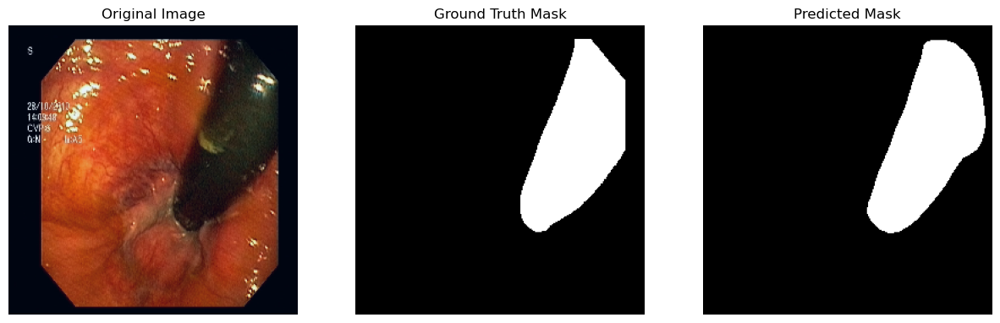

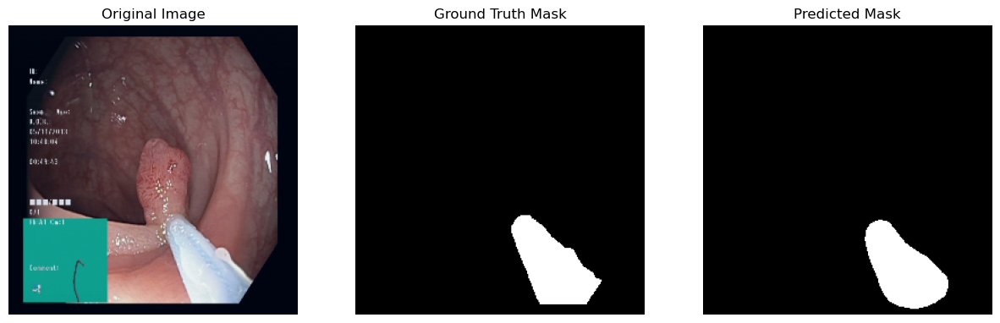

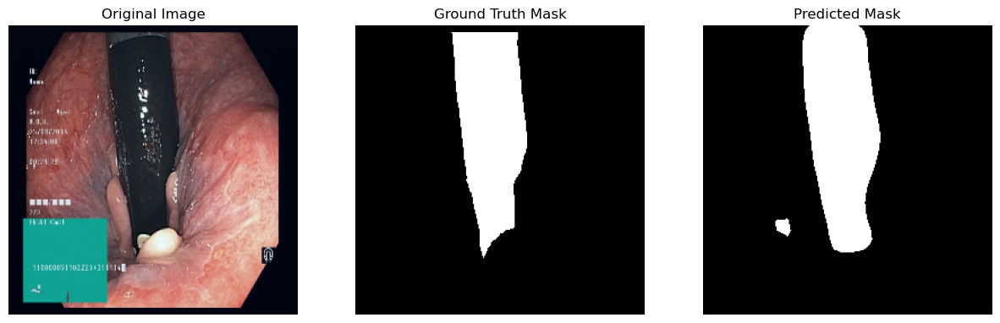

Current Learning Rate: 0.0025
EarlyStopping counter: 0 out of 5
Epoch 21/60 - Training Loss: 0.0825 - Validation Loss: 0.0542 - Training Acc: 96.86% - Validation Acc: 97.95% - Training Dice: 0.8331 - Validation Dice: 0.8870 - Training IoU: 0.7188 - Validation IoU: 0.7986 


Current Learning Rate: 0.0025
EarlyStopping counter: 1 out of 5
Epoch 22/60 - Training Loss: 0.0767 - Validation Loss: 0.0545 - Training Acc: 97.08% - Validation Acc: 97.97% - Training Dice: 0.8470 - Validation Dice: 0.8904 - Training IoU: 0.7400 - Validation IoU: 0.8041 


Current Learning Rate: 0.0025
EarlyStopping counter: 2 out of 5
Epoch 23/60 - Training Loss: 0.0807 - Validation Loss: 0.0603 - Training Acc: 96.94% - Validation Acc: 97.77% - Training Dice: 0.8380 - Validation Dice: 0.8772 - Training IoU: 0.7267 - Validation IoU: 0.7834 


Current Learning Rate: 0.00125
EarlyStopping counter: 3 out of 5
Epoch 24/60 - Training Loss: 0.0753 - Validation Loss: 0.0561 - Training Acc: 97.13% - Validation Acc: 97.88% - Training Dice: 0.8487 - Validation Dice: 0.8789 - Training IoU: 0.7427 - Validation IoU: 0.7862 


Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 25/60 - Training Loss: 0.0688 - Validation Loss: 0.0526 - Training Acc: 97.32% - Validation Acc: 98.05% - Training Dice: 0.8573 - Validation Dice: 0.8918 - Training IoU: 0.7555 - Validation IoU: 0.8066 


Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 26/60 - Training Loss: 0.0697 - Validation Loss: 0.0496 - Training Acc: 97.29% - Validation Acc: 98.13% - Training Dice: 0.8560 - Validation Dice: 0.8975 - Training IoU: 0.7534 - Validation IoU: 0.8156 


Current Learning Rate: 0.00125
EarlyStopping counter: 1 out of 5
Epoch 27/60 - Training Loss: 0.0670 - Validation Loss: 0.0521 - Training Acc: 97.37% - Validation Acc: 98.01% - Training Dice: 0.8626 - Validation Dice: 0.8890 - Training IoU: 0.7623 - Validation IoU: 0.8023 


Current Learning Rate: 0.00125
EarlyStopping counter: 2 out of 5
Epoch 28/60 - Training Loss: 0.0681 - Validation Loss: 0.0504 - Training Acc: 97.36% - Validation Acc: 98.11% - Training Dice: 0.8628 - Validation Dice: 0.8945 - Training IoU: 0.7628 - Validation IoU: 0.8105 


Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 29/60 - Training Loss: 0.0678 - Validation Loss: 0.0488 - Training Acc: 97.41% - Validation Acc: 98.19% - Training Dice: 0.8641 - Validation Dice: 0.8988 - Training IoU: 0.7646 - Validation IoU: 0.8175 


Current Learning Rate: 0.00125
EarlyStopping counter: 1 out of 5
Epoch 30/60 - Training Loss: 0.0665 - Validation Loss: 0.0516 - Training Acc: 97.48% - Validation Acc: 98.03% - Training Dice: 0.8677 - Validation Dice: 0.8932 - Training IoU: 0.7699 - Validation IoU: 0.8094 


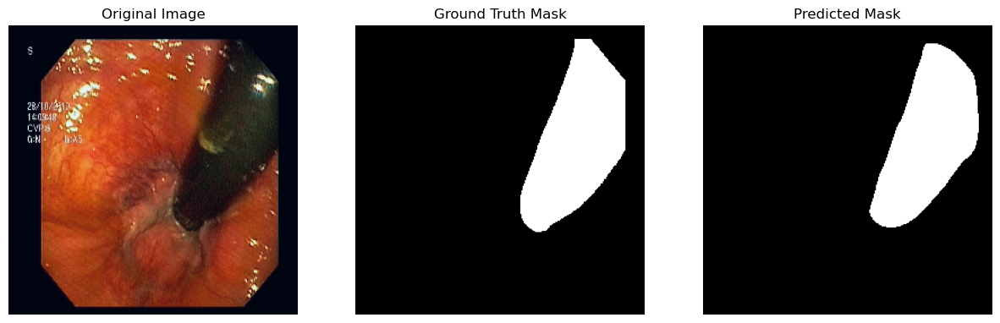

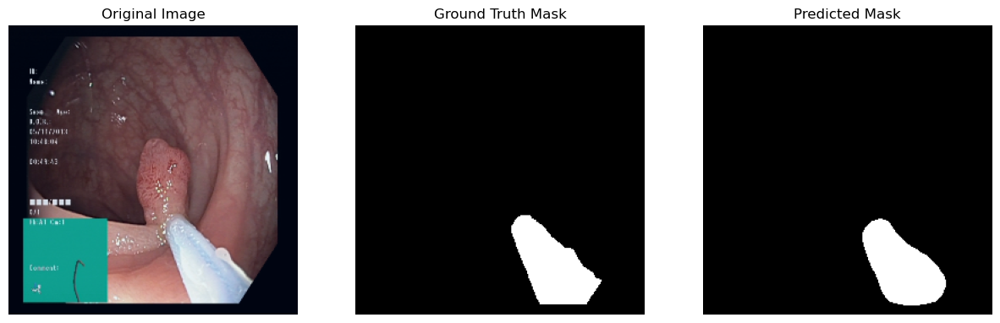

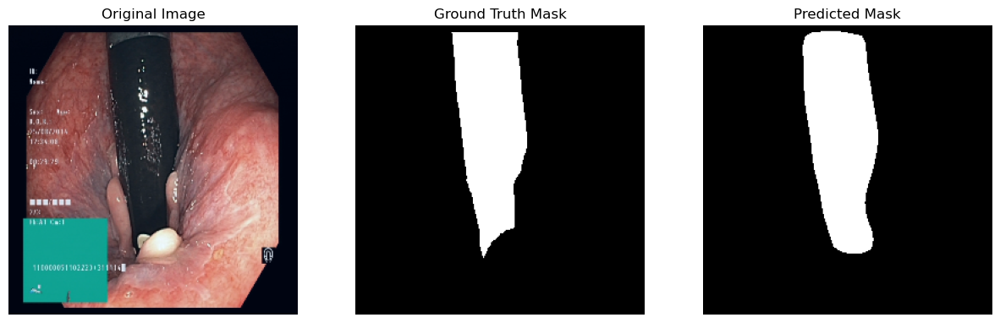

Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 31/60 - Training Loss: 0.0668 - Validation Loss: 0.0466 - Training Acc: 97.44% - Validation Acc: 98.27% - Training Dice: 0.8641 - Validation Dice: 0.9041 - Training IoU: 0.7667 - Validation IoU: 0.8264 


Current Learning Rate: 0.00125
EarlyStopping counter: 1 out of 5
Epoch 32/60 - Training Loss: 0.0642 - Validation Loss: 0.0468 - Training Acc: 97.55% - Validation Acc: 98.25% - Training Dice: 0.8740 - Validation Dice: 0.9032 - Training IoU: 0.7792 - Validation IoU: 0.8254 


Current Learning Rate: 0.00125
EarlyStopping counter: 2 out of 5
Epoch 33/60 - Training Loss: 0.0657 - Validation Loss: 0.0516 - Training Acc: 97.51% - Validation Acc: 98.12% - Training Dice: 0.8643 - Validation Dice: 0.8949 - Training IoU: 0.7686 - Validation IoU: 0.8106 


Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 34/60 - Training Loss: 0.0613 - Validation Loss: 0.0453 - Training Acc: 97.63% - Validation Acc: 98.31% - Training Dice: 0.8778 - Validation Dice: 0.9066 - Training IoU: 0.7849 - Validation IoU: 0.8308 


Current Learning Rate: 0.00125
EarlyStopping counter: 1 out of 5
Epoch 35/60 - Training Loss: 0.0587 - Validation Loss: 0.0468 - Training Acc: 97.72% - Validation Acc: 98.22% - Training Dice: 0.8805 - Validation Dice: 0.9023 - Training IoU: 0.7901 - Validation IoU: 0.8242 


Current Learning Rate: 0.00125
EarlyStopping counter: 2 out of 5
Epoch 36/60 - Training Loss: 0.0660 - Validation Loss: 0.0462 - Training Acc: 97.52% - Validation Acc: 98.24% - Training Dice: 0.8725 - Validation Dice: 0.9012 - Training IoU: 0.7783 - Validation IoU: 0.8219 


Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 37/60 - Training Loss: 0.0600 - Validation Loss: 0.0438 - Training Acc: 97.66% - Validation Acc: 98.35% - Training Dice: 0.8759 - Validation Dice: 0.9085 - Training IoU: 0.7827 - Validation IoU: 0.8339 


Current Learning Rate: 0.00125
EarlyStopping counter: 1 out of 5
Epoch 38/60 - Training Loss: 0.0585 - Validation Loss: 0.0442 - Training Acc: 97.78% - Validation Acc: 98.31% - Training Dice: 0.8844 - Validation Dice: 0.9055 - Training IoU: 0.7958 - Validation IoU: 0.8289 


Current Learning Rate: 0.00125
EarlyStopping counter: 2 out of 5
Epoch 39/60 - Training Loss: 0.0608 - Validation Loss: 0.0545 - Training Acc: 97.66% - Validation Acc: 98.04% - Training Dice: 0.8757 - Validation Dice: 0.8950 - Training IoU: 0.7821 - Validation IoU: 0.8123 


Current Learning Rate: 0.000625
EarlyStopping counter: 3 out of 5
Epoch 40/60 - Training Loss: 0.0585 - Validation Loss: 0.0454 - Training Acc: 97.79% - Validation Acc: 98.27% - Training Dice: 0.8865 - Validation Dice: 0.9037 - Training IoU: 0.7994 - Validation IoU: 0.8266 


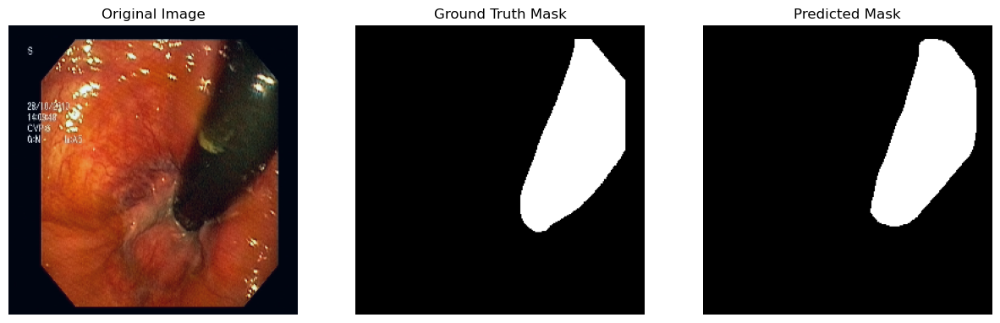

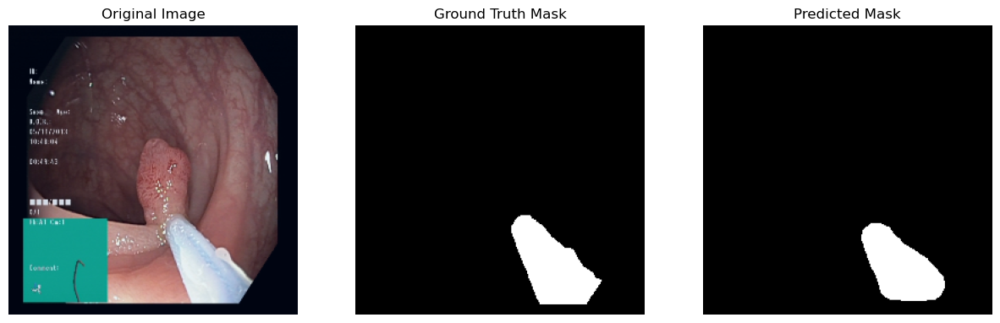

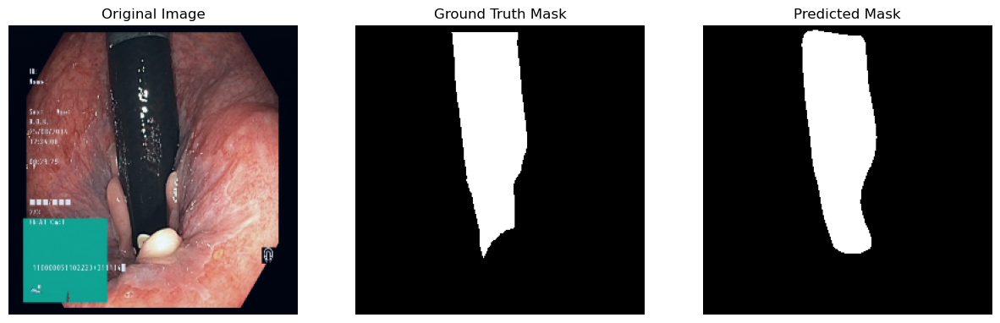

Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 41/60 - Training Loss: 0.0560 - Validation Loss: 0.0416 - Training Acc: 97.85% - Validation Acc: 98.43% - Training Dice: 0.8893 - Validation Dice: 0.9135 - Training IoU: 0.8031 - Validation IoU: 0.8425 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 42/60 - Training Loss: 0.0534 - Validation Loss: 0.0415 - Training Acc: 97.95% - Validation Acc: 98.42% - Training Dice: 0.8932 - Validation Dice: 0.9127 - Training IoU: 0.8096 - Validation IoU: 0.8412 


Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 43/60 - Training Loss: 0.0557 - Validation Loss: 0.0417 - Training Acc: 97.84% - Validation Acc: 98.41% - Training Dice: 0.8884 - Validation Dice: 0.9105 - Training IoU: 0.8028 - Validation IoU: 0.8373 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 44/60 - Training Loss: 0.0543 - Validation Loss: 0.0410 - Training Acc: 97.90% - Validation Acc: 98.45% - Training Dice: 0.8910 - Validation Dice: 0.9141 - Training IoU: 0.8063 - Validation IoU: 0.8435 


Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 45/60 - Training Loss: 0.0538 - Validation Loss: 0.0425 - Training Acc: 97.99% - Validation Acc: 98.37% - Training Dice: 0.8970 - Validation Dice: 0.9095 - Training IoU: 0.8153 - Validation IoU: 0.8360 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 46/60 - Training Loss: 0.0526 - Validation Loss: 0.0401 - Training Acc: 97.99% - Validation Acc: 98.46% - Training Dice: 0.8972 - Validation Dice: 0.9142 - Training IoU: 0.8160 - Validation IoU: 0.8436 


Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 47/60 - Training Loss: 0.0510 - Validation Loss: 0.0412 - Training Acc: 98.04% - Validation Acc: 98.45% - Training Dice: 0.8973 - Validation Dice: 0.9145 - Training IoU: 0.8167 - Validation IoU: 0.8445 


Current Learning Rate: 0.000625
EarlyStopping counter: 2 out of 5
Epoch 48/60 - Training Loss: 0.0525 - Validation Loss: 0.0413 - Training Acc: 98.03% - Validation Acc: 98.43% - Training Dice: 0.8996 - Validation Dice: 0.9116 - Training IoU: 0.8194 - Validation IoU: 0.8398 


Current Learning Rate: 0.0003125
EarlyStopping counter: 3 out of 5
Epoch 49/60 - Training Loss: 0.0503 - Validation Loss: 0.0437 - Training Acc: 98.08% - Validation Acc: 98.31% - Training Dice: 0.9003 - Validation Dice: 0.9077 - Training IoU: 0.8211 - Validation IoU: 0.8335 


Current Learning Rate: 0.0003125
EarlyStopping counter: 0 out of 5
Epoch 50/60 - Training Loss: 0.0479 - Validation Loss: 0.0392 - Training Acc: 98.16% - Validation Acc: 98.49% - Training Dice: 0.9036 - Validation Dice: 0.9162 - Training IoU: 0.8267 - Validation IoU: 0.8470 


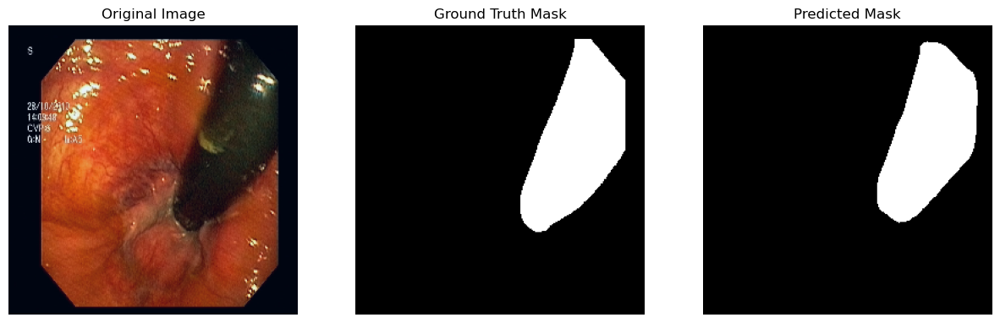

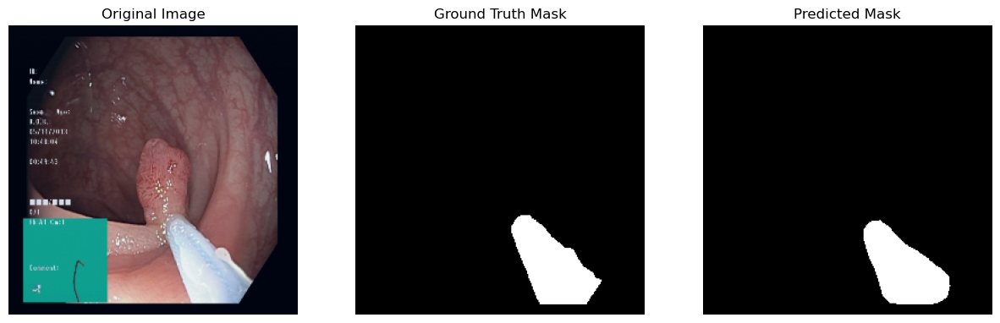

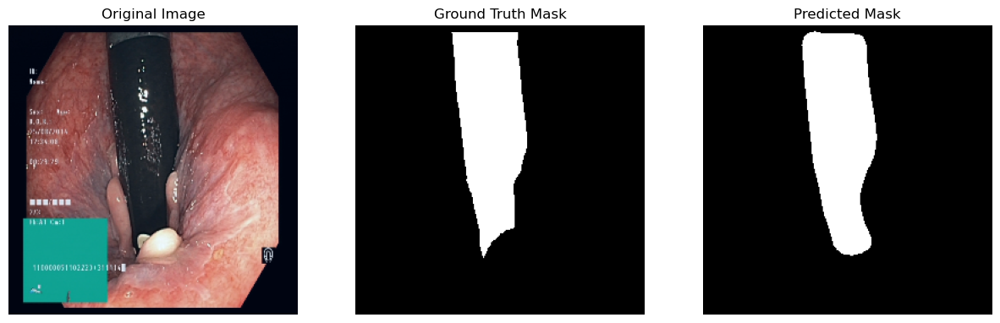

Current Learning Rate: 0.0003125
EarlyStopping counter: 0 out of 5
Epoch 51/60 - Training Loss: 0.0473 - Validation Loss: 0.0378 - Training Acc: 98.16% - Validation Acc: 98.55% - Training Dice: 0.9026 - Validation Dice: 0.9190 - Training IoU: 0.8259 - Validation IoU: 0.8519 


Current Learning Rate: 0.0003125
EarlyStopping counter: 1 out of 5
Epoch 52/60 - Training Loss: 0.0501 - Validation Loss: 0.0385 - Training Acc: 98.03% - Validation Acc: 98.56% - Training Dice: 0.8957 - Validation Dice: 0.9208 - Training IoU: 0.8154 - Validation IoU: 0.8547 


Current Learning Rate: 0.0003125
EarlyStopping counter: 2 out of 5
Epoch 53/60 - Training Loss: 0.0468 - Validation Loss: 0.0384 - Training Acc: 98.21% - Validation Acc: 98.59% - Training Dice: 0.9065 - Validation Dice: 0.9217 - Training IoU: 0.8311 - Validation IoU: 0.8561 


Current Learning Rate: 0.00015625
EarlyStopping counter: 3 out of 5
Epoch 54/60 - Training Loss: 0.0482 - Validation Loss: 0.0394 - Training Acc: 98.16% - Validation Acc: 98.51% - Training Dice: 0.9043 - Validation Dice: 0.9163 - Training IoU: 0.8274 - Validation IoU: 0.8473 


Current Learning Rate: 0.00015625
EarlyStopping counter: 4 out of 5
Epoch 55/60 - Training Loss: 0.0475 - Validation Loss: 0.0387 - Training Acc: 98.18% - Validation Acc: 98.56% - Training Dice: 0.9067 - Validation Dice: 0.9198 - Training IoU: 0.8315 - Validation IoU: 0.8531 


C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\Mike\AppData\Local\Temp\ipykernel_11792\279954375.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/p

Current Learning Rate: 0.00015625
EarlyStopping counter: 5 out of 5
Early stopping at epoch 56


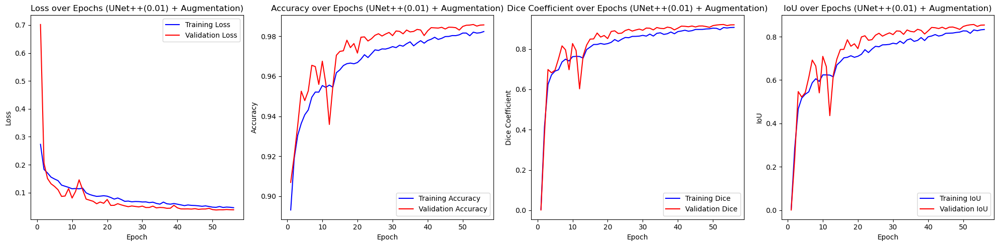

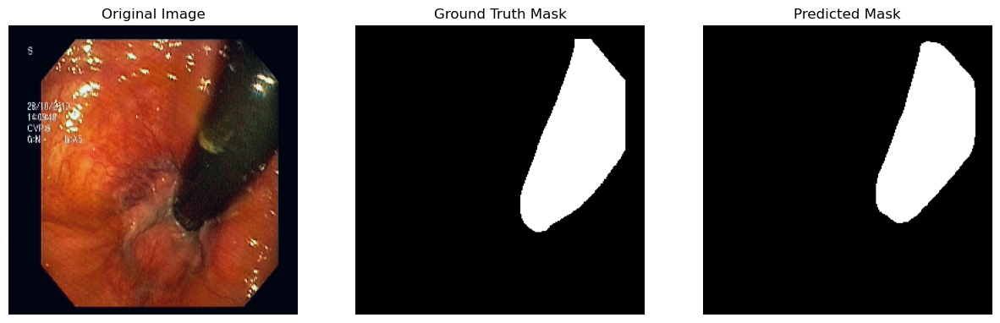

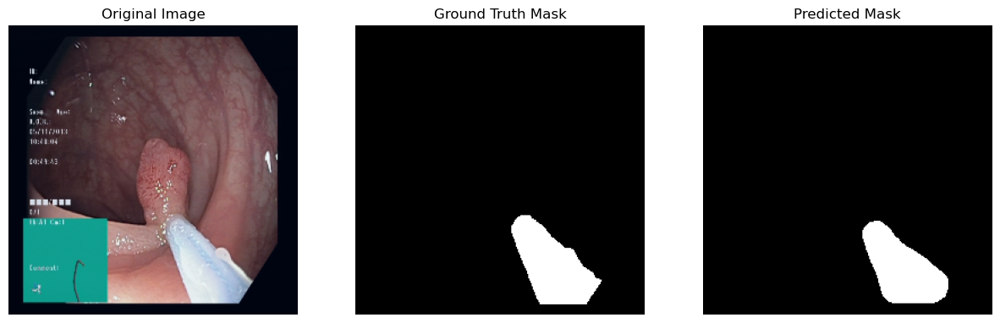

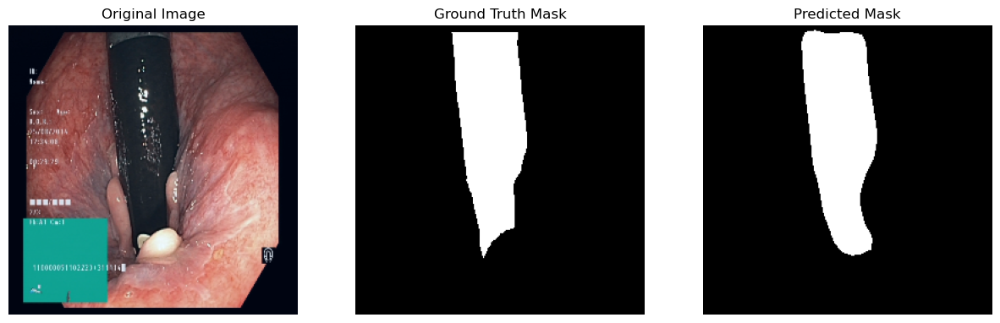


Running experiment: UNet(0.01) + Augmentation


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 1/60 - Training Loss: 0.2531 - Validation Loss: 0.6617 - Training Acc: 89.74% - Validation Acc: 84.21% - Training Dice: 0.1295 - Validation Dice: 0.2928 - Training IoU: 0.0903 - Validation IoU: 0.1753 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 2/60 - Training Loss: 0.1673 - Validation Loss: 0.2141 - Training Acc: 93.14% - Validation Acc: 90.20% - Training Dice: 0.6155 - Validation Dice: 0.6198 - Training IoU: 0.4524 - Validation IoU: 0.4569 


Current Learning Rate: 0.01
EarlyStopping counter: 1 out of 5
Epoch 3/60 - Training Loss: 0.1736 - Validation Loss: 0.2762 - Training Acc: 93.05% - Validation Acc: 93.82% - Training Dice: 0.5888 - Validation Dice: 0.6040 - Training IoU: 0.4331 - Validation IoU: 0.4421 


Current Learning Rate: 0.01
EarlyStopping counter: 0 out of 5
Epoch 4/60 - Training Loss: 0.1563 - Validation Loss: 0.1080 - Training Acc: 93.72% - Validation Acc: 95.74% - Training Dice: 0.6628 - Validation Dice: 0.7283 - Training IoU: 0.5029 - Validation IoU: 0.5767 


Current Learning Rate: 0.01
EarlyStopping counter: 1 out of 5
Epoch 5/60 - Training Loss: 0.1553 - Validation Loss: 0.1568 - Training Acc: 93.71% - Validation Acc: 93.15% - Training Dice: 0.6565 - Validation Dice: 0.6909 - Training IoU: 0.4988 - Validation IoU: 0.5348 


Current Learning Rate: 0.01
EarlyStopping counter: 2 out of 5
Epoch 6/60 - Training Loss: 0.1430 - Validation Loss: 0.1516 - Training Acc: 94.37% - Validation Acc: 93.62% - Training Dice: 0.6919 - Validation Dice: 0.6800 - Training IoU: 0.5377 - Validation IoU: 0.5248 


Current Learning Rate: 0.005
EarlyStopping counter: 3 out of 5
Epoch 7/60 - Training Loss: 0.1381 - Validation Loss: 0.1335 - Training Acc: 94.62% - Validation Acc: 94.78% - Training Dice: 0.7051 - Validation Dice: 0.5984 - Training IoU: 0.5530 - Validation IoU: 0.4361 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 8/60 - Training Loss: 0.1260 - Validation Loss: 0.0993 - Training Acc: 95.03% - Validation Acc: 96.02% - Training Dice: 0.7310 - Validation Dice: 0.7814 - Training IoU: 0.5845 - Validation IoU: 0.6467 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 9/60 - Training Loss: 0.1218 - Validation Loss: 0.0930 - Training Acc: 95.33% - Validation Acc: 96.48% - Training Dice: 0.7507 - Validation Dice: 0.8171 - Training IoU: 0.6085 - Validation IoU: 0.6947 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 10/60 - Training Loss: 0.1179 - Validation Loss: 0.0835 - Training Acc: 95.39% - Validation Acc: 96.85% - Training Dice: 0.7536 - Validation Dice: 0.8032 - Training IoU: 0.6131 - Validation IoU: 0.6738 


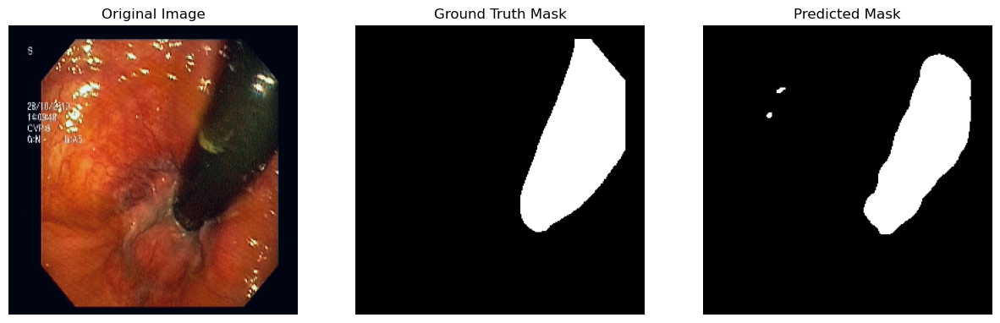

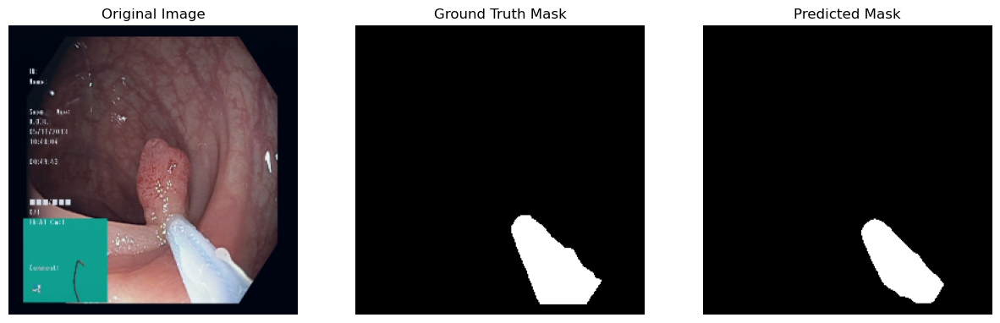

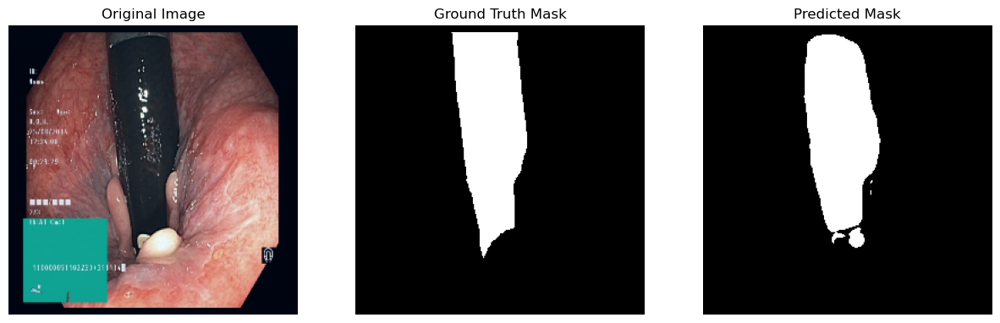

Current Learning Rate: 0.005
EarlyStopping counter: 1 out of 5
Epoch 11/60 - Training Loss: 0.1158 - Validation Loss: 0.0991 - Training Acc: 95.46% - Validation Acc: 96.32% - Training Dice: 0.7623 - Validation Dice: 0.8100 - Training IoU: 0.6245 - Validation IoU: 0.6840 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 12/60 - Training Loss: 0.1147 - Validation Loss: 0.0760 - Training Acc: 95.57% - Validation Acc: 97.11% - Training Dice: 0.7654 - Validation Dice: 0.8389 - Training IoU: 0.6259 - Validation IoU: 0.7254 


Current Learning Rate: 0.005
EarlyStopping counter: 1 out of 5
Epoch 13/60 - Training Loss: 0.1108 - Validation Loss: 0.0816 - Training Acc: 95.67% - Validation Acc: 97.05% - Training Dice: 0.7694 - Validation Dice: 0.8252 - Training IoU: 0.6327 - Validation IoU: 0.7043 


Current Learning Rate: 0.005
EarlyStopping counter: 2 out of 5
Epoch 14/60 - Training Loss: 0.1169 - Validation Loss: 0.0772 - Training Acc: 95.47% - Validation Acc: 97.27% - Training Dice: 0.7601 - Validation Dice: 0.8513 - Training IoU: 0.6231 - Validation IoU: 0.7436 


Current Learning Rate: 0.005
EarlyStopping counter: 0 out of 5
Epoch 15/60 - Training Loss: 0.1069 - Validation Loss: 0.0743 - Training Acc: 95.85% - Validation Acc: 97.30% - Training Dice: 0.7811 - Validation Dice: 0.8561 - Training IoU: 0.6467 - Validation IoU: 0.7506 


Current Learning Rate: 0.005
EarlyStopping counter: 1 out of 5
Epoch 16/60 - Training Loss: 0.1129 - Validation Loss: 0.0863 - Training Acc: 95.58% - Validation Acc: 96.82% - Training Dice: 0.7696 - Validation Dice: 0.8286 - Training IoU: 0.6318 - Validation IoU: 0.7104 


Current Learning Rate: 0.005
EarlyStopping counter: 2 out of 5
Epoch 17/60 - Training Loss: 0.1129 - Validation Loss: 0.0933 - Training Acc: 95.58% - Validation Acc: 96.30% - Training Dice: 0.7719 - Validation Dice: 0.8057 - Training IoU: 0.6338 - Validation IoU: 0.6800 


Current Learning Rate: 0.0025
EarlyStopping counter: 3 out of 5
Epoch 18/60 - Training Loss: 0.1080 - Validation Loss: 0.0809 - Training Acc: 95.85% - Validation Acc: 96.92% - Training Dice: 0.7835 - Validation Dice: 0.8344 - Training IoU: 0.6516 - Validation IoU: 0.7192 


Current Learning Rate: 0.0025
EarlyStopping counter: 0 out of 5
Epoch 19/60 - Training Loss: 0.1035 - Validation Loss: 0.0653 - Training Acc: 95.93% - Validation Acc: 97.65% - Training Dice: 0.7875 - Validation Dice: 0.8703 - Training IoU: 0.6570 - Validation IoU: 0.7724 


Current Learning Rate: 0.0025
EarlyStopping counter: 1 out of 5
Epoch 20/60 - Training Loss: 0.1012 - Validation Loss: 0.0718 - Training Acc: 96.17% - Validation Acc: 97.36% - Training Dice: 0.7980 - Validation Dice: 0.8601 - Training IoU: 0.6719 - Validation IoU: 0.7579 


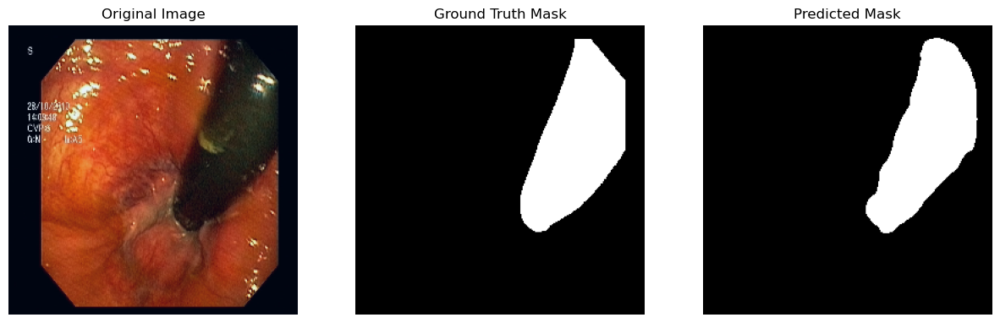

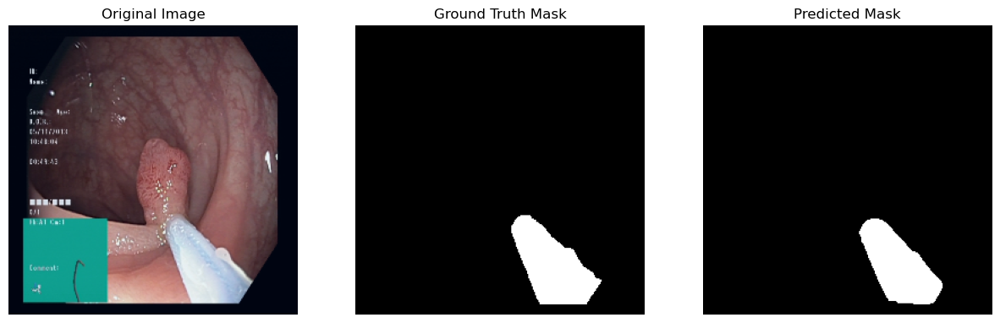

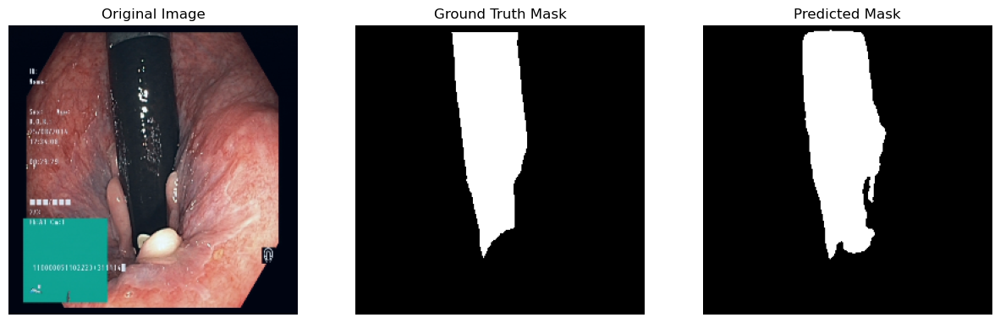

Current Learning Rate: 0.0025
EarlyStopping counter: 2 out of 5
Epoch 21/60 - Training Loss: 0.1031 - Validation Loss: 0.0674 - Training Acc: 96.03% - Validation Acc: 97.62% - Training Dice: 0.7949 - Validation Dice: 0.8677 - Training IoU: 0.6681 - Validation IoU: 0.7681 


Current Learning Rate: 0.00125
EarlyStopping counter: 3 out of 5
Epoch 22/60 - Training Loss: 0.0982 - Validation Loss: 0.0773 - Training Acc: 96.11% - Validation Acc: 97.18% - Training Dice: 0.8007 - Validation Dice: 0.8299 - Training IoU: 0.6725 - Validation IoU: 0.7117 


Current Learning Rate: 0.00125
EarlyStopping counter: 0 out of 5
Epoch 23/60 - Training Loss: 0.0929 - Validation Loss: 0.0632 - Training Acc: 96.41% - Validation Acc: 97.73% - Training Dice: 0.8147 - Validation Dice: 0.8752 - Training IoU: 0.6909 - Validation IoU: 0.7801 


Current Learning Rate: 0.00125
EarlyStopping counter: 1 out of 5
Epoch 24/60 - Training Loss: 0.0970 - Validation Loss: 0.0690 - Training Acc: 96.27% - Validation Acc: 97.59% - Training Dice: 0.8085 - Validation Dice: 0.8662 - Training IoU: 0.6857 - Validation IoU: 0.7656 


Current Learning Rate: 0.00125
EarlyStopping counter: 2 out of 5
Epoch 25/60 - Training Loss: 0.0886 - Validation Loss: 0.0655 - Training Acc: 96.62% - Validation Acc: 97.74% - Training Dice: 0.8259 - Validation Dice: 0.8753 - Training IoU: 0.7084 - Validation IoU: 0.7807 


Current Learning Rate: 0.000625
EarlyStopping counter: 3 out of 5
Epoch 26/60 - Training Loss: 0.0921 - Validation Loss: 0.0657 - Training Acc: 96.44% - Validation Acc: 97.60% - Training Dice: 0.8157 - Validation Dice: 0.8641 - Training IoU: 0.6938 - Validation IoU: 0.7638 


Current Learning Rate: 0.000625
EarlyStopping counter: 4 out of 5
Epoch 27/60 - Training Loss: 0.0884 - Validation Loss: 0.0637 - Training Acc: 96.57% - Validation Acc: 97.83% - Training Dice: 0.8193 - Validation Dice: 0.8781 - Training IoU: 0.6999 - Validation IoU: 0.7845 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 28/60 - Training Loss: 0.0868 - Validation Loss: 0.0626 - Training Acc: 96.69% - Validation Acc: 97.84% - Training Dice: 0.8306 - Validation Dice: 0.8809 - Training IoU: 0.7154 - Validation IoU: 0.7890 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 29/60 - Training Loss: 0.0873 - Validation Loss: 0.0623 - Training Acc: 96.71% - Validation Acc: 97.85% - Training Dice: 0.8313 - Validation Dice: 0.8822 - Training IoU: 0.7161 - Validation IoU: 0.7912 


Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 30/60 - Training Loss: 0.0932 - Validation Loss: 0.0641 - Training Acc: 96.39% - Validation Acc: 97.79% - Training Dice: 0.8141 - Validation Dice: 0.8794 - Training IoU: 0.6942 - Validation IoU: 0.7871 


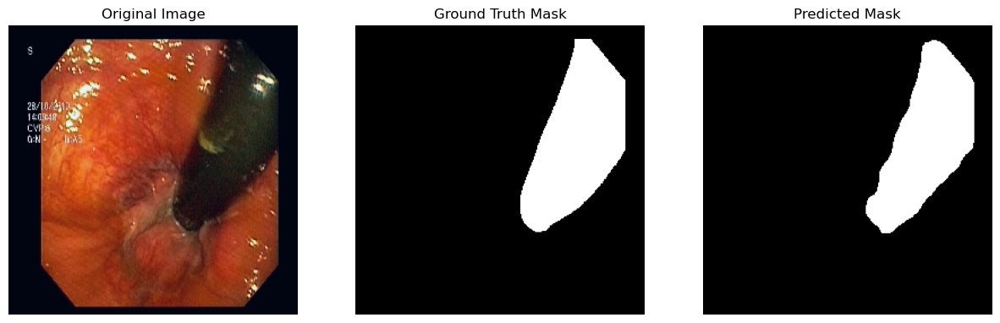

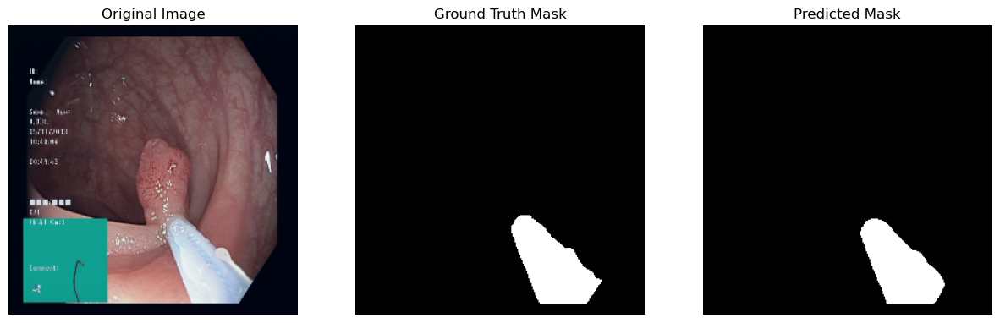

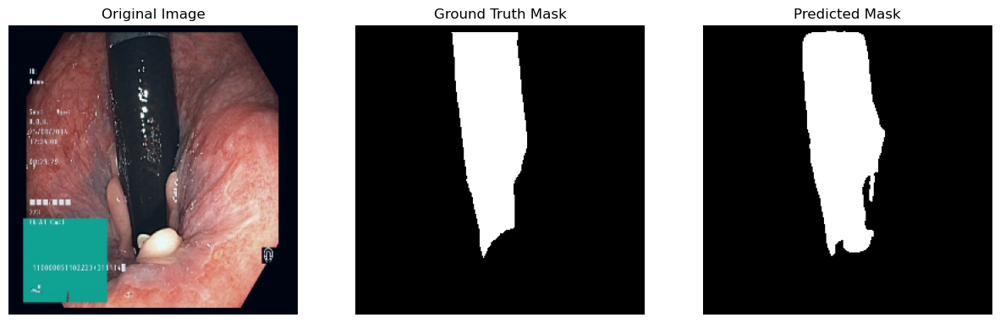

Current Learning Rate: 0.000625
EarlyStopping counter: 2 out of 5
Epoch 31/60 - Training Loss: 0.0872 - Validation Loss: 0.0656 - Training Acc: 96.68% - Validation Acc: 97.71% - Training Dice: 0.8265 - Validation Dice: 0.8752 - Training IoU: 0.7094 - Validation IoU: 0.7803 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 32/60 - Training Loss: 0.0868 - Validation Loss: 0.0614 - Training Acc: 96.64% - Validation Acc: 97.88% - Training Dice: 0.8294 - Validation Dice: 0.8820 - Training IoU: 0.7134 - Validation IoU: 0.7906 


Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 33/60 - Training Loss: 0.0831 - Validation Loss: 0.0622 - Training Acc: 96.77% - Validation Acc: 97.85% - Training Dice: 0.8347 - Validation Dice: 0.8825 - Training IoU: 0.7207 - Validation IoU: 0.7919 


Current Learning Rate: 0.000625
EarlyStopping counter: 0 out of 5
Epoch 34/60 - Training Loss: 0.0901 - Validation Loss: 0.0608 - Training Acc: 96.54% - Validation Acc: 97.91% - Training Dice: 0.8208 - Validation Dice: 0.8837 - Training IoU: 0.7016 - Validation IoU: 0.7933 


Current Learning Rate: 0.000625
EarlyStopping counter: 1 out of 5
Epoch 35/60 - Training Loss: 0.0863 - Validation Loss: 0.0618 - Training Acc: 96.68% - Validation Acc: 97.87% - Training Dice: 0.8302 - Validation Dice: 0.8824 - Training IoU: 0.7144 - Validation IoU: 0.7914 


Current Learning Rate: 0.000625
EarlyStopping counter: 2 out of 5
Epoch 36/60 - Training Loss: 0.0858 - Validation Loss: 0.0609 - Training Acc: 96.73% - Validation Acc: 97.89% - Training Dice: 0.8294 - Validation Dice: 0.8823 - Training IoU: 0.7134 - Validation IoU: 0.7910 


Current Learning Rate: 0.0003125
EarlyStopping counter: 3 out of 5
Epoch 37/60 - Training Loss: 0.0856 - Validation Loss: 0.0619 - Training Acc: 96.68% - Validation Acc: 97.88% - Training Dice: 0.8295 - Validation Dice: 0.8815 - Training IoU: 0.7144 - Validation IoU: 0.7898 


Current Learning Rate: 0.0003125
EarlyStopping counter: 4 out of 5
Epoch 38/60 - Training Loss: 0.0882 - Validation Loss: 0.0614 - Training Acc: 96.59% - Validation Acc: 97.88% - Training Dice: 0.8215 - Validation Dice: 0.8829 - Training IoU: 0.7027 - Validation IoU: 0.7925 


C:\Users\Mike\AppData\Local\Temp\ipykernel_11792\279954375.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model.load_state_dict(torch.load(os.path.join(working_di

Current Learning Rate: 0.0003125
EarlyStopping counter: 5 out of 5
Early stopping at epoch 39


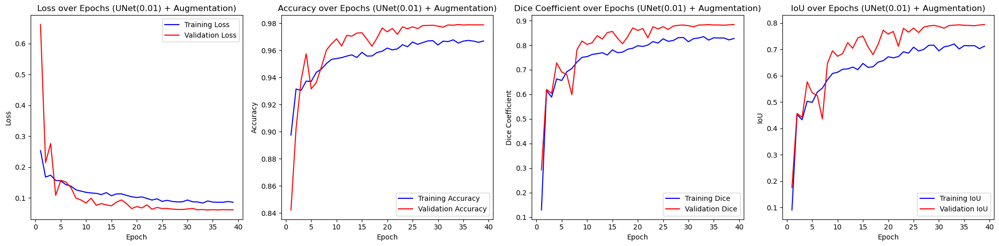

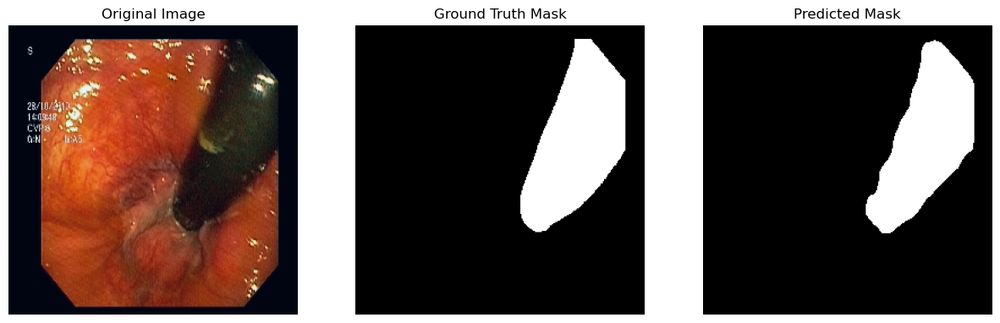

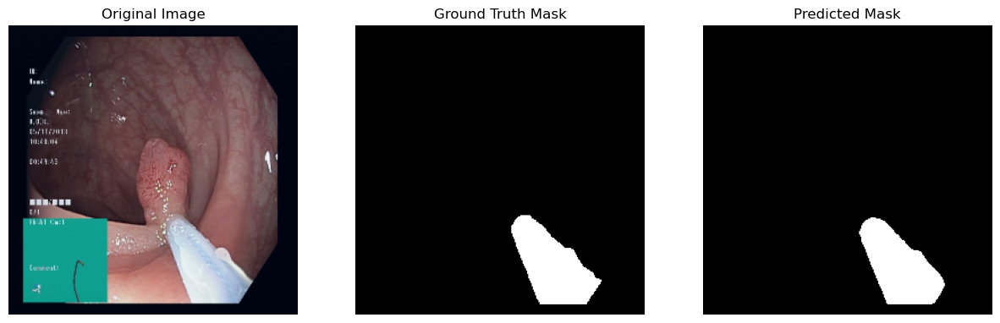

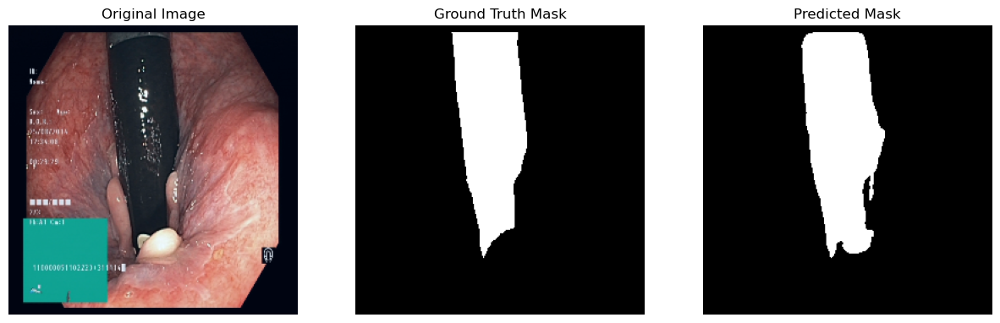


Summary of Experiments:
                         Model  Best Epoch  Train Loss  Validation Loss  \
0    FPN(0.01) +  Augmentation          59    0.041879         0.041943   
1  UNet++(0.01) + Augmentation          51    0.047286         0.037779   
2    UNet(0.01) + Augmentation          34    0.090064         0.060798   

   Train Accuracy  Validation Accuracy  Train Dice  Validation Dice  \
0        0.983996             0.985328    0.916836         0.920027   
1        0.981630             0.985524    0.902644         0.919024   
2        0.965395             0.979062    0.820812         0.883732   

   Train IoU  Validation IoU  Test Loss  Test Accuracy  Test Dice  Test IoU  
0   0.848070        0.853637   0.041943       0.985328   0.920027  0.853637  
1   0.825935        0.851916   0.037779       0.985524   0.919024  0.851916  
2   0.701626        0.793338   0.060798       0.979062   0.883732  0.793338  


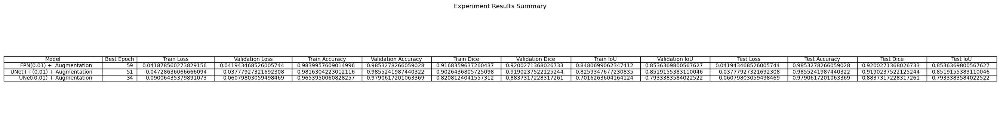

In [21]:
optimizer_adam = lambda params: optim.Adam(params, lr=0.01)

scheduler_plateau = lambda optimizer: ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)

# Run experiments and store results
results = []

# Experiment 1: UNet with Adam, Plateau scheduler, and augmentations

# Experiment 3: FPN with RMSprop, Exponential scheduler, and augmentations
_, metrics3 = run_experiment(model_fn=get_fpn,
                             optimizer_fn=optimizer_adam,
                             scheduler_fn=scheduler_plateau ,
                             augmentations=augmentations,
                             experiment_name='FPN(0.01) +  Augmentation')
results.append(metrics3)

_, metrics1 = run_experiment(model_fn=get_unetpp,
                             optimizer_fn=optimizer_adam,
                             scheduler_fn=scheduler_plateau,
                             augmentations=augmentations,
                             experiment_name='UNet++(0.01) + Augmentation')
results.append(metrics1)

# Experiment 2: UNet++ with SGD, Step scheduler, no augmentation
_, metrics2 = run_experiment(model_fn=get_unet,
                             optimizer_fn=optimizer_adam,
                             scheduler_fn=scheduler_plateau,
                             augmentations=augmentations,
                             experiment_name='UNet(0.01) + Augmentation')
results.append(metrics2)



# Create a summary table using pandas DataFrame
summary_df = pd.DataFrame(results)
print("\nSummary of Experiments:")
print(summary_df)

# Visualize the summary table using matplotlib
fig, ax = plt.subplots(figsize=(12, 4))
ax.axis('tight')
ax.axis('off')
table = ax.table(cellText=summary_df.values, colLabels=summary_df.columns, loc='center')
table.auto_set_font_size(False)
table.set_fontsize(10)
table.auto_set_column_width(col=list(range(len(summary_df.columns))))
plt.title("Experiment Results Summary")
plt.show()

C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Running experiment: FPN + Adam + Plateau +  Augmentation


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 1/60 - Training Loss: 0.2077 - Validation Loss: 0.1300 - Training Acc: 92.85% - Validation Acc: 95.21% - Training Dice: 0.5509 - Validation Dice: 0.7691 - Training IoU: 0.4205 - Validation IoU: 0.6295 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 2/60 - Training Loss: 0.1098 - Validation Loss: 0.0698 - Training Acc: 95.75% - Validation Acc: 97.42% - Training Dice: 0.7738 - Validation Dice: 0.8487 - Training IoU: 0.6391 - Validation IoU: 0.7387 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 3/60 - Training Loss: 0.0906 - Validation Loss: 0.0665 - Training Acc: 96.56% - Validation Acc: 97.53% - Training Dice: 0.8179 - Validation Dice: 0.8506 - Training IoU: 0.6978 - Validation IoU: 0.7442 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 4/60 - Training Loss: 0.0846 - Validation Loss: 0.0631 - Training Acc: 96.79% - Validation Acc: 97.58% - Training Dice: 0.8328 - Validation Dice: 0.8495 - Training IoU: 0.7176 - Validation IoU: 0.7411 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 5/60 - Training Loss: 0.0743 - Validation Loss: 0.0715 - Training Acc: 97.26% - Validation Acc: 97.22% - Training Dice: 0.8588 - Validation Dice: 0.8352 - Training IoU: 0.7564 - Validation IoU: 0.7209 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 6/60 - Training Loss: 0.0798 - Validation Loss: 0.0493 - Training Acc: 97.04% - Validation Acc: 98.28% - Training Dice: 0.8450 - Validation Dice: 0.9052 - Training IoU: 0.7384 - Validation IoU: 0.8279 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 7/60 - Training Loss: 0.0675 - Validation Loss: 0.0501 - Training Acc: 97.46% - Validation Acc: 98.26% - Training Dice: 0.8684 - Validation Dice: 0.9034 - Training IoU: 0.7711 - Validation IoU: 0.8258 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 8/60 - Training Loss: 0.0685 - Validation Loss: 0.0458 - Training Acc: 97.41% - Validation Acc: 98.44% - Training Dice: 0.8657 - Validation Dice: 0.9147 - Training IoU: 0.7695 - Validation IoU: 0.8445 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 9/60 - Training Loss: 0.0600 - Validation Loss: 0.0471 - Training Acc: 97.79% - Validation Acc: 98.31% - Training Dice: 0.8854 - Validation Dice: 0.9080 - Training IoU: 0.7987 - Validation IoU: 0.8331 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 10/60 - Training Loss: 0.0496 - Validation Loss: 0.0438 - Training Acc: 98.18% - Validation Acc: 98.45% - Training Dice: 0.9064 - Validation Dice: 0.9156 - Training IoU: 0.8311 - Validation IoU: 0.8459 


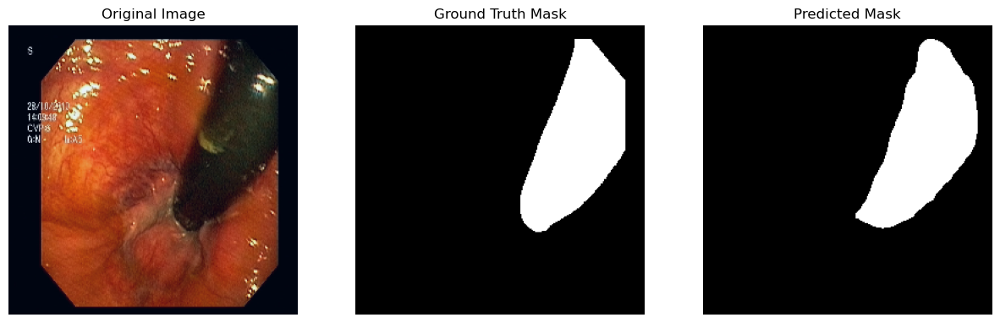

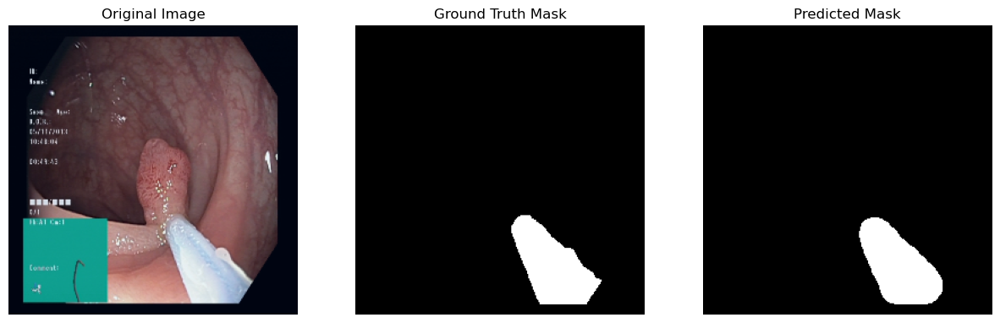

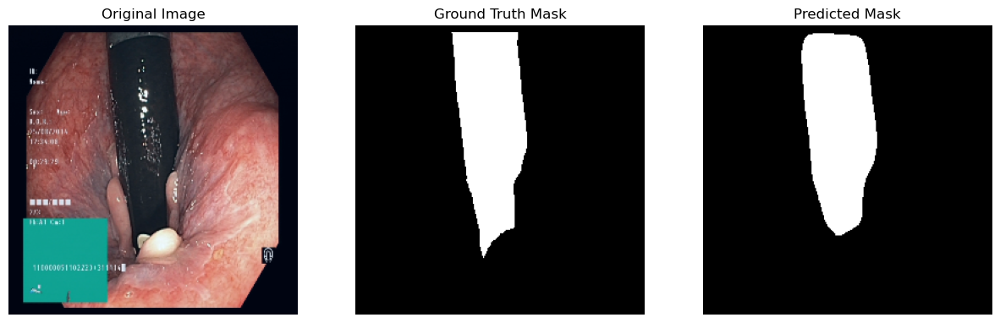

Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 11/60 - Training Loss: 0.0672 - Validation Loss: 0.0744 - Training Acc: 97.47% - Validation Acc: 97.18% - Training Dice: 0.8685 - Validation Dice: 0.8618 - Training IoU: 0.7714 - Validation IoU: 0.7610 


Current Learning Rate: 0.001
EarlyStopping counter: 2 out of 5
Epoch 12/60 - Training Loss: 0.0624 - Validation Loss: 0.0526 - Training Acc: 97.70% - Validation Acc: 98.11% - Training Dice: 0.8800 - Validation Dice: 0.9010 - Training IoU: 0.7906 - Validation IoU: 0.8223 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 13/60 - Training Loss: 0.0526 - Validation Loss: 0.0425 - Training Acc: 98.14% - Validation Acc: 98.49% - Training Dice: 0.9037 - Validation Dice: 0.9164 - Training IoU: 0.8267 - Validation IoU: 0.8480 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 14/60 - Training Loss: 0.0484 - Validation Loss: 0.0447 - Training Acc: 98.24% - Validation Acc: 98.40% - Training Dice: 0.9089 - Validation Dice: 0.9123 - Training IoU: 0.8359 - Validation IoU: 0.8400 


Current Learning Rate: 0.001
EarlyStopping counter: 2 out of 5
Epoch 15/60 - Training Loss: 0.0534 - Validation Loss: 0.0436 - Training Acc: 98.04% - Validation Acc: 98.47% - Training Dice: 0.8984 - Validation Dice: 0.9163 - Training IoU: 0.8202 - Validation IoU: 0.8474 


Current Learning Rate: 0.0005
EarlyStopping counter: 3 out of 5
Epoch 16/60 - Training Loss: 0.0487 - Validation Loss: 0.0444 - Training Acc: 98.24% - Validation Acc: 98.32% - Training Dice: 0.9085 - Validation Dice: 0.9041 - Training IoU: 0.8343 - Validation IoU: 0.8278 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 17/60 - Training Loss: 0.0444 - Validation Loss: 0.0400 - Training Acc: 98.33% - Validation Acc: 98.50% - Training Dice: 0.9140 - Validation Dice: 0.9192 - Training IoU: 0.8443 - Validation IoU: 0.8523 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 18/60 - Training Loss: 0.0374 - Validation Loss: 0.0327 - Training Acc: 98.56% - Validation Acc: 98.81% - Training Dice: 0.9268 - Validation Dice: 0.9358 - Training IoU: 0.8652 - Validation IoU: 0.8803 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 19/60 - Training Loss: 0.0383 - Validation Loss: 0.0324 - Training Acc: 98.62% - Validation Acc: 98.86% - Training Dice: 0.9286 - Validation Dice: 0.9380 - Training IoU: 0.8685 - Validation IoU: 0.8845 


Current Learning Rate: 0.0005
EarlyStopping counter: 1 out of 5
Epoch 20/60 - Training Loss: 0.0375 - Validation Loss: 0.0364 - Training Acc: 98.64% - Validation Acc: 98.76% - Training Dice: 0.9309 - Validation Dice: 0.9322 - Training IoU: 0.8723 - Validation IoU: 0.8743 


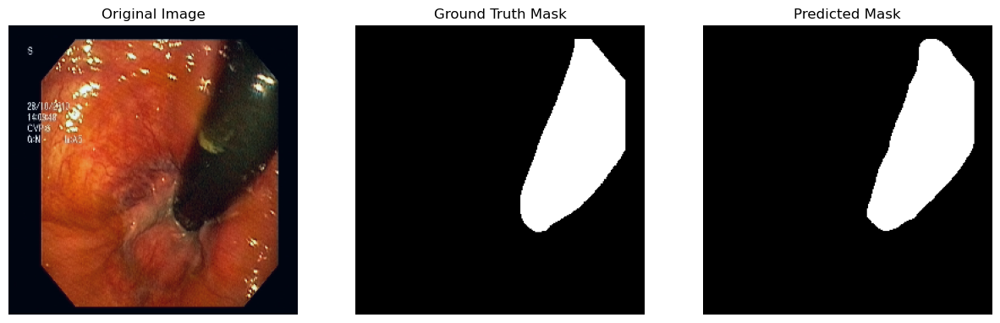

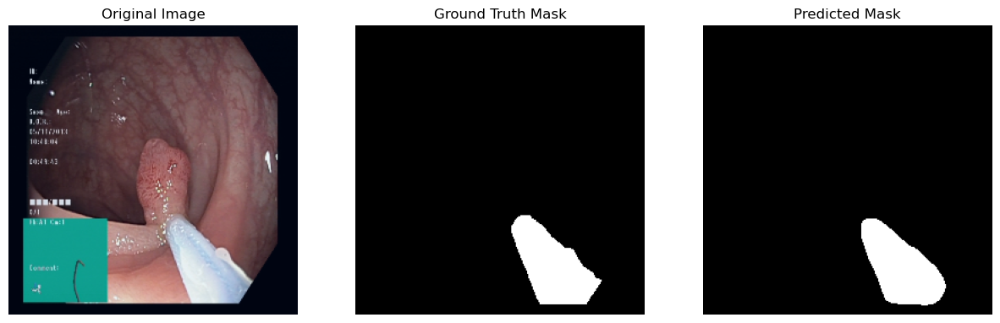

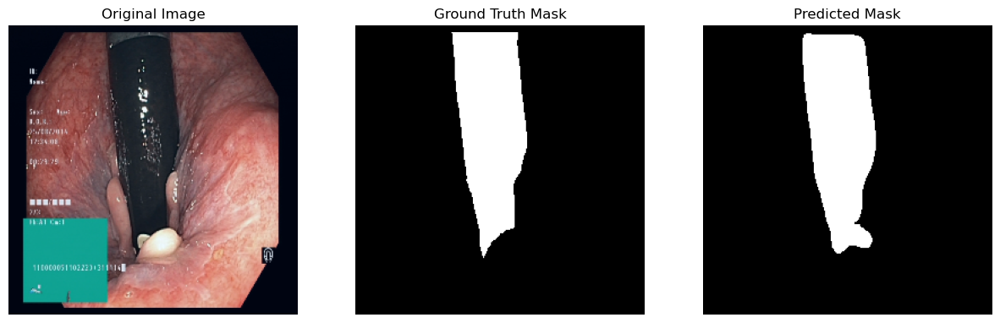

Current Learning Rate: 0.0005
EarlyStopping counter: 2 out of 5
Epoch 21/60 - Training Loss: 0.0379 - Validation Loss: 0.0395 - Training Acc: 98.56% - Validation Acc: 98.69% - Training Dice: 0.9262 - Validation Dice: 0.9252 - Training IoU: 0.8656 - Validation IoU: 0.8630 


Current Learning Rate: 0.00025
EarlyStopping counter: 3 out of 5
Epoch 22/60 - Training Loss: 0.0381 - Validation Loss: 0.0353 - Training Acc: 98.57% - Validation Acc: 98.68% - Training Dice: 0.9278 - Validation Dice: 0.9271 - Training IoU: 0.8669 - Validation IoU: 0.8660 


Current Learning Rate: 0.00025
EarlyStopping counter: 0 out of 5
Epoch 23/60 - Training Loss: 0.0317 - Validation Loss: 0.0313 - Training Acc: 98.82% - Validation Acc: 98.83% - Training Dice: 0.9394 - Validation Dice: 0.9361 - Training IoU: 0.8867 - Validation IoU: 0.8814 


Current Learning Rate: 0.00025
EarlyStopping counter: 0 out of 5
Epoch 24/60 - Training Loss: 0.0307 - Validation Loss: 0.0309 - Training Acc: 98.84% - Validation Acc: 98.86% - Training Dice: 0.9405 - Validation Dice: 0.9374 - Training IoU: 0.8889 - Validation IoU: 0.8833 


Current Learning Rate: 0.00025
EarlyStopping counter: 0 out of 5
Epoch 25/60 - Training Loss: 0.0298 - Validation Loss: 0.0302 - Training Acc: 98.90% - Validation Acc: 98.86% - Training Dice: 0.9433 - Validation Dice: 0.9372 - Training IoU: 0.8936 - Validation IoU: 0.8830 


Current Learning Rate: 0.00025
EarlyStopping counter: 1 out of 5
Epoch 26/60 - Training Loss: 0.0291 - Validation Loss: 0.0351 - Training Acc: 98.90% - Validation Acc: 98.75% - Training Dice: 0.9440 - Validation Dice: 0.9302 - Training IoU: 0.8947 - Validation IoU: 0.8712 


Current Learning Rate: 0.00025
EarlyStopping counter: 2 out of 5
Epoch 27/60 - Training Loss: 0.0301 - Validation Loss: 0.0310 - Training Acc: 98.88% - Validation Acc: 98.86% - Training Dice: 0.9409 - Validation Dice: 0.9384 - Training IoU: 0.8905 - Validation IoU: 0.8853 


Current Learning Rate: 0.000125
EarlyStopping counter: 3 out of 5
Epoch 28/60 - Training Loss: 0.0272 - Validation Loss: 0.0308 - Training Acc: 98.96% - Validation Acc: 98.85% - Training Dice: 0.9462 - Validation Dice: 0.9370 - Training IoU: 0.8987 - Validation IoU: 0.8829 


Current Learning Rate: 0.000125
EarlyStopping counter: 4 out of 5
Epoch 29/60 - Training Loss: 0.0262 - Validation Loss: 0.0304 - Training Acc: 98.99% - Validation Acc: 98.89% - Training Dice: 0.9482 - Validation Dice: 0.9392 - Training IoU: 0.9023 - Validation IoU: 0.8865 


C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\Mike\AppData\Local\Temp\ipykernel_11792\279954375.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/p

Current Learning Rate: 0.000125
EarlyStopping counter: 5 out of 5
Early stopping at epoch 30


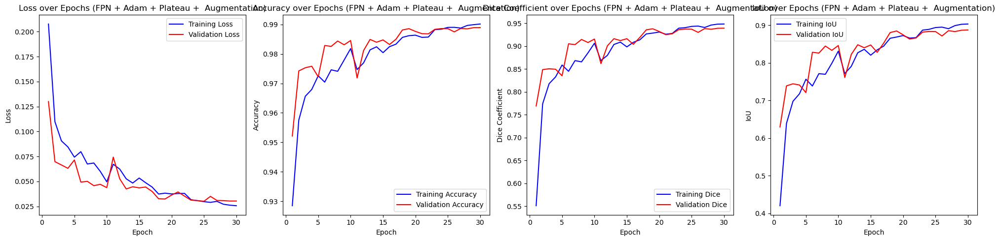

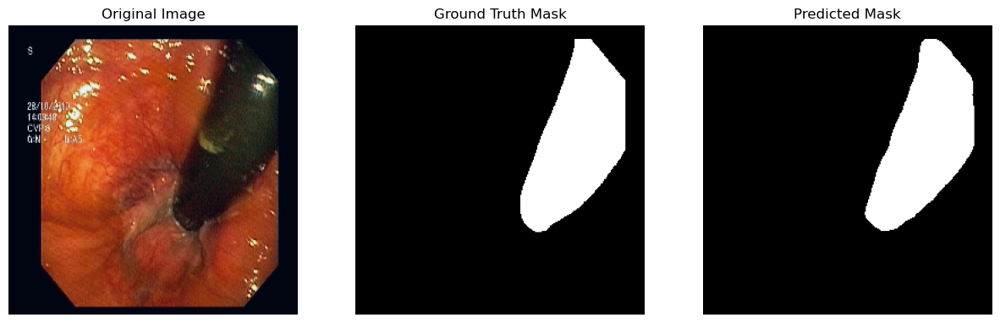

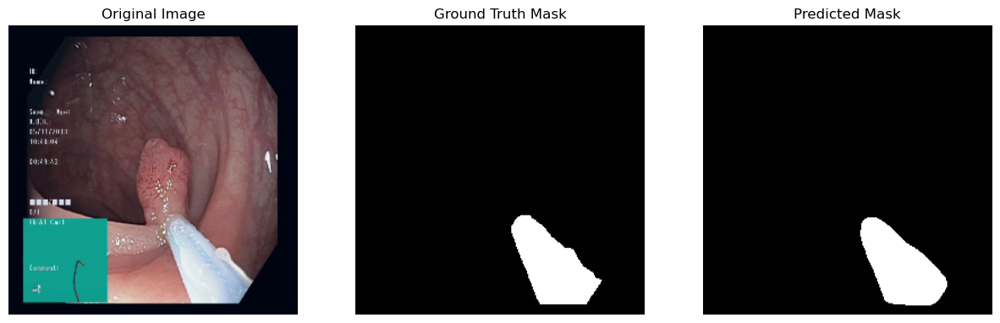

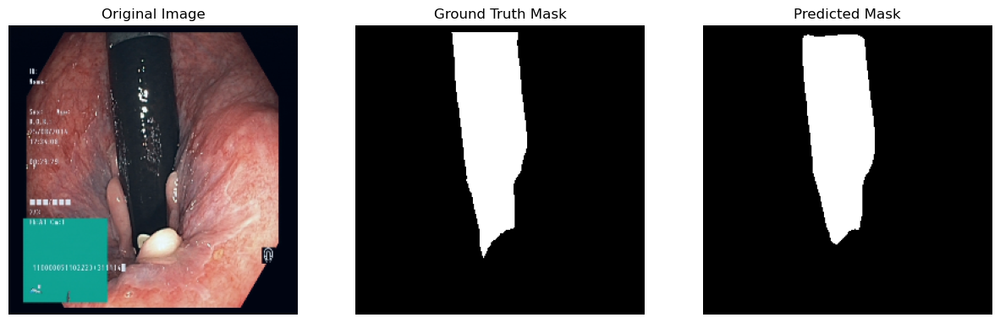

C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Running experiment: UNet++ + Adam + Plateau +  Augmentation


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 1/60 - Training Loss: 0.2038 - Validation Loss: 0.0846 - Training Acc: 92.15% - Validation Acc: 96.95% - Training Dice: 0.6091 - Validation Dice: 0.8088 - Training IoU: 0.4658 - Validation IoU: 0.6820 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 2/60 - Training Loss: 0.1110 - Validation Loss: 0.0668 - Training Acc: 95.73% - Validation Acc: 97.65% - Training Dice: 0.7783 - Validation Dice: 0.8667 - Training IoU: 0.6446 - Validation IoU: 0.7666 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 3/60 - Training Loss: 0.1032 - Validation Loss: 0.0777 - Training Acc: 96.07% - Validation Acc: 96.96% - Training Dice: 0.7975 - Validation Dice: 0.8485 - Training IoU: 0.6703 - Validation IoU: 0.7391 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 4/60 - Training Loss: 0.0866 - Validation Loss: 0.0622 - Training Acc: 96.74% - Validation Acc: 97.75% - Training Dice: 0.8340 - Validation Dice: 0.8789 - Training IoU: 0.7187 - Validation IoU: 0.7867 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 5/60 - Training Loss: 0.0839 - Validation Loss: 0.0589 - Training Acc: 96.75% - Validation Acc: 97.91% - Training Dice: 0.8310 - Validation Dice: 0.8815 - Training IoU: 0.7173 - Validation IoU: 0.7890 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 6/60 - Training Loss: 0.0778 - Validation Loss: 0.0935 - Training Acc: 97.16% - Validation Acc: 96.53% - Training Dice: 0.8531 - Validation Dice: 0.7728 - Training IoU: 0.7496 - Validation IoU: 0.6376 


Current Learning Rate: 0.001
EarlyStopping counter: 2 out of 5
Epoch 7/60 - Training Loss: 0.0731 - Validation Loss: 0.0704 - Training Acc: 97.26% - Validation Acc: 97.23% - Training Dice: 0.8575 - Validation Dice: 0.8355 - Training IoU: 0.7554 - Validation IoU: 0.7209 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 8/60 - Training Loss: 0.0630 - Validation Loss: 0.0458 - Training Acc: 97.73% - Validation Acc: 98.32% - Training Dice: 0.8819 - Validation Dice: 0.9052 - Training IoU: 0.7929 - Validation IoU: 0.8280 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 9/60 - Training Loss: 0.0722 - Validation Loss: 0.0632 - Training Acc: 97.31% - Validation Acc: 97.79% - Training Dice: 0.8623 - Validation Dice: 0.8788 - Training IoU: 0.7644 - Validation IoU: 0.7869 


Current Learning Rate: 0.001
EarlyStopping counter: 2 out of 5
Epoch 10/60 - Training Loss: 0.0674 - Validation Loss: 0.0608 - Training Acc: 97.48% - Validation Acc: 97.77% - Training Dice: 0.8696 - Validation Dice: 0.8793 - Training IoU: 0.7757 - Validation IoU: 0.7865 


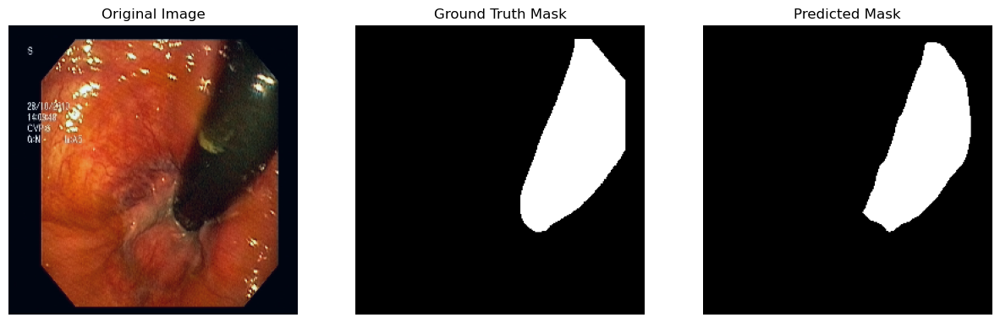

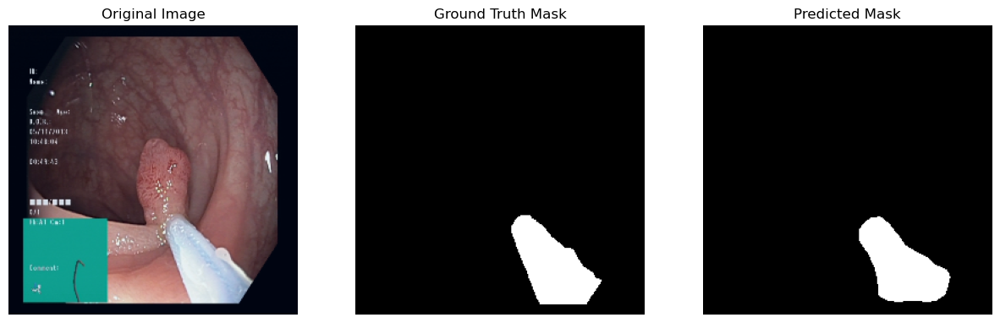

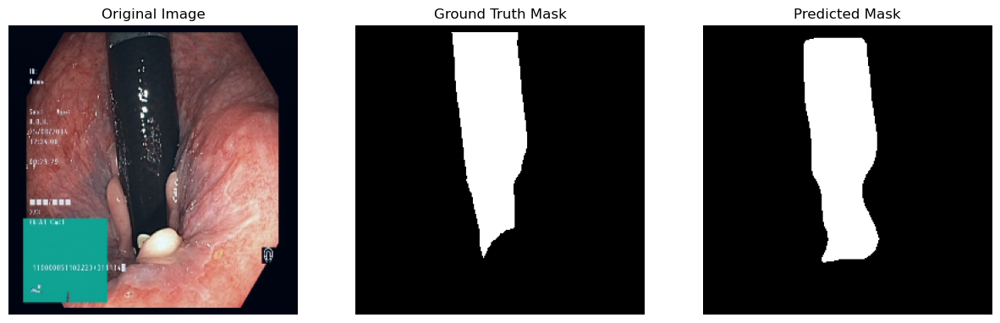

Current Learning Rate: 0.0005
EarlyStopping counter: 3 out of 5
Epoch 11/60 - Training Loss: 0.0623 - Validation Loss: 0.0658 - Training Acc: 97.70% - Validation Acc: 97.50% - Training Dice: 0.8806 - Validation Dice: 0.8754 - Training IoU: 0.7909 - Validation IoU: 0.7824 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 12/60 - Training Loss: 0.0571 - Validation Loss: 0.0429 - Training Acc: 97.87% - Validation Acc: 98.53% - Training Dice: 0.8912 - Validation Dice: 0.9160 - Training IoU: 0.8073 - Validation IoU: 0.8465 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 13/60 - Training Loss: 0.0470 - Validation Loss: 0.0398 - Training Acc: 98.29% - Validation Acc: 98.73% - Training Dice: 0.9100 - Validation Dice: 0.9302 - Training IoU: 0.8390 - Validation IoU: 0.8707 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 14/60 - Training Loss: 0.0412 - Validation Loss: 0.0384 - Training Acc: 98.48% - Validation Acc: 98.70% - Training Dice: 0.9207 - Validation Dice: 0.9269 - Training IoU: 0.8552 - Validation IoU: 0.8651 


Current Learning Rate: 0.0005
EarlyStopping counter: 1 out of 5
Epoch 15/60 - Training Loss: 0.0444 - Validation Loss: 0.0409 - Training Acc: 98.34% - Validation Acc: 98.61% - Training Dice: 0.9146 - Validation Dice: 0.9221 - Training IoU: 0.8450 - Validation IoU: 0.8567 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 16/60 - Training Loss: 0.0405 - Validation Loss: 0.0366 - Training Acc: 98.50% - Validation Acc: 98.72% - Training Dice: 0.9216 - Validation Dice: 0.9278 - Training IoU: 0.8566 - Validation IoU: 0.8667 


Current Learning Rate: 0.0005
EarlyStopping counter: 1 out of 5
Epoch 17/60 - Training Loss: 0.0469 - Validation Loss: 0.0454 - Training Acc: 98.23% - Validation Acc: 98.38% - Training Dice: 0.9096 - Validation Dice: 0.9076 - Training IoU: 0.8369 - Validation IoU: 0.8324 


Current Learning Rate: 0.0005
EarlyStopping counter: 2 out of 5
Epoch 18/60 - Training Loss: 0.0495 - Validation Loss: 0.0372 - Training Acc: 98.17% - Validation Acc: 98.64% - Training Dice: 0.9044 - Validation Dice: 0.9263 - Training IoU: 0.8283 - Validation IoU: 0.8640 


Current Learning Rate: 0.00025
EarlyStopping counter: 3 out of 5
Epoch 19/60 - Training Loss: 0.0395 - Validation Loss: 0.0400 - Training Acc: 98.51% - Validation Acc: 98.56% - Training Dice: 0.9234 - Validation Dice: 0.9215 - Training IoU: 0.8589 - Validation IoU: 0.8558 


Current Learning Rate: 0.00025
EarlyStopping counter: 0 out of 5
Epoch 20/60 - Training Loss: 0.0383 - Validation Loss: 0.0347 - Training Acc: 98.62% - Validation Acc: 98.79% - Training Dice: 0.9285 - Validation Dice: 0.9326 - Training IoU: 0.8686 - Validation IoU: 0.8749 


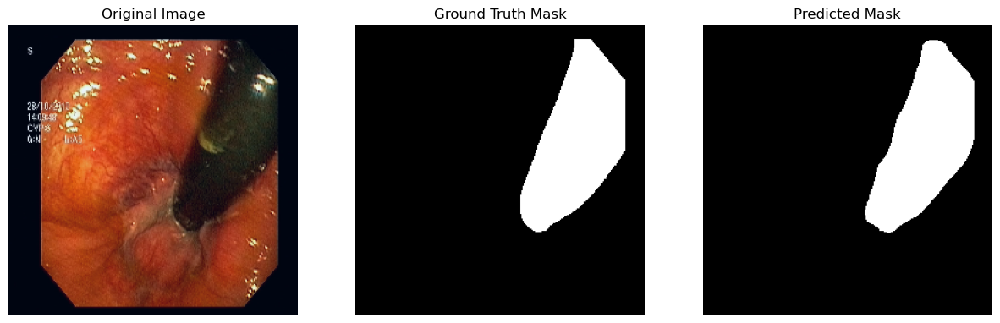

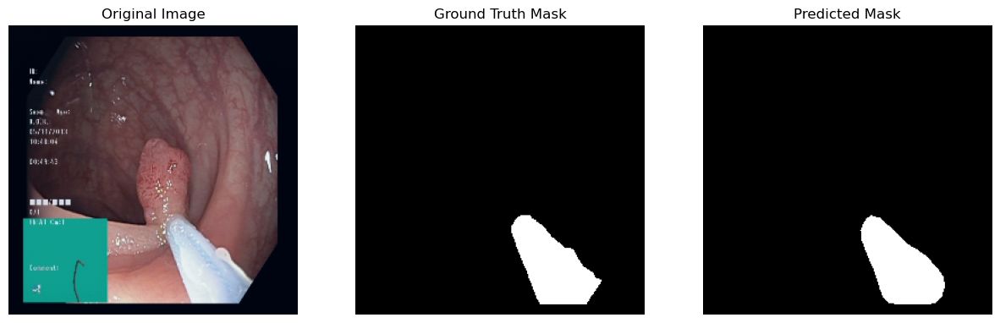

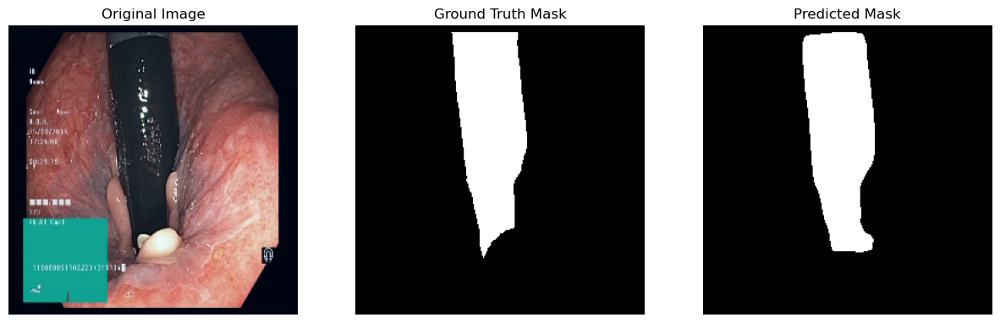

Current Learning Rate: 0.00025
EarlyStopping counter: 0 out of 5
Epoch 21/60 - Training Loss: 0.0359 - Validation Loss: 0.0340 - Training Acc: 98.68% - Validation Acc: 98.82% - Training Dice: 0.9320 - Validation Dice: 0.9351 - Training IoU: 0.8735 - Validation IoU: 0.8793 


Current Learning Rate: 0.00025
EarlyStopping counter: 1 out of 5
Epoch 22/60 - Training Loss: 0.0348 - Validation Loss: 0.0365 - Training Acc: 98.74% - Validation Acc: 98.78% - Training Dice: 0.9370 - Validation Dice: 0.9322 - Training IoU: 0.8824 - Validation IoU: 0.8741 


Current Learning Rate: 0.00025
EarlyStopping counter: 2 out of 5
Epoch 23/60 - Training Loss: 0.0372 - Validation Loss: 0.0354 - Training Acc: 98.58% - Validation Acc: 98.79% - Training Dice: 0.9267 - Validation Dice: 0.9325 - Training IoU: 0.8654 - Validation IoU: 0.8748 


Current Learning Rate: 0.00025
EarlyStopping counter: 0 out of 5
Epoch 24/60 - Training Loss: 0.0328 - Validation Loss: 0.0336 - Training Acc: 98.75% - Validation Acc: 98.83% - Training Dice: 0.9354 - Validation Dice: 0.9352 - Training IoU: 0.8799 - Validation IoU: 0.8795 


Current Learning Rate: 0.00025
EarlyStopping counter: 1 out of 5
Epoch 25/60 - Training Loss: 0.0290 - Validation Loss: 0.0344 - Training Acc: 98.92% - Validation Acc: 98.83% - Training Dice: 0.9457 - Validation Dice: 0.9356 - Training IoU: 0.8974 - Validation IoU: 0.8802 


Current Learning Rate: 0.00025
EarlyStopping counter: 2 out of 5
Epoch 26/60 - Training Loss: 0.0301 - Validation Loss: 0.0391 - Training Acc: 98.87% - Validation Acc: 98.64% - Training Dice: 0.9418 - Validation Dice: 0.9226 - Training IoU: 0.8910 - Validation IoU: 0.8581 


Current Learning Rate: 0.000125
EarlyStopping counter: 3 out of 5
Epoch 27/60 - Training Loss: 0.0333 - Validation Loss: 0.0346 - Training Acc: 98.75% - Validation Acc: 98.84% - Training Dice: 0.9363 - Validation Dice: 0.9359 - Training IoU: 0.8812 - Validation IoU: 0.8806 


Current Learning Rate: 0.000125
EarlyStopping counter: 0 out of 5
Epoch 28/60 - Training Loss: 0.0319 - Validation Loss: 0.0334 - Training Acc: 98.75% - Validation Acc: 98.86% - Training Dice: 0.9353 - Validation Dice: 0.9363 - Training IoU: 0.8799 - Validation IoU: 0.8813 


Current Learning Rate: 0.000125
EarlyStopping counter: 0 out of 5
Epoch 29/60 - Training Loss: 0.0278 - Validation Loss: 0.0313 - Training Acc: 98.96% - Validation Acc: 98.92% - Training Dice: 0.9465 - Validation Dice: 0.9402 - Training IoU: 0.8988 - Validation IoU: 0.8881 


Current Learning Rate: 0.000125
EarlyStopping counter: 1 out of 5
Epoch 30/60 - Training Loss: 0.0251 - Validation Loss: 0.0315 - Training Acc: 99.03% - Validation Acc: 98.88% - Training Dice: 0.9499 - Validation Dice: 0.9386 - Training IoU: 0.9051 - Validation IoU: 0.8853 


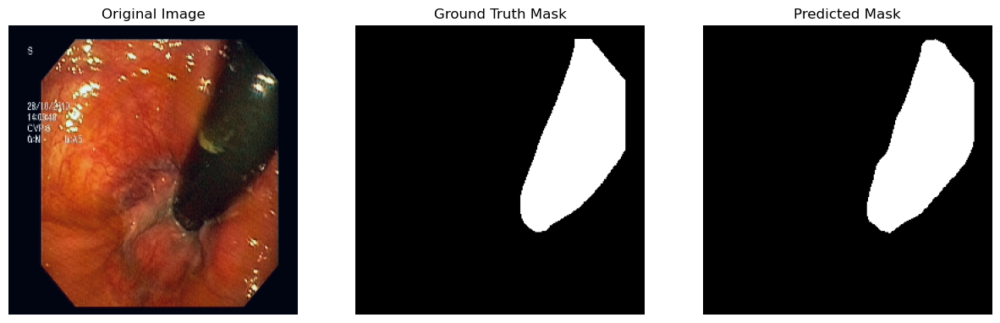

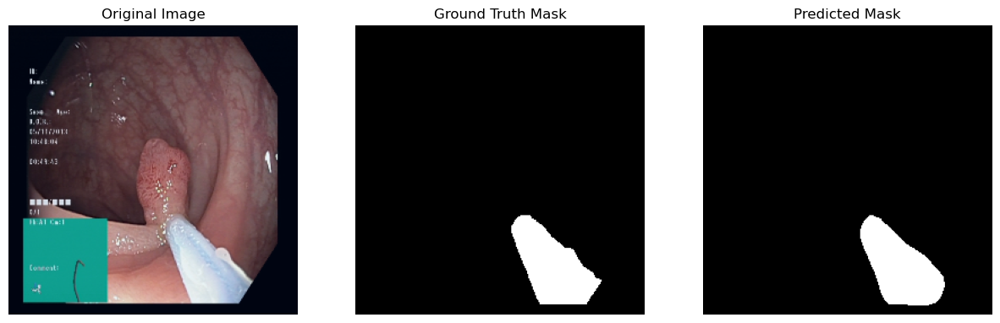

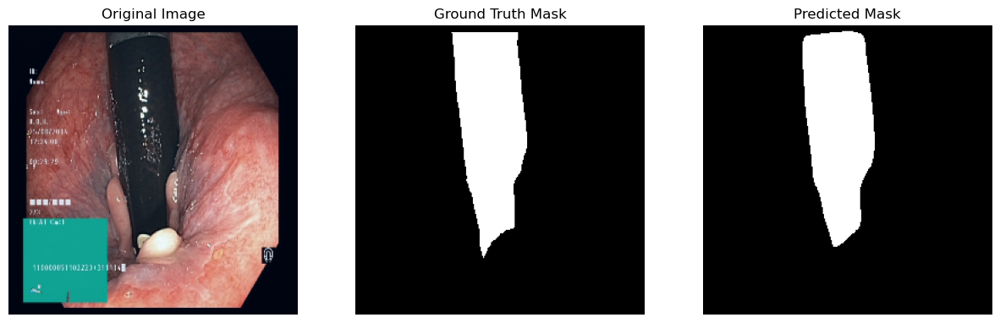

Current Learning Rate: 0.000125
EarlyStopping counter: 0 out of 5
Epoch 31/60 - Training Loss: 0.0286 - Validation Loss: 0.0309 - Training Acc: 98.91% - Validation Acc: 98.95% - Training Dice: 0.9439 - Validation Dice: 0.9423 - Training IoU: 0.8948 - Validation IoU: 0.8922 


Current Learning Rate: 0.000125
EarlyStopping counter: 1 out of 5
Epoch 32/60 - Training Loss: 0.0295 - Validation Loss: 0.0342 - Training Acc: 98.87% - Validation Acc: 98.86% - Training Dice: 0.9423 - Validation Dice: 0.9367 - Training IoU: 0.8919 - Validation IoU: 0.8823 


Current Learning Rate: 0.000125
EarlyStopping counter: 2 out of 5
Epoch 33/60 - Training Loss: 0.0266 - Validation Loss: 0.0325 - Training Acc: 98.98% - Validation Acc: 98.87% - Training Dice: 0.9473 - Validation Dice: 0.9375 - Training IoU: 0.9004 - Validation IoU: 0.8837 


Current Learning Rate: 6.25e-05
EarlyStopping counter: 3 out of 5
Epoch 34/60 - Training Loss: 0.0268 - Validation Loss: 0.0345 - Training Acc: 98.99% - Validation Acc: 98.87% - Training Dice: 0.9482 - Validation Dice: 0.9372 - Training IoU: 0.9022 - Validation IoU: 0.8833 


Current Learning Rate: 6.25e-05
EarlyStopping counter: 4 out of 5
Epoch 35/60 - Training Loss: 0.0280 - Validation Loss: 0.0334 - Training Acc: 98.91% - Validation Acc: 98.89% - Training Dice: 0.9446 - Validation Dice: 0.9389 - Training IoU: 0.8962 - Validation IoU: 0.8859 


C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Mike\anaconda3\envs\MedicalSGMN\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\Mike\AppData\Local\Temp\ipykernel_11792\279954375.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/p

Current Learning Rate: 6.25e-05
EarlyStopping counter: 5 out of 5
Early stopping at epoch 36


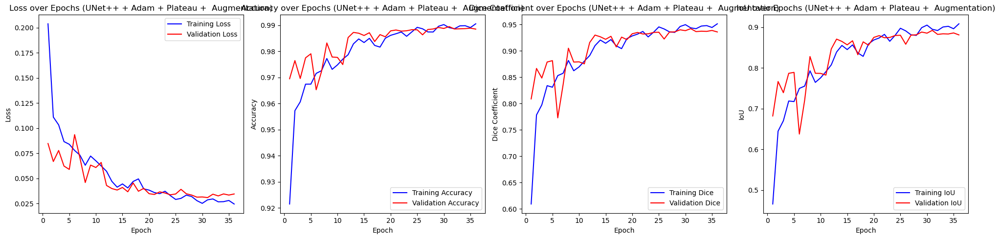

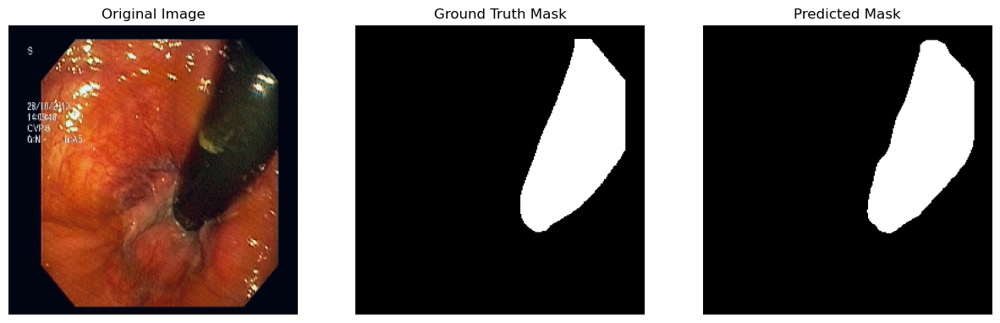

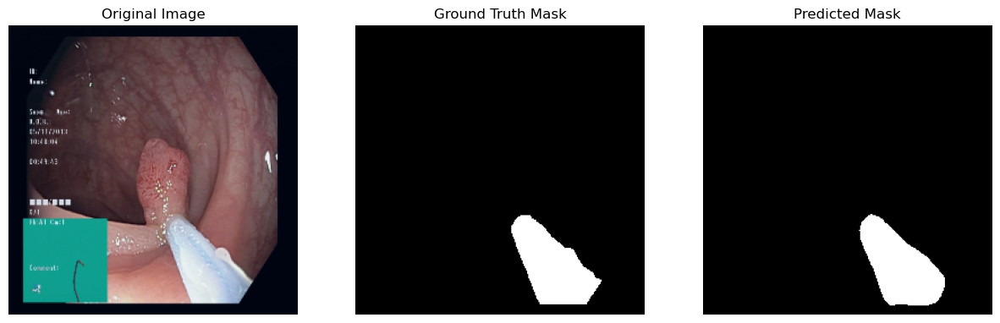

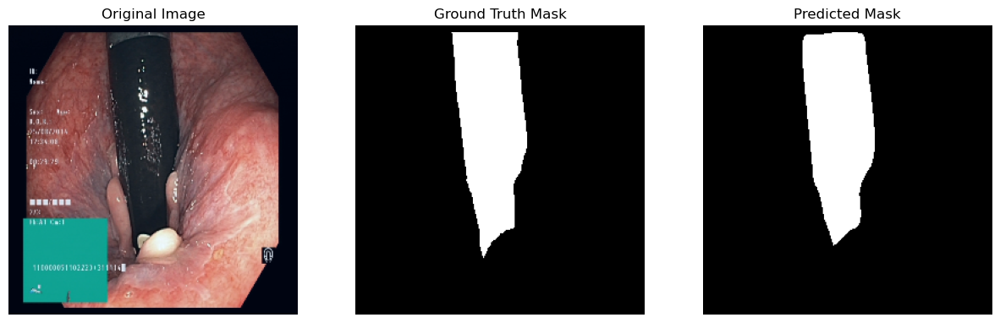


Running experiment: UNet + Adam + Plateau +  Augmentation


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 1/60 - Training Loss: 0.4529 - Validation Loss: 0.3339 - Training Acc: 85.76% - Validation Acc: 92.94% - Training Dice: 0.4667 - Validation Dice: 0.5104 - Training IoU: 0.3148 - Validation IoU: 0.3583 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 2/60 - Training Loss: 0.2779 - Validation Loss: 0.3496 - Training Acc: 92.59% - Validation Acc: 87.29% - Training Dice: 0.5817 - Validation Dice: 0.5218 - Training IoU: 0.4227 - Validation IoU: 0.3584 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 3/60 - Training Loss: 0.2010 - Validation Loss: 0.1514 - Training Acc: 93.53% - Validation Acc: 95.71% - Training Dice: 0.6698 - Validation Dice: 0.7187 - Training IoU: 0.5121 - Validation IoU: 0.5703 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 4/60 - Training Loss: 0.1619 - Validation Loss: 0.1262 - Training Acc: 94.50% - Validation Acc: 95.64% - Training Dice: 0.7104 - Validation Dice: 0.7067 - Training IoU: 0.5616 - Validation IoU: 0.5497 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 5/60 - Training Loss: 0.1501 - Validation Loss: 0.0926 - Training Acc: 94.65% - Validation Acc: 96.57% - Training Dice: 0.7110 - Validation Dice: 0.7911 - Training IoU: 0.5618 - Validation IoU: 0.6571 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 6/60 - Training Loss: 0.1331 - Validation Loss: 0.0859 - Training Acc: 95.02% - Validation Acc: 97.14% - Training Dice: 0.7440 - Validation Dice: 0.8395 - Training IoU: 0.5985 - Validation IoU: 0.7250 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 7/60 - Training Loss: 0.1209 - Validation Loss: 0.0937 - Training Acc: 95.46% - Validation Acc: 96.70% - Training Dice: 0.7615 - Validation Dice: 0.8207 - Training IoU: 0.6212 - Validation IoU: 0.7004 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 8/60 - Training Loss: 0.1190 - Validation Loss: 0.0825 - Training Acc: 95.50% - Validation Acc: 96.91% - Training Dice: 0.7612 - Validation Dice: 0.8395 - Training IoU: 0.6207 - Validation IoU: 0.7263 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 9/60 - Training Loss: 0.1234 - Validation Loss: 0.0858 - Training Acc: 95.35% - Validation Acc: 96.71% - Training Dice: 0.7576 - Validation Dice: 0.8163 - Training IoU: 0.6171 - Validation IoU: 0.6926 


Current Learning Rate: 0.001
EarlyStopping counter: 2 out of 5
Epoch 10/60 - Training Loss: 0.1148 - Validation Loss: 0.1576 - Training Acc: 95.66% - Validation Acc: 93.58% - Training Dice: 0.7697 - Validation Dice: 0.7141 - Training IoU: 0.6315 - Validation IoU: 0.5635 


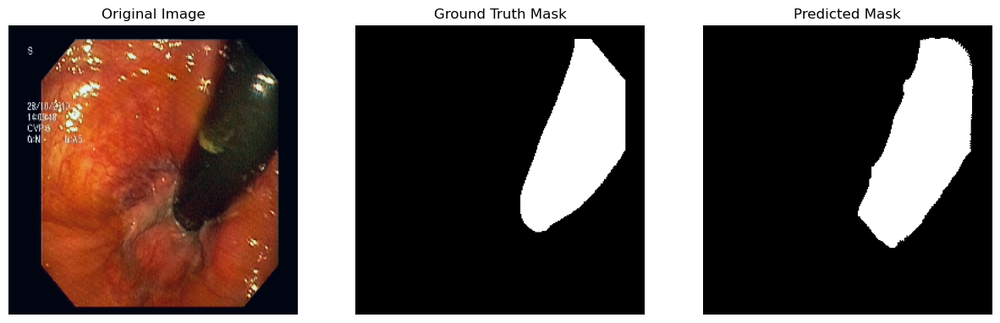

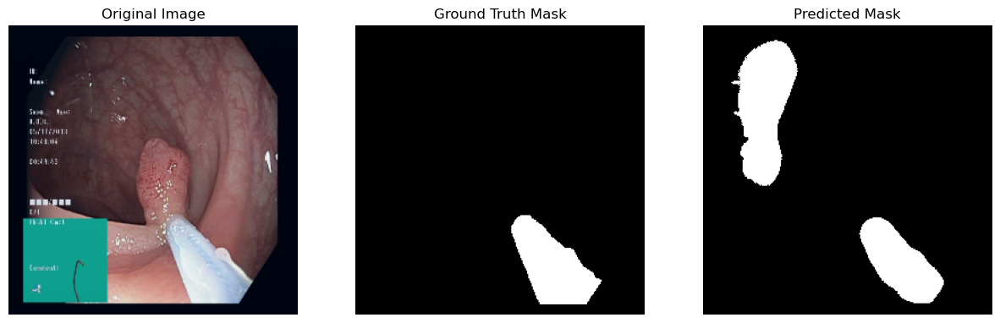

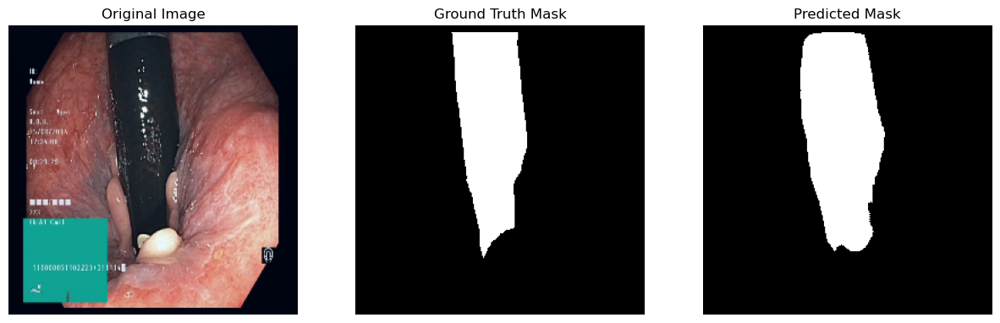

Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 11/60 - Training Loss: 0.1264 - Validation Loss: 0.0782 - Training Acc: 95.06% - Validation Acc: 97.26% - Training Dice: 0.7375 - Validation Dice: 0.8418 - Training IoU: 0.5927 - Validation IoU: 0.7289 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 12/60 - Training Loss: 0.1132 - Validation Loss: 0.0759 - Training Acc: 95.60% - Validation Acc: 97.33% - Training Dice: 0.7724 - Validation Dice: 0.8567 - Training IoU: 0.6365 - Validation IoU: 0.7517 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 13/60 - Training Loss: 0.1074 - Validation Loss: 0.0700 - Training Acc: 95.85% - Validation Acc: 97.37% - Training Dice: 0.7874 - Validation Dice: 0.8578 - Training IoU: 0.6556 - Validation IoU: 0.7532 


Current Learning Rate: 0.001
EarlyStopping counter: 0 out of 5
Epoch 14/60 - Training Loss: 0.1072 - Validation Loss: 0.0685 - Training Acc: 95.85% - Validation Acc: 97.56% - Training Dice: 0.7830 - Validation Dice: 0.8577 - Training IoU: 0.6489 - Validation IoU: 0.7531 


Current Learning Rate: 0.001
EarlyStopping counter: 1 out of 5
Epoch 15/60 - Training Loss: 0.1045 - Validation Loss: 0.0695 - Training Acc: 95.92% - Validation Acc: 97.42% - Training Dice: 0.7916 - Validation Dice: 0.8638 - Training IoU: 0.6588 - Validation IoU: 0.7632 


Current Learning Rate: 0.001
EarlyStopping counter: 2 out of 5
Epoch 16/60 - Training Loss: 0.1062 - Validation Loss: 0.1007 - Training Acc: 95.89% - Validation Acc: 96.49% - Training Dice: 0.7882 - Validation Dice: 0.7893 - Training IoU: 0.6571 - Validation IoU: 0.6571 


Current Learning Rate: 0.0005
EarlyStopping counter: 3 out of 5
Epoch 17/60 - Training Loss: 0.1011 - Validation Loss: 0.0762 - Training Acc: 96.09% - Validation Acc: 97.20% - Training Dice: 0.7984 - Validation Dice: 0.8529 - Training IoU: 0.6699 - Validation IoU: 0.7461 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 18/60 - Training Loss: 0.0983 - Validation Loss: 0.0619 - Training Acc: 96.22% - Validation Acc: 97.77% - Training Dice: 0.8022 - Validation Dice: 0.8784 - Training IoU: 0.6745 - Validation IoU: 0.7850 


Current Learning Rate: 0.0005
EarlyStopping counter: 1 out of 5
Epoch 19/60 - Training Loss: 0.0956 - Validation Loss: 0.0650 - Training Acc: 96.20% - Validation Acc: 97.66% - Training Dice: 0.8057 - Validation Dice: 0.8651 - Training IoU: 0.6808 - Validation IoU: 0.7640 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 20/60 - Training Loss: 0.0932 - Validation Loss: 0.0608 - Training Acc: 96.40% - Validation Acc: 97.80% - Training Dice: 0.8133 - Validation Dice: 0.8807 - Training IoU: 0.6895 - Validation IoU: 0.7885 


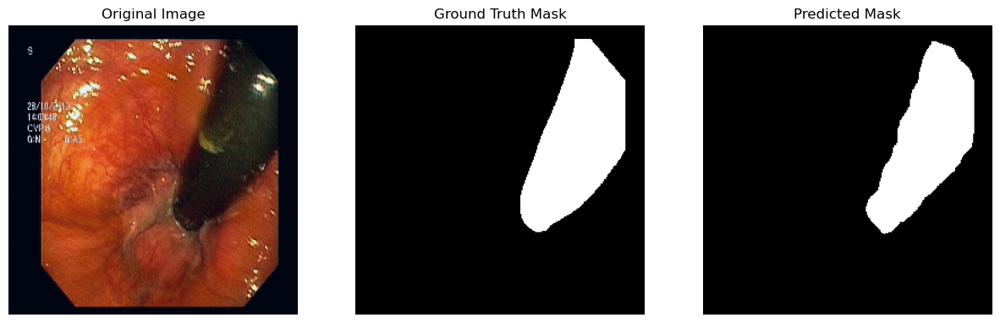

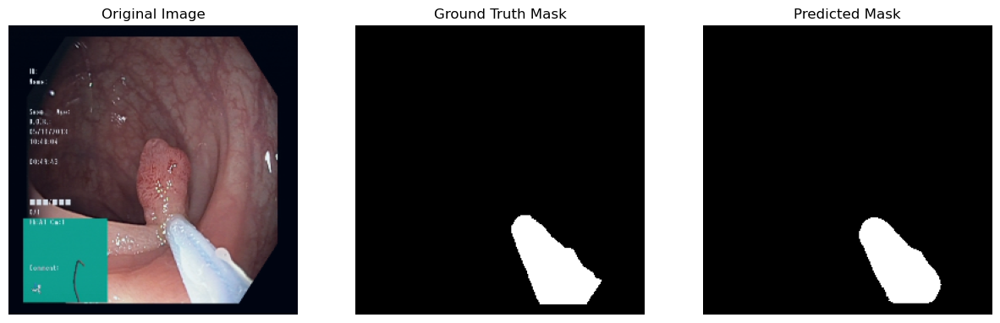

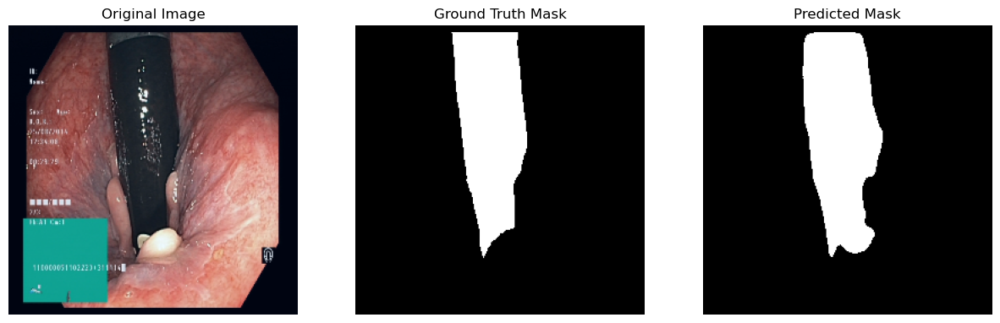

Current Learning Rate: 0.0005
EarlyStopping counter: 1 out of 5
Epoch 21/60 - Training Loss: 0.0939 - Validation Loss: 0.0618 - Training Acc: 96.40% - Validation Acc: 97.75% - Training Dice: 0.8125 - Validation Dice: 0.8773 - Training IoU: 0.6918 - Validation IoU: 0.7830 


Current Learning Rate: 0.0005
EarlyStopping counter: 2 out of 5
Epoch 22/60 - Training Loss: 0.0923 - Validation Loss: 0.0612 - Training Acc: 96.42% - Validation Acc: 97.83% - Training Dice: 0.8175 - Validation Dice: 0.8786 - Training IoU: 0.6965 - Validation IoU: 0.7848 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 23/60 - Training Loss: 0.0959 - Validation Loss: 0.0578 - Training Acc: 96.33% - Validation Acc: 97.85% - Training Dice: 0.8078 - Validation Dice: 0.8812 - Training IoU: 0.6853 - Validation IoU: 0.7891 


Current Learning Rate: 0.0005
EarlyStopping counter: 1 out of 5
Epoch 24/60 - Training Loss: 0.0888 - Validation Loss: 0.0616 - Training Acc: 96.58% - Validation Acc: 97.82% - Training Dice: 0.8234 - Validation Dice: 0.8766 - Training IoU: 0.7043 - Validation IoU: 0.7817 


Current Learning Rate: 0.0005
EarlyStopping counter: 2 out of 5
Epoch 25/60 - Training Loss: 0.0906 - Validation Loss: 0.0631 - Training Acc: 96.44% - Validation Acc: 97.65% - Training Dice: 0.8149 - Validation Dice: 0.8689 - Training IoU: 0.6933 - Validation IoU: 0.7695 


Current Learning Rate: 0.0005
EarlyStopping counter: 0 out of 5
Epoch 26/60 - Training Loss: 0.0883 - Validation Loss: 0.0566 - Training Acc: 96.59% - Validation Acc: 97.97% - Training Dice: 0.8246 - Validation Dice: 0.8876 - Training IoU: 0.7084 - Validation IoU: 0.7995 


Current Learning Rate: 0.0005
EarlyStopping counter: 1 out of 5
Epoch 27/60 - Training Loss: 0.0889 - Validation Loss: 0.0590 - Training Acc: 96.49% - Validation Acc: 97.88% - Training Dice: 0.8171 - Validation Dice: 0.8837 - Training IoU: 0.6974 - Validation IoU: 0.7933 


Current Learning Rate: 0.0005
EarlyStopping counter: 2 out of 5
Epoch 28/60 - Training Loss: 0.0891 - Validation Loss: 0.0643 - Training Acc: 96.57% - Validation Acc: 97.65% - Training Dice: 0.8243 - Validation Dice: 0.8753 - Training IoU: 0.7056 - Validation IoU: 0.7809 


Current Learning Rate: 0.00025
EarlyStopping counter: 3 out of 5
Epoch 29/60 - Training Loss: 0.0870 - Validation Loss: 0.0572 - Training Acc: 96.70% - Validation Acc: 97.98% - Training Dice: 0.8260 - Validation Dice: 0.8869 - Training IoU: 0.7104 - Validation IoU: 0.7985 


Current Learning Rate: 0.00025
EarlyStopping counter: 4 out of 5
Epoch 30/60 - Training Loss: 0.0849 - Validation Loss: 0.0665 - Training Acc: 96.74% - Validation Acc: 97.57% - Training Dice: 0.8323 - Validation Dice: 0.8733 - Training IoU: 0.7180 - Validation IoU: 0.7779 


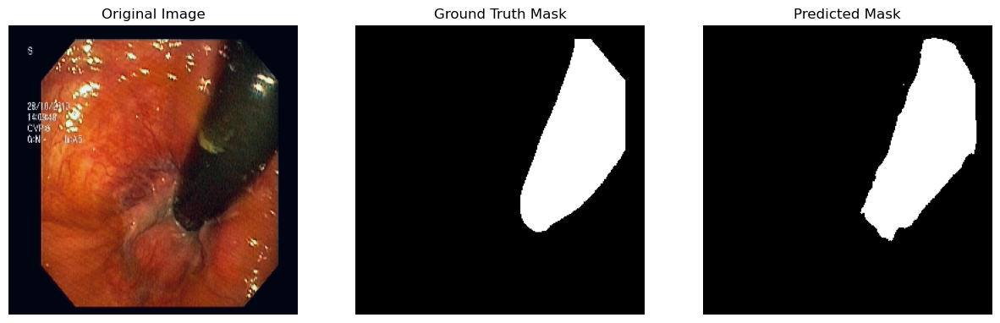

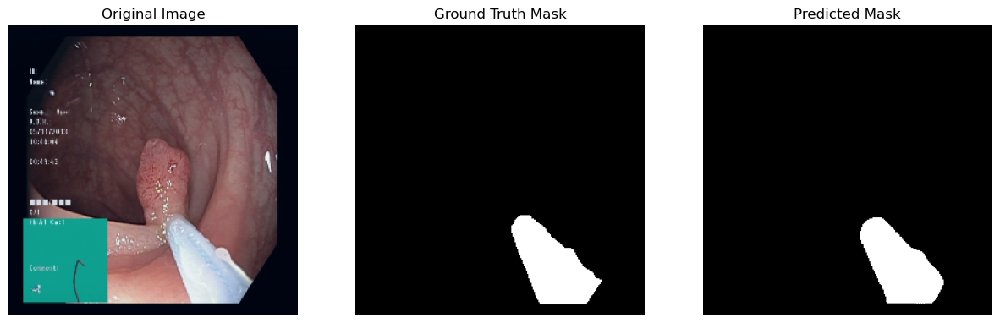

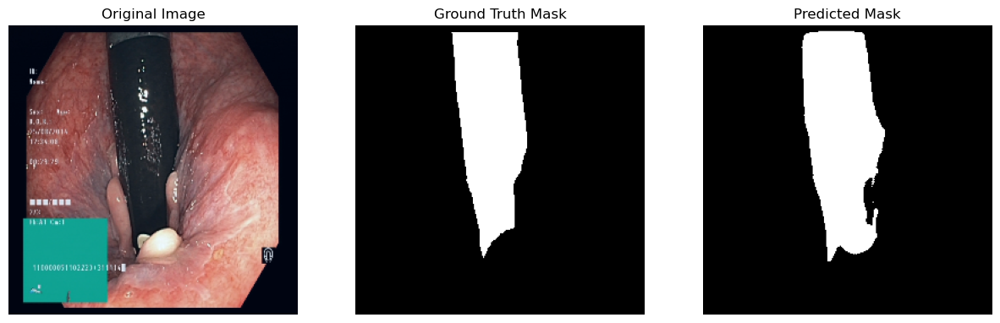

Current Learning Rate: 0.00025
EarlyStopping counter: 0 out of 5
Epoch 31/60 - Training Loss: 0.0836 - Validation Loss: 0.0533 - Training Acc: 96.79% - Validation Acc: 98.12% - Training Dice: 0.8317 - Validation Dice: 0.8977 - Training IoU: 0.7168 - Validation IoU: 0.8159 


Current Learning Rate: 0.00025
EarlyStopping counter: 1 out of 5
Epoch 32/60 - Training Loss: 0.0820 - Validation Loss: 0.0576 - Training Acc: 96.85% - Validation Acc: 97.92% - Training Dice: 0.8397 - Validation Dice: 0.8871 - Training IoU: 0.7293 - Validation IoU: 0.7992 


Current Learning Rate: 0.00025
EarlyStopping counter: 2 out of 5
Epoch 33/60 - Training Loss: 0.0842 - Validation Loss: 0.0560 - Training Acc: 96.68% - Validation Acc: 98.00% - Training Dice: 0.8283 - Validation Dice: 0.8878 - Training IoU: 0.7127 - Validation IoU: 0.7997 


Current Learning Rate: 0.000125
EarlyStopping counter: 3 out of 5
Epoch 34/60 - Training Loss: 0.0801 - Validation Loss: 0.0604 - Training Acc: 96.91% - Validation Acc: 97.77% - Training Dice: 0.8396 - Validation Dice: 0.8706 - Training IoU: 0.7282 - Validation IoU: 0.7727 


Current Learning Rate: 0.000125
EarlyStopping counter: 0 out of 5
Epoch 35/60 - Training Loss: 0.0778 - Validation Loss: 0.0533 - Training Acc: 97.02% - Validation Acc: 98.08% - Training Dice: 0.8494 - Validation Dice: 0.8936 - Training IoU: 0.7428 - Validation IoU: 0.8092 


Current Learning Rate: 0.000125
EarlyStopping counter: 1 out of 5
Epoch 36/60 - Training Loss: 0.0772 - Validation Loss: 0.0547 - Training Acc: 97.01% - Validation Acc: 97.96% - Training Dice: 0.8486 - Validation Dice: 0.8877 - Training IoU: 0.7417 - Validation IoU: 0.7999 


Current Learning Rate: 0.000125
EarlyStopping counter: 0 out of 5
Epoch 37/60 - Training Loss: 0.0800 - Validation Loss: 0.0504 - Training Acc: 96.90% - Validation Acc: 98.19% - Training Dice: 0.8385 - Validation Dice: 0.8994 - Training IoU: 0.7285 - Validation IoU: 0.8189 


Current Learning Rate: 0.000125
EarlyStopping counter: 1 out of 5
Epoch 38/60 - Training Loss: 0.0798 - Validation Loss: 0.0538 - Training Acc: 96.93% - Validation Acc: 98.10% - Training Dice: 0.8413 - Validation Dice: 0.8956 - Training IoU: 0.7310 - Validation IoU: 0.8127 


Current Learning Rate: 0.000125
EarlyStopping counter: 2 out of 5
Epoch 39/60 - Training Loss: 0.0784 - Validation Loss: 0.0565 - Training Acc: 96.99% - Validation Acc: 97.92% - Training Dice: 0.8446 - Validation Dice: 0.8873 - Training IoU: 0.7361 - Validation IoU: 0.7998 


Current Learning Rate: 6.25e-05
EarlyStopping counter: 3 out of 5
Epoch 40/60 - Training Loss: 0.0766 - Validation Loss: 0.0518 - Training Acc: 97.05% - Validation Acc: 98.16% - Training Dice: 0.8491 - Validation Dice: 0.8967 - Training IoU: 0.7424 - Validation IoU: 0.8144 


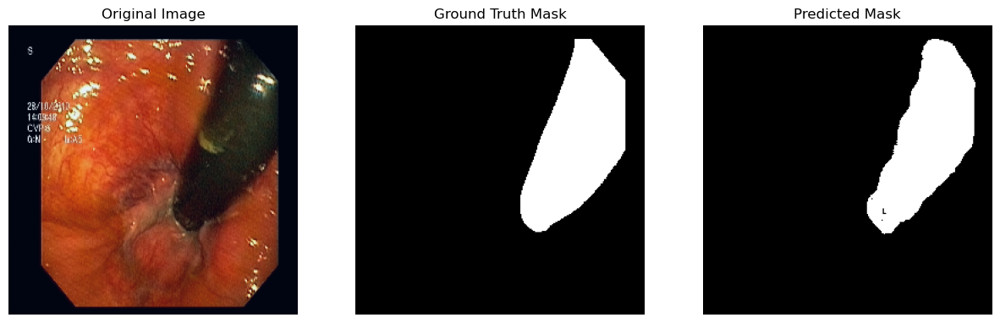

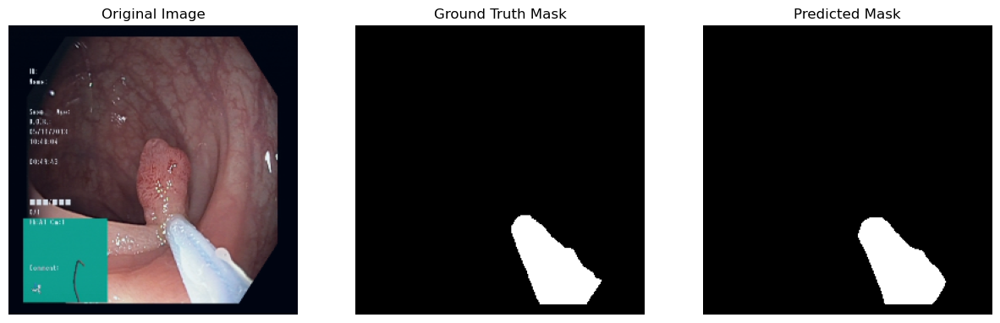

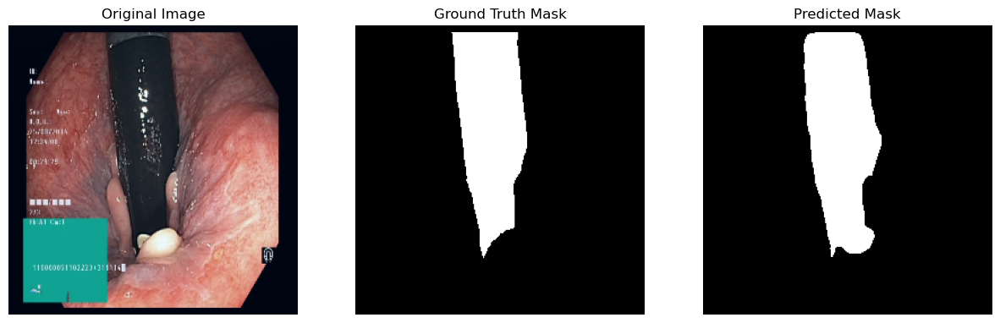

Current Learning Rate: 6.25e-05
EarlyStopping counter: 4 out of 5
Epoch 41/60 - Training Loss: 0.0756 - Validation Loss: 0.0523 - Training Acc: 97.09% - Validation Acc: 98.13% - Training Dice: 0.8520 - Validation Dice: 0.8965 - Training IoU: 0.7455 - Validation IoU: 0.8142 


C:\Users\Mike\AppData\Local\Temp\ipykernel_11792\279954375.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model.load_state_dict(torch.load(os.path.join(working_di

Current Learning Rate: 6.25e-05
EarlyStopping counter: 5 out of 5
Early stopping at epoch 42


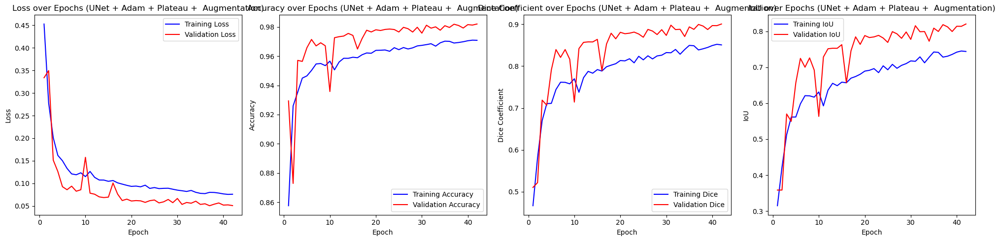

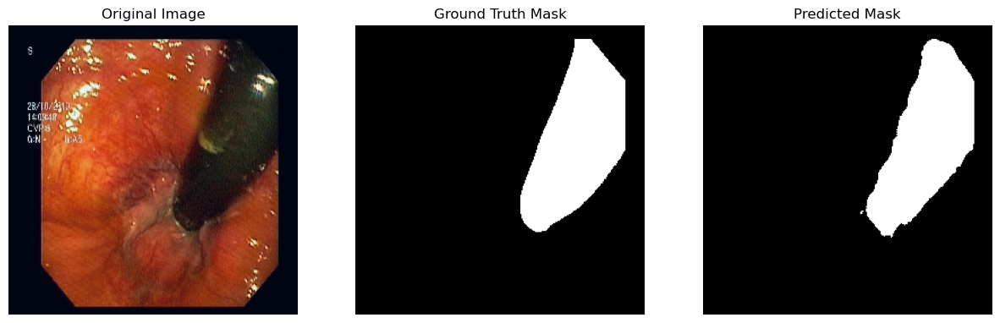

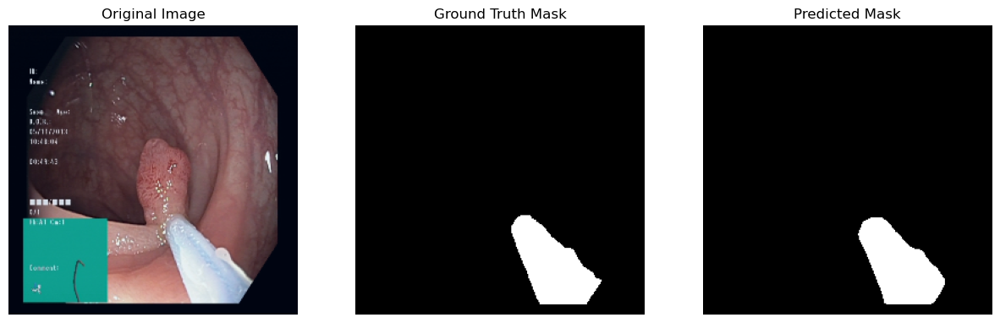

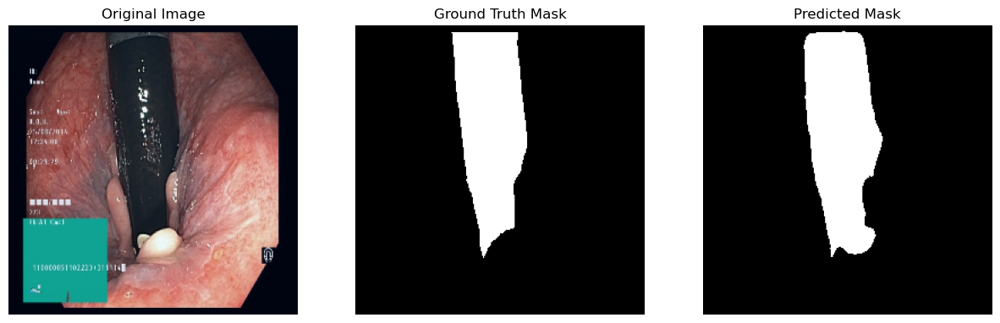


Summary of Experiments:
                                     Model  Best Epoch  Train Loss  \
0     FPN + Adam + Plateau +  Augmentation          25    0.029768   
1  UNet++ + Adam + Plateau +  Augmentation          31    0.028620   
2    UNet + Adam + Plateau +  Augmentation          37    0.080022   

   Validation Loss  Train Accuracy  Validation Accuracy  Train Dice  \
0         0.030163        0.988987             0.988568    0.943302   
1         0.030852        0.989107             0.989509    0.943888   
2         0.050424        0.968974             0.981851    0.838549   

   Validation Dice  Train IoU  Validation IoU  Test Loss  Test Accuracy  \
0         0.937200   0.893584        0.883019   0.030163       0.988568   
1         0.942326   0.894811        0.892157   0.030852       0.989509   
2         0.899390   0.728528        0.818920   0.050424       0.981851   

   Test Dice  Test IoU  
0   0.937200  0.883019  
1   0.942326  0.892157  
2   0.899390  0.818920  


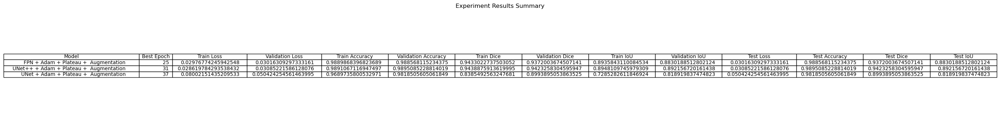

In [20]:
optimizer_adam = lambda params: optim.Adam(params, lr=1e-3)

scheduler_plateau = lambda optimizer: ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)

# Run experiments and store results
results = []

# Experiment 1: UNet with Adam, Plateau scheduler, and augmentations

# Experiment 3: FPN with RMSprop, Exponential scheduler, and augmentations
_, metrics3 = run_experiment(model_fn=get_fpn,
                             optimizer_fn=optimizer_adam,
                             scheduler_fn=scheduler_plateau ,
                             augmentations=augmentations,
                             experiment_name='FPN +  Augmentation')
results.append(metrics3)

_, metrics1 = run_experiment(model_fn=get_unetpp,
                             optimizer_fn=optimizer_adam,
                             scheduler_fn=scheduler_plateau,
                             augmentations=augmentations,
                             experiment_name='UNet++ + Augmentation')
results.append(metrics1)

# Experiment 2: UNet++ with SGD, Step scheduler, no augmentation
_, metrics2 = run_experiment(model_fn=get_unet,
                             optimizer_fn=optimizer_adam,
                             scheduler_fn=scheduler_plateau,
                             augmentations=augmentations,
                             experiment_name='UNet +  Augmentation')
results.append(metrics2)



# Create a summary table using pandas DataFrame
summary_df = pd.DataFrame(results)
print("\nSummary of Experiments:")
print(summary_df)

# Visualize the summary table using matplotlib
fig, ax = plt.subplots(figsize=(12, 4))
ax.axis('tight')
ax.axis('off')
table = ax.table(cellText=summary_df.values, colLabels=summary_df.columns, loc='center')
table.auto_set_font_size(False)
table.set_fontsize(10)
table.auto_set_column_width(col=list(range(len(summary_df.columns))))
plt.title("Experiment Results Summary")
plt.show()